In [1]:
%pip install loguru
%pip install sklearn

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.
You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.
Note: you may need to restart the kernel to use updated packages.


In [2]:
import os 
import numpy as np
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from copy import deepcopy
from scipy.spatial.distance import pdist
import itertools as it 
os.chdir('..')
from src.data_cleaning import *
from src.autograd_mds import *
from autograd import grad, elementwise_grad 
from loguru import logger
import sys

In [3]:
url = 'http://cs.bc.edu/~prudhome/AAPLD/animal-similarity.csv'

raw_dataset = pd.read_csv(url, index_col=0)
list_of_animal_pairs = raw_dataset.index.str.split('~')

In [4]:
dissimilarity_weights = [np.exp(-1*x) for x in raw_dataset['Average_Rating']]


In [5]:
weighted_list_of_animal_pairs = [x+ [dissimilarity_weights[_]] for _, x in enumerate(list_of_animal_pairs)]

In [6]:
animal_pair_data = pd.DataFrame.from_records(list_of_animal_pairs, columns=['first_animal', 'second_animal'], index= raw_dataset.index)

In [7]:
animal_pair_data.sort_values(by = ['first_animal', 'second_animal'], inplace=True)

In [8]:
unique_animals = set(animal_pair_data.first_animal).union(animal_pair_data.second_animal)

In [9]:
animal_pairs = nx.Graph()
animal_pairs.add_nodes_from(unique_animals)
animal_pairs.add_weighted_edges_from(weighted_list_of_animal_pairs)

In [10]:
low_degree=[k for k,v in animal_pairs.degree._nodes.items() if len(v) < 32]

In [11]:
animal_pairs.remove_nodes_from(low_degree)

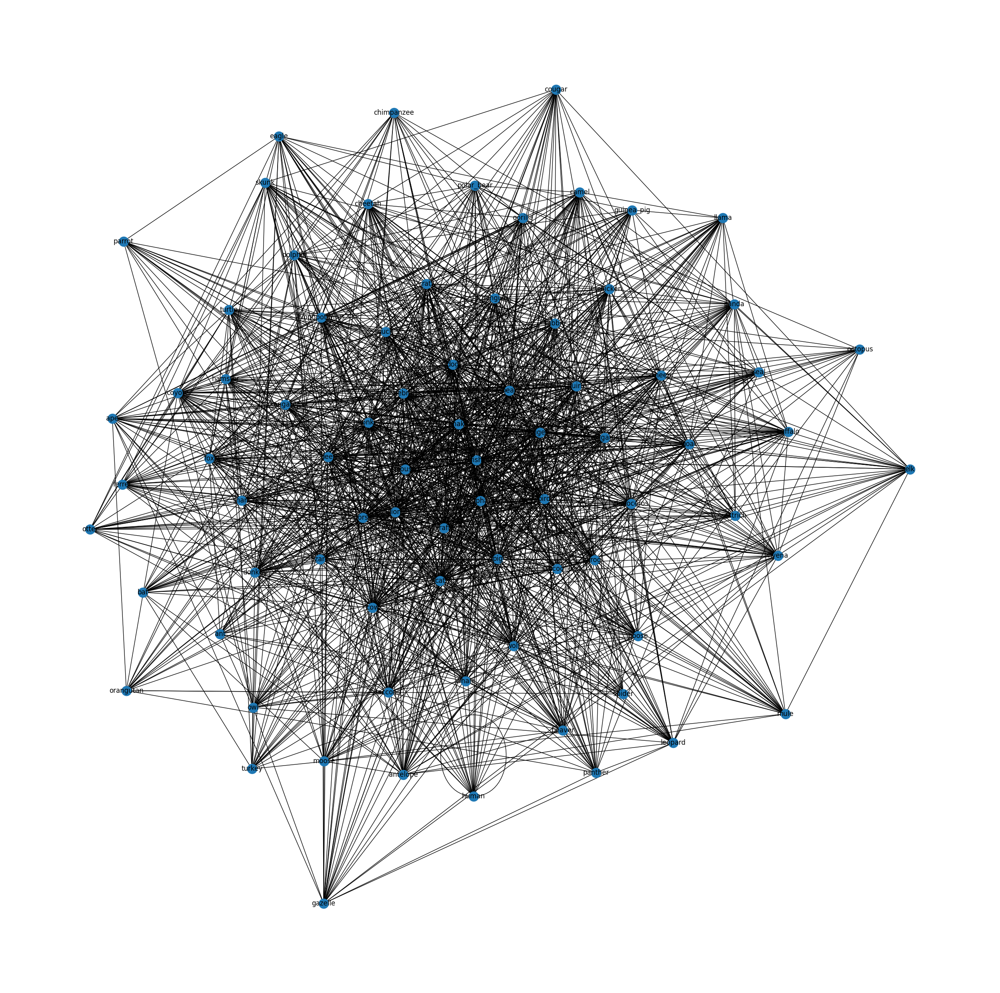

In [12]:
fig, ax = plt.subplots(figsize=(32,32))
nx.draw(animal_pairs, with_labels=True, ax=ax)

plt.show()

In [13]:
connected_list = [x for x in animal_pairs.nodes]

In [14]:
# try the small list, or, failing that, just the apes

In [15]:
smaller_animal_pair_data=animal_pair_data.loc[animal_pair_data['first_animal' ].isin( connected_list) & animal_pair_data['second_animal' ].isin( connected_list) ] 

In [16]:
joined_data=smaller_animal_pair_data.join(raw_dataset).drop(columns='[All_Ratings]')

In [17]:
big_matrix = pd.DataFrame(index=connected_list, columns = connected_list)

In [18]:
joined_data

,first_animal,second_animal,Average_Rating
Pair,,,
alligator~antelope,alligator,antelope,1.940
alligator~bird,alligator,bird,2.080
alligator~buffalo,alligator,buffalo,1.080
alligator~elephant,alligator,elephant,1.140
alligator~fish,alligator,fish,1.000
...,...,...,...
zebra~seal,zebra,seal,1.040
zebra~shark,zebra,shark,1.067
zebra~snake,zebra,snake,1.880


In [19]:
#TODO wrap below section into functions

In [20]:
for row in joined_data.iterrows():
    big_matrix.loc[row[1].first_animal][row[1].second_animal] = row[1].Average_Rating
    big_matrix.loc[row[1].second_animal][row[1].first_animal] = row[1].Average_Rating

In [21]:
big_matrix = big_matrix.astype(float)

In [22]:
# big_matrix = big_matrix[big_matrix.isna().mean(1) < 0.5]
# big_matrix = big_matrix[big_matrix.index.to_list()]

In [23]:
big_matrix = big_matrix[big_matrix.isna().mean(1) < 0.33]

In [24]:
big_matrix = big_matrix[big_matrix.index.to_list()]

In [25]:
plt.matshow(big_matrix)

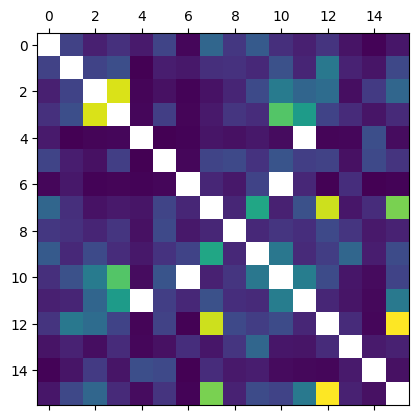

In [26]:
plt.show()

In [27]:
big_matrix.isna().mean(1)

pig         0.0625
giraffe     0.0625
zebra       0.0625
horse       0.0625
fish        0.1250
bear        0.0625
bird        0.1250
cat         0.0625
elephant    0.0625
dog         0.0625
deer        0.1250
cow         0.1250
lion        0.0625
monkey      0.0625
snake       0.0625
tiger       0.0625
dtype: float64

In [28]:
big_matrix.shape

(16, 16)

In [29]:
big_matrix

,pig,giraffe,zebra,horse,fish,bear,bird,cat,elephant,dog,deer,cow,lion,monkey,snake,tiger
pig,NaN,2.020,1.460,1.720,1.370,2.080,1.10,2.717,1.840,2.480,1.70,1.460,1.780,1.28,1.06,1.320
giraffe,2.020,NaN,2.040,2.250,1.020,1.425,1.34,1.700,1.740,1.600,2.30,1.540,3.100,1.50,1.30,2.125
zebra,1.460,2.040,NaN,5.917,1.080,1.240,1.06,1.260,1.550,2.175,3.18,2.700,2.840,1.20,1.88,2.720
horse,1.720,2.250,5.917,NaN,1.100,1.960,1.08,1.360,1.800,1.660,4.82,3.860,2.040,1.64,1.30,1.620
fish,1.370,1.020,1.080,1.100,NaN,1.000,1.06,1.300,1.240,1.340,1.18,NaN,1.067,1.10,2.26,1.180
bear,2.080,1.425,1.240,1.960,1.000,NaN,1.10,2.080,2.160,1.760,2.36,1.960,2.020,1.24,2.16,1.780
bird,1.100,1.340,1.060,1.080,1.060,1.100,NaN,1.560,1.340,2.050,NaN,1.580,1.040,1.68,1.00,1.060
cat,2.717,1.700,1.260,1.360,1.300,2.080,1.56,NaN,1.560,4.080,1.48,2.300,5.820,1.32,1.66,5.160
elephant,1.840,1.740,1.550,1.800,1.240,2.160,1.34,1.560,NaN,1.600,1.80,1.683,2.160,1.81,1.36,1.500
dog,2.480,1.600,2.175,1.660,1.340,1.760,2.05,4.080,1.600,NaN,3.06,1.620,1.940,2.72,1.42,2.200


In [30]:
# todo make into function
similarities = big_matrix.to_numpy()
similarity_vec = np.tril(similarities, -1)
similarity_vec = similarity_vec[np.nonzero(similarity_vec)]

In [31]:
# FIll in NA's 

In [32]:
similarity_vec = np.nan_to_num(similarity_vec, nan=min(similarity_vec))

In [33]:
dissimilarity_vec = np.exp(-1*similarity_vec)
dissimilarity_vec/=np.linalg.norm(dissimilarity_vec)

In [34]:
len(dissimilarity_vec) 
# :=Y  = n(n-1)/2
# 2Y = n^2 - n
# 0 = n^2 - n - 2Y

# 0 = (n - 1/2) ^2 - 1/4 - 2Y 
# 2Y + 1/4 = (n - 1/2)^2
# N = 1/2 + sqrt(2Y + 1/4)


120

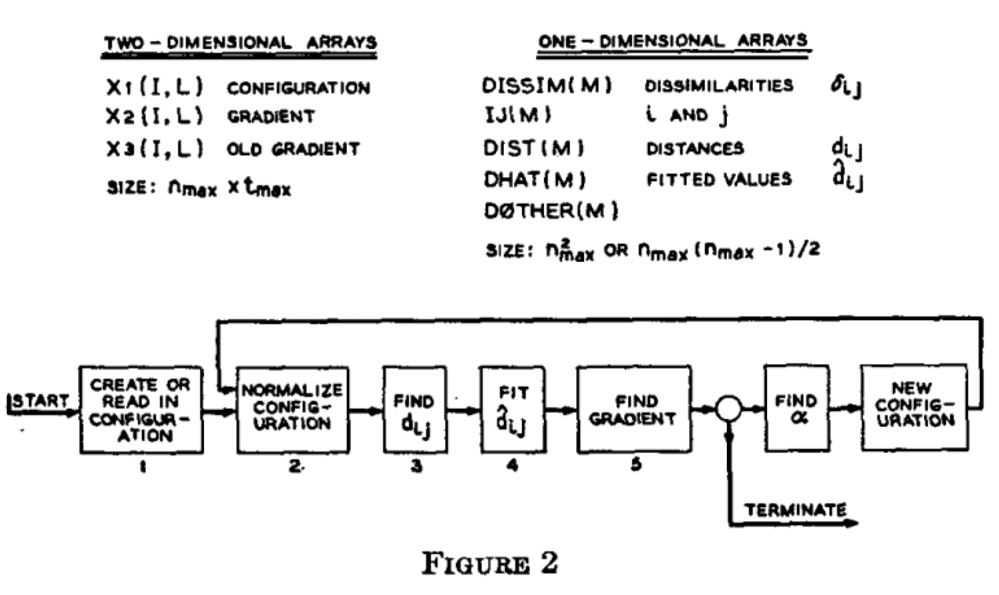
From Kruskal, 1964

Idea is to follow these steps, 

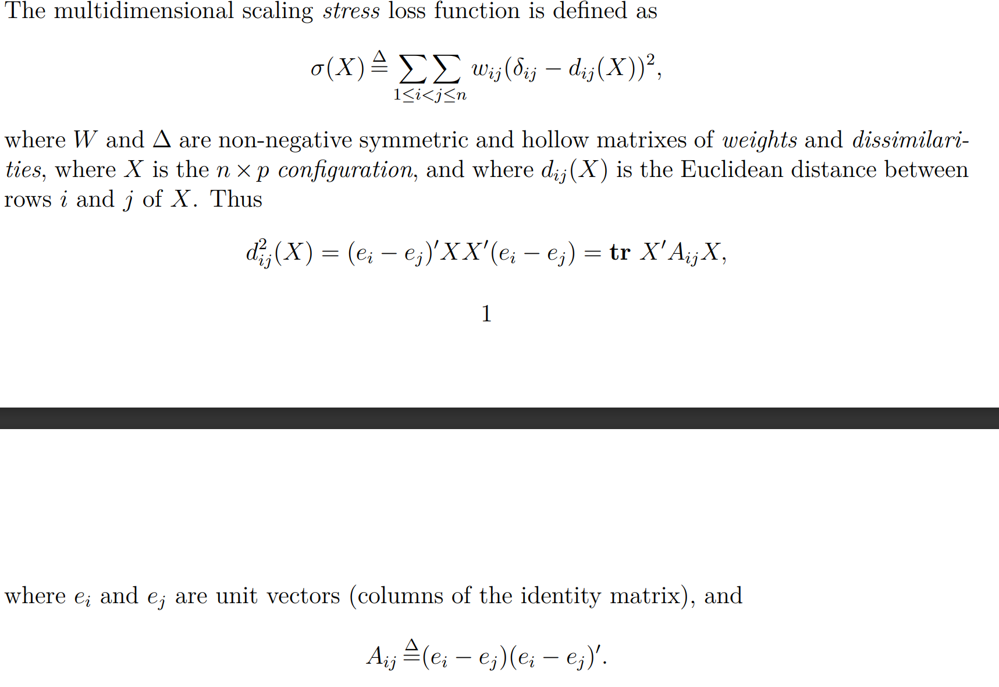
From https://jansweb.netlify.app/publication/deleeuw-e-18-c/
NB: $\delta_{ij}$ here is the true dissimilarity between $i$ and $j$ 

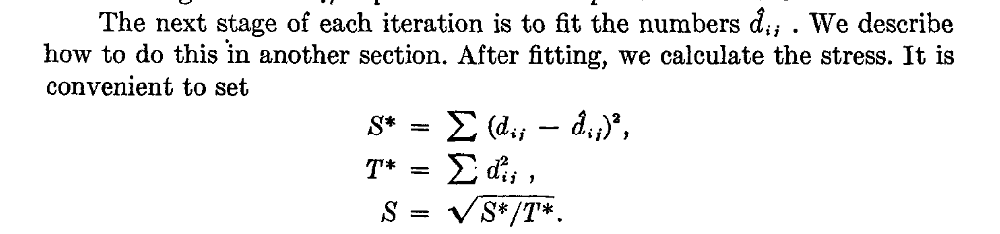
Stress Loss function from Kruskal, 1964

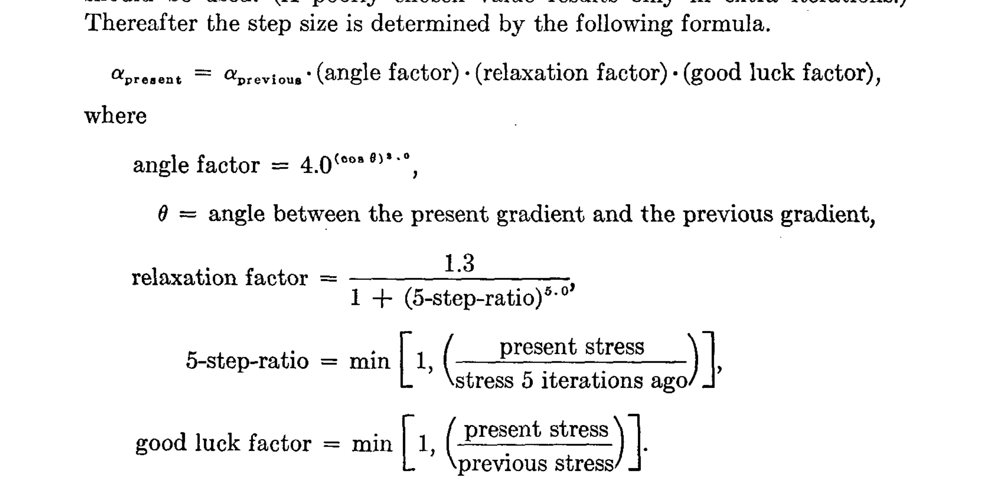
Optimizer from Kruskal, 1964

In [35]:
## Steps 
### Define configuration 
#### for each training iteration
#### normalize 
#### find pairwise distances
#### monotone regression
#### gradient descent



In [36]:
start_config = generate_starting_configuration(dissimilarity_vec, len(big_matrix.index))
def get_stress_for_real_true(config):
    return stress(dissimilarity_vec, get_pairwise_distances(config))

gradiente = elementwise_grad(get_stress_for_real_true)

In [37]:
gradiente(start_config)

Sstar: Autograd ArrayBox with value 0.5223826097042492
Tstar: 1.0000000000000002


array([[-0.11194073,  0.14215395],
       [-0.0513572 ,  0.05351337],
       [-0.0387435 , -0.00553264],
       [ 0.02973577, -0.04598036],
       [ 0.1566584 , -0.12790891],
       [-0.10004363,  0.05637332],
       [ 0.18173765, -0.36497371],
       [-0.06116539,  0.1909996 ],
       [ 0.12184283,  0.08755359],
       [-0.00795271,  0.12020385],
       [-0.12583711,  0.04543456],
       [ 0.04997276, -0.04542958],
       [-0.10473095,  0.17423007],
       [ 0.22006774, -0.09015517],
       [-0.13628417, -0.29330029],
       [-0.02195975,  0.10281834]])

In [38]:
pwds = get_pairwise_distances(start_config)

In [39]:
sort_dict = np.array([range(len(pwds)), np.argsort(pwds)])

In [40]:
sort_dict

array([[  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119],
       [ 81,  61,  12,  58,   8,  82,   9,  71, 114,  73,  89,  43,  59,
         18,  14,  68,  76,  84,  50,  80,  46,  75,   5,  19,  26,  86,
        112,  21,  57,  44,  32,  31,  97,  47,  66,  41, 113,  23,  38,
         70, 102,  83,  13,  17,  30,  52,  60,  40,  45,  93, 117,  96,
         95,  25,  33, 101,

In [41]:
np.array_equal(pwds,np.sort(pwds)[np.lexsort(sort_dict)])

True

In [42]:
np.sort(pwds)

array([0.00019064, 0.00102309, 0.00120607, 0.00228821, 0.00241293,
       0.00242925, 0.0027944 , 0.00312396, 0.00327434, 0.00327555,
       0.00372649, 0.00374789, 0.0053651 , 0.00600757, 0.00699351,
       0.00748613, 0.00786917, 0.00831814, 0.00849611, 0.00968125,
       0.00974293, 0.00984098, 0.01026814, 0.01084765, 0.01101543,
       0.01110836, 0.01140087, 0.01168322, 0.01204145, 0.01317339,
       0.01322003, 0.0141955 , 0.01506777, 0.01506905, 0.0151098 ,
       0.01522745, 0.01590128, 0.01610655, 0.01680478, 0.01721713,
       0.01756793, 0.01762759, 0.01850912, 0.01851874, 0.01978697,
       0.01979376, 0.0202079 , 0.02132474, 0.02178169, 0.02234385,
       0.02382151, 0.02477817, 0.02518978, 0.02604187, 0.02617666,
       0.02645511, 0.02748279, 0.02753347, 0.02769166, 0.02824779,
       0.02907105, 0.02909294, 0.02995336, 0.03025686, 0.03132177,
       0.03147782, 0.03166897, 0.03252217, 0.03341705, 0.03355882,
       0.03379127, 0.03379421, 0.03442351, 0.03509561, 0.03528

In [43]:
def check_satisfied(partition, index, direction):
    if index >= len(partition)-1 or index <= 0:
        return True
    if direction == 'up':
        next_index = index + 1 
        try: 
            assert next_index < len(partition)
        except:
            logger.info("Warning: Out of range")
        if np.mean(partition[index]) < np.mean(partition[next_index]):
            return True
    elif direction == 'down':
        prev_index = index - 1
        assert prev_index > -1
        if np.mean(partition[index]) > np.mean(partition[prev_index]):
            return True
    return False

def merge_blocks(old_partition, index, direction):
    partition = deepcopy(old_partition)
    if direction == 'up':
        assert index + 1 < len(partition)
        partition[index:index+2] = [partition[index] + partition[index+1]]
        logger.info("merged up")
    elif direction == 'down':
        assert index - 1 > -1
        partition[index-1:index+1] = [partition[index] + partition[index-1]]
        logger.info("merged down")
    else:
        raise Exception('no direction')
#     logger.info(f"returning partition: {partition}")
    return partition

def eval_direction_expand(partition, active_index, direction):
    next_direction = "up" if direction == "down" else "down"
    indx_chg = 0
    satisfied = check_satisfied(partition, active_index, direction)
    logger.info(f"currently {satisfied}ly {direction}-satisfied")
    new_partition = deepcopy(partition)
    if not satisfied:
        indx_chg = -1 if direction == "down" else 0 
        logger.info(f"merging {direction} at index {active_index} of partition {new_partition}")
        new_partition = merge_blocks(new_partition, active_index, direction)
    
    return new_partition, next_direction, satisfied, indx_chg

def stabilize_block(new_partition, active_index):
    up_satisfied = False if active_index > 0 else True
    down_satisfied = False if active_index < (len(new_partition)-1) else True
    direction = "up"
    directional_holder = {"up": up_satisfied, "down":down_satisfied}
    iterat = 0
    indx_chg = 0 
    while (not directional_holder["up"]) or (not directional_holder["down"]):
        # check up-satisfied 
        logger.info(directional_holder)
        old_direction = direction
        old_partition = new_partition
        new_partition, direction, is_satisfied, indx_chg = eval_direction_expand(old_partition, active_index, old_direction)
        directional_holder[old_direction] = is_satisfied
        if not np.array_equal(old_partition, new_partition):
            logger.info("Partition Change!")
            directional_holder[old_direction] = False
        active_index += indx_chg
        logger.info (f"at end of iteration {iterat}, {directional_holder} on partition{new_partition}; active_index {active_index}")
        iterat += 1
    return new_partition

class MonoReg:
    def __init__(self, pred_dis, true_dis, verbose=True):
#         breakpoint()
        self.pred_dis = np.array(pred_dis)
        self.true_dis = np.array(true_dis)
        assert len(self.pred_dis) == len(self.true_dis)
        self.sort_dict = np.array([range(len(self.true_dis)), np.argsort(self.true_dis)])
        self.unsort = [int(x) for x in np.lexsort(self.sort_dict)]
        self.order = np.argsort(self.true_dis)
        self.true_dis = self.true_dis[self.order]
        self.pred_dis = self.pred_dis[self.order]
        self.partition = [[x] for x in self.pred_dis]
        if not verbose:
            logger.add (sys.stdout, format=" {time} {level} {message}", filter="my_module", level="DEBUG")
        
    def apply_mean(self):
        self.pred_dis_out = [[np.mean(y) for z in y] for y in self.partition]
        self.pred_dis_out = [*it.chain.from_iterable([[np.mean(y) for z in y] for y in self.pred_dis_out])]
#         breakpoint()
        plt.scatter(self.pred_dis_out, self.true_dis)
        plt.show()
        plt.close()
        logger.info("PRED_DIS_OUT:")
        logger.info(self.pred_dis_out)
        self.first_diffs = [self.pred_dis_out[1:][x] - self.pred_dis_out[:-1][x] for x in range(len(self.pred_dis_out) - 1)]
        return
        
         
    def run_monoreg(self):
        # loop over active_blocks -- now, 
        for block  in range(len(self.partition)):
            new_partition = deepcopy(self.partition)
            self.partition = stabilize_block(new_partition, block)
            if block == len(self.partition) - 1:
                break
            # 
        self.apply_mean()
        logger.info(f"FIRST DIFFS:\n{self.first_diffs}" )
        while any([x < 0 for x in self.first_diffs]):
            for block  in range(len(self.partition)):
                new_partition = deepcopy(self.partition)
                self.partition = stabilize_block(new_partition, block)
                if block == len(self.partition) - 1:
                    break
            # 
            self.apply_mean()
            
        self.pred_dis_out = [self.pred_dis_out[x] for x in self.unsort]
        plt.scatter(self.pred_dis_out, self.true_dis[self.unsort])
        plt.show()
        plt.close()
        logger.info(f"FIRST DIFFS:\n{self.first_diffs}" )
        return self.pred_dis_out
   

In [44]:
listx = [[1,4,6], [29,13215, 421,1321], [13231,412], [141, 1321, -1,231 ,2]]


In [45]:
total_len = sum([x for x in map(len, listx)])

In [46]:
[x for x in range(total_len)]

[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13]

In [47]:
x_partition = [[t] for t in it.chain.from_iterable([[z for z in y] for y in listx])]

In [48]:
x_partition

[[1],
 [4],
 [6],
 [29],
 [13215],
 [421],
 [1321],
 [13231],
 [412],
 [141],
 [1321],
 [-1],
 [231],
 [2]]

In [49]:
h = stabilize_block(x_partition, 2)

2022-08-21 05:33:19.393 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:19.396 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:19.400 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[1], [4], [6], [29], [13215], [421], [1321], [13231], [412], [141], [1321], [-1], [231], [2]]; active_index 2
2022-08-21 05:33:19.402 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:19.405 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:19.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[1], [4], [6], [29], [13215], [421], [1321], [13231], [412], [141], [1321], [-1], [231], [2]]; active_index 2


In [50]:
h

[[1],
 [4],
 [6],
 [29],
 [13215],
 [421],
 [1321],
 [13231],
 [412],
 [141],
 [1321],
 [-1],
 [231],
 [2]]

In [51]:
[[np.mean(y)for x in y] for y in h]

[[1.0],
 [4.0],
 [6.0],
 [29.0],
 [13215.0],
 [421.0],
 [1321.0],
 [13231.0],
 [412.0],
 [141.0],
 [1321.0],
 [-1.0],
 [231.0],
 [2.0]]

In [52]:
#  MonoReg(true_dis=np.random.choice(a=total_len, size=total_len,replace=False),pred_dis=[y[0] for y in x_partition]).run_monoreg()

2022-08-21 05:33:19.478 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:19.481 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:19.484 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010268144740070057], [0.0032755521139927464], [0.04833697861695617], [0.0037478916399102686], [0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.020207

2022-08-21 05:33:19.505 | INFO     | __main__:merge_blocks:28 - merged down
/usr/local/lib/python3.8/dist-packages/numpy/core/numeric.py:2443: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  a1, a2 = asarray(a1), asarray(a2)
2022-08-21 05:33:19.516 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:19.518 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.04833697861695617], [0.0037478916399102686], [0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009

2022-08-21 05:33:19.549 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:19.555 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:19.558 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.04833697861695617], [0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123967842087], [0.0

2022-08-21 05:33:19.580 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:19.582 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:19.584 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.0450631584143107], [0.015069051847974371], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263

2022-08-21 05:33:19.627 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:19.630 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:19.635 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.015069051847974371, 0.0450631584143107], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559

2022-08-21 05:33:19.669 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:19.677 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:19.694 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.015069051847974371, 0.0450631584143107], [0.035095613599549505], [0.03528899646878123, 0.0074861277149283504], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123

2022-08-21 05:33:19.721 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:19.723 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:19.728 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.015069051847974371, 0.0450631584143107], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.0185091239678

2022-08-21 05:33:19.751 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:19.753 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:19.755 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [

2022-08-21 05:33:19.788 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:19.790 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:19.795 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586], [0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.

2022-08-21 05:33:19.828 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:19.830 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:19.832 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.08501000073170586, 0.007869167272923817], [0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123967842087]

2022-08-21 05:33:19.863 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:19.865 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:19.868 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949], [0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.0185

2022-08-21 05:33:19.900 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:19.904 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:19.907 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114], [0.026176657148531735], [0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123967842087], [0.009840

2022-08-21 05:33:19.936 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:19.938 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:19.940 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805], [0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123967842087], [0.009840983921081526], [0.0762

2022-08-21 05:33:19.965 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:19.968 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:19.970 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342], [0.06257203715041604], [0.03379127477014922], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123967

2022-08-21 05:33:20.001 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:20.005 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:20.009 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342], [0.03379127477014922, 0.06257203715041604], [0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123967842087], [0.009840983921081526], [0.076262

2022-08-21 05:33:20.035 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.036 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.039 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424], [0.04629356798272005], [0.003123958059097663], [0.02020790263559636], [0.018509123967842087], [0.0098409839210815

2022-08-21 05:33:20.060 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:20.061 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:20.064 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663], [0.02020790263559636], [0.018509123967842087], [0.009840983921081526], [0.07626244344846

2022-08-21 05:33:20.081 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.083 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:20.085 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636], [0.018509123967842087], [0

2022-08-21 05:33:20.131 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:20.133 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:20.135 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342], [0.009840983921081526], [0.0762624434484613

2022-08-21 05:33:20.170 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.173 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:20.180 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.0098409

2022-08-21 05:33:20.209 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.212 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.214 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.0762

2022-08-21 05:33:20.244 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:20.246 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.248 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07

2022-08-21 05:33:20.276 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:20.278 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:20.280 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [0

2022-08-21 05:33:20.318 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.320 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:20.322 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984

2022-08-21 05:33:20.345 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.348 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.350 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.076

2022-08-21 05:33:20.374 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:20.376 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:20.380 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [

2022-08-21 05:33:20.407 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:20.409 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:20.411 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [

2022-08-21 05:33:20.436 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:20.438 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:20.441 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [

2022-08-21 05:33:20.472 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.473 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:20.476 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984

2022-08-21 05:33:20.499 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.501 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:20.504 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:20.527 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:20.529 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:20.531 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.0098409

2022-08-21 05:33:20.562 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:20.564 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:20.566 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840

2022-08-21 05:33:20.589 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:20.592 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:20.594 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.0098409

2022-08-21 05:33:20.616 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:20.618 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:20.621 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840

2022-08-21 05:33:20.658 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:20.660 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:20.662 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.0098409

2022-08-21 05:33:20.687 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:20.689 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:20.691 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0

2022-08-21 05:33:20.729 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:20.733 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.743 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07

2022-08-21 05:33:20.768 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:20.771 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.773 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07

2022-08-21 05:33:20.809 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:20.811 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:20.813 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840

2022-08-21 05:33:20.834 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:20.836 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:20.838 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0

2022-08-21 05:33:20.871 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:20.873 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.875 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07

2022-08-21 05:33:20.916 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:20.918 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:20.924 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840

2022-08-21 05:33:20.953 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:20.956 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:20.959 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.0098

2022-08-21 05:33:20.985 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:20.986 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:20.989 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.076

2022-08-21 05:33:21.021 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:21.023 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:21.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [0

2022-08-21 05:33:21.048 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.050 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:21.052 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984

2022-08-21 05:33:21.081 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:21.083 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:21.085 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07

2022-08-21 05:33:21.107 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:21.109 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:21.111 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [0

2022-08-21 05:33:21.164 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:21.166 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:21.168 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [

2022-08-21 05:33:21.190 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.192 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.195 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.232 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.256 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.274 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.304 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.306 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.309 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.334 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.335 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.337 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.360 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.362 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.366 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.406 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.407 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.410 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.428 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.430 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.431 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.469 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.471 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.472 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.503 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.505 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.507 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.533 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.538 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.541 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.578 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.593 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.595 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.623 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.625 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.627 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.669 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.670 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.721 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.723 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.728 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

2022-08-21 05:33:21.776 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:21.779 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:21.783 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098

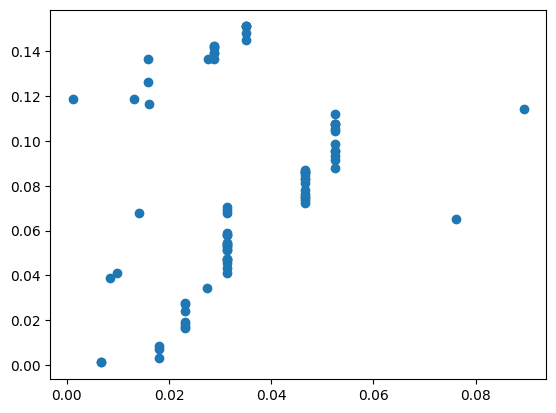

2022-08-21 05:33:22.149 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:22.152 | INFO     | __main__:apply_mean:92 - [0.006771848427031402, 0.006771848427031402, 0.018124358919276485, 0.018124358919276485, 0.018124358919276485, 0.02310394545704753, 0.02310394545704753, 0.02310394545704753, 0.02310394545704753, 0.02310394545704753, 0.02310394545704753, 0.02310394545704753, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.07626244344846135, 0.014195502516112044, 0.0312982348451027, 0.0312982348451027, 0.0312982348451027, 0.046552249483986605, 0.046552249483986605, 0.046552249483986605, 0.046552249483986605, 0.0465522494

2022-08-21 05:33:22.175 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:22.179 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:22.181 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840

2022-08-21 05:33:22.200 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:22.201 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:22.203 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521], [0.02748278693079935, 0.008496107523515171], [0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [0.

2022-08-21 05:33:22.220 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:22.221 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:22.223 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135], [0.0141

2022-08-21 05:33:22.245 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:22.247 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:22.249 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135, 0.014195

2022-08-21 05:33:22.274 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:22.276 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:22.277 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098392

2022-08-21 05:33:22.290 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:22.291 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:22.292 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921

2022-08-21 05:33:22.324 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:22.325 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:22.327 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.0098409839

2022-08-21 05:33:22.351 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:22.353 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:22.354 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135, 0.0141

2022-08-21 05:33:22.376 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:22.378 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:22.384 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.0762624434

2022-08-21 05:33:22.411 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:22.413 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:22.416 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.076262443

2022-08-21 05:33:22.437 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:22.441 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:22.443 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.009840983921081526], [0.07626244344846135, 0.014195

2022-08-21 05:33:22.463 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:22.466 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:22.469 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.0098409839

2022-08-21 05:33:22.493 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:22.495 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:22.498 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098392108

2022-08-21 05:33:22.531 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:22.534 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:22.536 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098392108

2022-08-21 05:33:22.557 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:22.559 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:22.561 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0032755521139927464, 0.010268144740070057], [0.0037478916399102686, 0.0022882065009630134, 0.04833697861695617], [0.02748278693079935, 0.008496107523515171, 0.03528899646878123, 0.0074861277149283504, 0.035095613599549505, 0.011683219187102016, 0.015069051847974371, 0.0450631584143107, 0.012041450966686521, 0.009742925377006549], [0.03379127477014922, 0.06257203715041604, 0.04295335290830424, 0.04629356798272005, 0.003123958059097663, 0.02020790263559636, 0.018509123967842087, 0.08501000073170586, 0.007869167272923817, 0.05426043357533024, 0.01680477581910949, 0.03147782447721114, 0.026176657148531735, 0.03132176578328805, 0.011015430035404342, 0.00984098392108

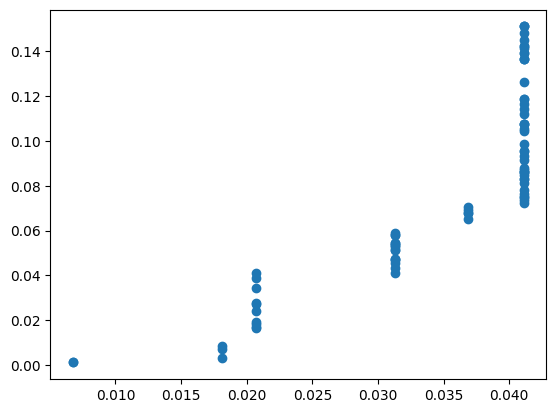

2022-08-21 05:33:22.981 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:22.984 | INFO     | __main__:apply_mean:92 - [0.006771848427031402, 0.006771848427031402, 0.018124358919276485, 0.018124358919276485, 0.018124358919276485, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.020744943803065373, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.03132676601491949, 0.0368705300999763, 0.0368705300999763, 0.0368705300999763, 0.0368705300999763, 0.0368705300999763, 0.041114032489274754, 0.041114032489274754, 0.041114032489274754, 0.041114032489274754, 0.04111

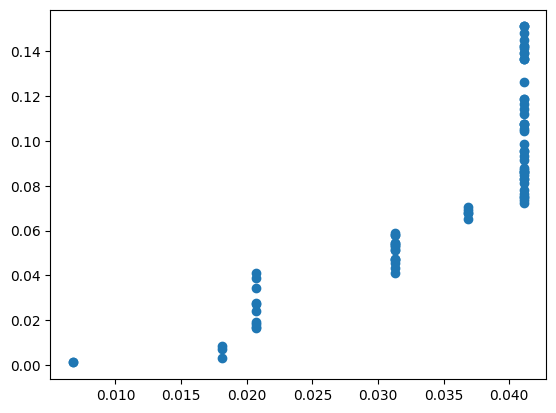

2022-08-21 05:33:23.308 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.011352510492245083, 0.0, 0.0, 0.002620584883788888, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.010581822211854115, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0055437640850568085, 0.0, 0.0, 0.0, 0.0, 0.004243502389298458, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]


In [53]:
monoreg_out = MonoReg(pred_dis=pwds[:80], true_dis=dissimilarity_vec[:80]).run_monoreg()

In [54]:
monoreg_out

[0.03132676601491949,
 0.041114032489274754,
 0.03132676601491949,
 0.041114032489274754,
 0.03132676601491949,
 0.006771848427031402,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.03132676601491949,
 0.041114032489274754,
 0.041114032489274754,
 0.03132676601491949,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.020744943803065373,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.041114032489274754,
 0.03132676601491949,
 0.041114032489274754,
 0.0368705300999763,
 0.041114032489274754,
 0.041114032489274754,
 0.0368705300999763,
 0.041114032489274754,
 0.03132676601491949,
 0.041114032489274754,
 0.041114032489274754,
 0.020744943803065373,
 0.041114032489274754,
 0.03132676601491949,
 0.041114032489274754,
 0.041114032489274754,
 0.0368705300999763,
 0.03132676601491949,
 0.018124358919276485,
 0.

2022-08-21 05:33:23.370 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:23.373 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:23.377 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.02382150871341462], [0.010268144740070057], [0.0032755521139927464], [0.011400866581989546], [0.04833697861695617], [0.0037478916399102686], [0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.06911291028164197], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.0261

2022-08-21 05:33:23.404 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:23.406 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:23.408 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.02382150871341462], [0.010268144740070057, 0.0032755521139927464], [0.011400866581989546], [0.04833697861695617], [0.0037478916399102686], [0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.06911291028164197], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], 

2022-08-21 05:33:23.433 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:23.434 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:23.438 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617], [0.0037478916399102686], [0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.06911291028164197], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.0261766

2022-08-21 05:33:23.457 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:23.459 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:23.461 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686], [0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.06911291028164197], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.0

2022-08-21 05:33:23.479 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:23.481 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:23.483 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.06911291028164197], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.0110

2022-08-21 05:33:23.514 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:23.520 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:23.522 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107], [0.015069051847974371], [0.06911291028164197], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883

2022-08-21 05:33:23.541 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:23.543 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:23.546 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197], [0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531

2022-08-21 05:33:23.569 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:23.571 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:23.579 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197, 0.035095613599549505], [0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.0261766571485

2022-08-21 05:33:23.605 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:23.607 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:23.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123], [0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.0261766571485317

2022-08-21 05:33:23.629 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:23.631 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:23.636 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504], [0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735

2022-08-21 05:33:23.661 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:23.667 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:23.670 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385], [0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735],

2022-08-21 05:33:23.688 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:23.690 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:23.693 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739], [0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [

2022-08-21 05:33:23.707 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:23.709 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:23.712 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016], [0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0

2022-08-21 05:33:23.727 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:23.728 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:23.752 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.0450631584143107, 0.015069051847974371], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521], [0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [

2022-08-21 05:33:23.771 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:23.773 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:23.775 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935], [0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.011015430035404342], [

2022-08-21 05:33:23.793 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:23.794 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:23.797 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171], [0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.011015430035404342], [0.0

2022-08-21 05:33:23.813 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:23.816 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:23.817 | INFO     | __main__:stabilize_block:65 - at end of iteration 18, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.011015430035404342], [0.031

2022-08-21 05:33:23.833 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:23.835 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:23.860 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.05426043357533024], [0.025189779877810903], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236

2022-08-21 05:33:23.883 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:23.885 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:23.888 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.025189779877810903, 0.05426043357533024], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457

2022-08-21 05:33:23.914 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:23.916 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:23.920 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.025189779877810903, 0.05426043357533024], [0.08501000073170586], [0.003274339672452309], [0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.01101543

2022-08-21 05:33:23.948 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:23.950 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:23.953 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.025189779877810903, 0.05426043357533024], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.011015430035404342], [0.031321765

2022-08-21 05:33:23.970 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:23.972 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:23.986 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024], [0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.01101543003540434

2022-08-21 05:33:24.017 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:24.020 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:24.025 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949], [0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.011015430035404342],

2022-08-21 05:33:24.054 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:24.056 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:24.060 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294], [0.01

2022-08-21 05:33:24.090 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.092 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.094 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294, 0.

2022-08-21 05:33:24.112 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:24.114 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.118 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294, 0.0

2022-08-21 05:33:24.140 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.142 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.145 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.11642883236457294, 0.011015430035404342, 0.03132176578328805],

2022-08-21 05:33:24.176 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.179 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:24.183 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.06257203715041604, 0.03379127477014922, 0.11

2022-08-21 05:33:24.210 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:24.212 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:24.216 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.06257203715041604, 0.0337

2022-08-21 05:33:24.239 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:24.242 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.245 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.06257203715041604, 0.03379127477014922, 0.11642883236457294, 

2022-08-21 05:33:24.265 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:24.268 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.270 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.003123958059097663, 0.058997412482061605, 0.06257203715041604

2022-08-21 05:33:24.291 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.293 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:24.296 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.003123958059097663, 0.058997412482061605, 0

2022-08-21 05:33:24.317 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:24.320 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.326 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.003123958059097663, 0.058997412482061605, 0.0625720371504160

2022-08-21 05:33:24.351 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:24.353 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.356 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.003123958059097663, 0.058997412482061605, 0.06257203715041604

2022-08-21 05:33:24.375 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.377 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:24.381 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.003123958059097663, 0.058997412482061605

2022-08-21 05:33:24.428 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:24.430 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.436 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.00

2022-08-21 05:33:24.455 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.457 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.459 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:24.475 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:24.477 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.480 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.0

2022-08-21 05:33:24.495 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:24.497 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.500 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.0

2022-08-21 05:33:24.522 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.525 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.527 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

2022-08-21 05:33:24.561 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.562 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.565 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:24.584 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.586 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.588 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:24.617 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.618 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.620 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:24.644 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.645 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.647 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:24.675 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.677 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.679 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

2022-08-21 05:33:24.708 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.710 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:24.713 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.

2022-08-21 05:33:24.735 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:24.749 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.752 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.01850912396784208

2022-08-21 05:33:24.775 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.778 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.784 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:24.821 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:24.824 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.829 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.00

2022-08-21 05:33:24.863 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.873 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:24.877 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526

2022-08-21 05:33:24.894 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:24.897 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.901 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

2022-08-21 05:33:24.920 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.923 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:24.925 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.

2022-08-21 05:33:24.950 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:24.953 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:24.954 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.01850912396784208

2022-08-21 05:33:24.989 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:24.991 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:24.995 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:25.024 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:25.025 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.028 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

2022-08-21 05:33:25.044 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:25.046 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.051 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.

2022-08-21 05:33:25.068 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.070 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.074 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.0

2022-08-21 05:33:25.117 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.120 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:25.124 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.0098

2022-08-21 05:33:25.147 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:25.150 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:25.155 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526

2022-08-21 05:33:25.180 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:25.189 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:25.201 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.00

2022-08-21 05:33:25.246 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:25.253 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.256 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087

2022-08-21 05:33:25.289 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:25.291 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.297 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087

2022-08-21 05:33:25.319 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:25.322 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:25.325 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.00

2022-08-21 05:33:25.353 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:25.355 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:25.359 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009

2022-08-21 05:33:25.381 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:25.383 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:25.386 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009

2022-08-21 05:33:25.407 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:25.411 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:25.413 | INFO     | __main__:eval_direction_expand:42 - merging down at index 20 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526,

2022-08-21 05:33:25.434 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:25.436 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:25.438 | INFO     | __main__:eval_direction_expand:42 - merging down at index 19 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526,

2022-08-21 05:33:25.456 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:25.461 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.463 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

2022-08-21 05:33:25.479 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:25.480 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.483 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.

2022-08-21 05:33:25.505 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:25.506 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.512 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.01850912396784208

2022-08-21 05:33:25.529 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:25.531 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:25.534 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:25.555 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.559 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:25.562 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:25.582 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.589 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:25.592 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:25.618 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.621 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:25.624 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:25.653 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.655 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:25.657 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526,

2022-08-21 05:33:25.676 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:25.679 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:25.684 | INFO     | __main__:stabilize_block:65 - at end of iteration 19, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.0

2022-08-21 05:33:25.702 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:25.704 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:25.707 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:25.726 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:25.728 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.730 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

2022-08-21 05:33:25.765 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:25.768 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.771 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:25.792 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:25.797 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.798 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:25.816 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:25.818 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:25.820 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:25.843 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:25.846 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.850 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.

2022-08-21 05:33:25.870 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.872 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.883 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.0

2022-08-21 05:33:25.900 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.902 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.911 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.0

2022-08-21 05:33:25.931 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.933 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.936 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.0

2022-08-21 05:33:25.954 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.968 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:25.971 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.0

2022-08-21 05:33:25.990 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:25.996 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:26.000 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.0

2022-08-21 05:33:26.017 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:26.020 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:26.023 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009

2022-08-21 05:33:26.052 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.054 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:26.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.

2022-08-21 05:33:26.077 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:26.085 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:26.088 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.0

2022-08-21 05:33:26.105 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.107 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.109 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

2022-08-21 05:33:26.131 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.133 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.135 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:26.156 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.157 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.159 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:26.175 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.176 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.185 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:26.201 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.202 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.204 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 

2022-08-21 05:33:26.219 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.222 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.224 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087,

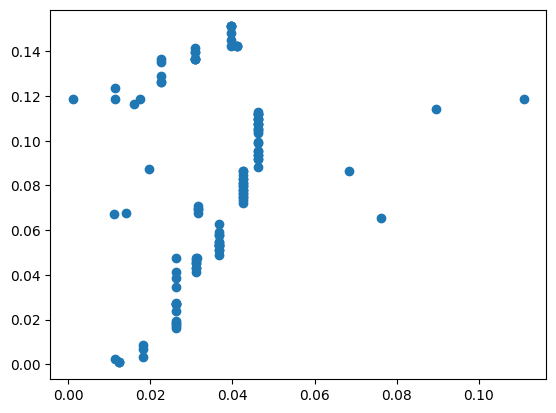

2022-08-21 05:33:26.497 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:26.499 | INFO     | __main__:apply_mean:92 - [0.012455068522492474, 0.012455068522492474, 0.012455068522492474, 0.011400866581989546, 0.018124358919276485, 0.018124358919276485, 0.018124358919276485, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.031026667398771246, 0.031026667398771246, 0.031026667398771246, 0.031026667398771246, 0.031026667398771246, 0.031026667398771246, 0.031026667398771246, 0.03147782447721114, 0.026176657148531735, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.03672303789152438, 0.036723037891

2022-08-21 05:33:26.544 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.547 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:26.553 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.011400866581989546], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.00

2022-08-21 05:33:26.580 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:26.584 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:26.590 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.00984

2022-08-21 05:33:26.628 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:26.630 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:26.634 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.0098

2022-08-21 05:33:26.660 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.663 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:26.668 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.03147782447721114], [0.026176657148531735], [0.02020790263559636, 0.009840983921081526, 0.018

2022-08-21 05:33:26.695 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:26.702 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.705 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.02020790263559636, 0.009840983921081526, 0.018509123967842087, 0.0

2022-08-21 05:33:26.726 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.728 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:26.731 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.02020790263559636, 0.009840983921081526, 0.0185091

2022-08-21 05:33:26.751 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:26.753 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:26.763 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.02020790263559636, 0.009840983921081526, 0.01850912

2022-08-21 05:33:26.778 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:26.780 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.782 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014195502516112044, 0.0

2022-08-21 05:33:26.798 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.801 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:26.804 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108

2022-08-21 05:33:26.831 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.832 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.835 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014195502516112044, 0.020

2022-08-21 05:33:26.852 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.854 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:26.856 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:26.883 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:26.885 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.896 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014195502516112044, 0.020

2022-08-21 05:33:26.915 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.917 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:26.920 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.0141955

2022-08-21 05:33:26.934 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:26.937 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:26.941 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.01419550

2022-08-21 05:33:26.959 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:26.961 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:26.963 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014195502516112044, 0.0

2022-08-21 05:33:26.990 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:26.992 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:26.994 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014

2022-08-21 05:33:27.011 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:27.013 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:27.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014195502516112044, 0.020

2022-08-21 05:33:27.039 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:27.041 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:27.056 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.0141955

2022-08-21 05:33:27.072 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:27.074 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:27.076 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014195502516112044, 0.0

2022-08-21 05:33:27.096 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:27.097 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.101 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.0111083571

2022-08-21 05:33:27.119 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:27.127 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.136 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.0111083571

2022-08-21 05:33:27.153 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:27.155 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.158 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.0111083571

2022-08-21 05:33:27.186 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:27.187 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.190 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.0111083571

2022-08-21 05:33:27.209 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:27.211 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.214 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.0111083571

2022-08-21 05:33:27.240 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:27.241 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.243 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.0111083571

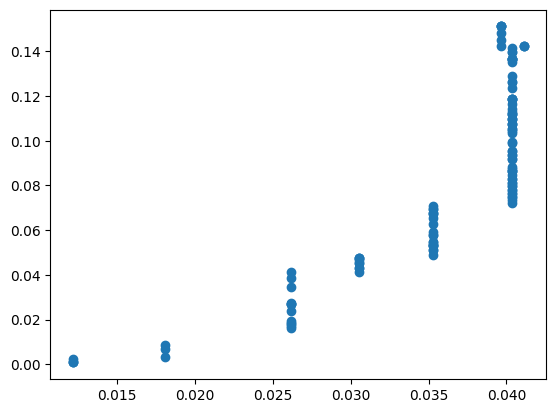

2022-08-21 05:33:27.477 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:27.478 | INFO     | __main__:apply_mean:92 - [0.012191518037366744, 0.012191518037366744, 0.012191518037366744, 0.012191518037366744, 0.018124358919276485, 0.018124358919276485, 0.018124358919276485, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.0352691336

2022-08-21 05:33:27.497 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:27.499 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.502 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:27.518 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:27.521 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:27.524 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:27.542 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:27.548 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.551 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:27.578 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:27.580 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:27.593 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:27.608 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:27.610 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:27.612 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108

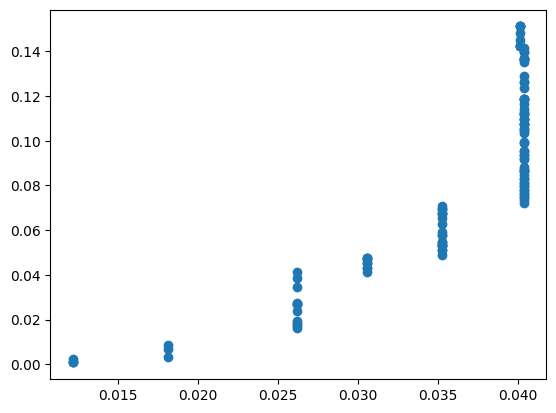

2022-08-21 05:33:27.870 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:27.872 | INFO     | __main__:apply_mean:92 - [0.012191518037366744, 0.012191518037366744, 0.012191518037366744, 0.012191518037366744, 0.018124358919276485, 0.018124358919276485, 0.018124358919276485, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.0352691336

2022-08-21 05:33:27.891 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:27.893 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.897 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:27.917 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:27.920 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:27.923 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:27.941 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:27.944 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:27.947 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.01110835

2022-08-21 05:33:27.966 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:27.968 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:27.990 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.011400866581989546, 0.010268144740070057, 0.0032755521139927464, 0.02382150871341462], [0.04833697861695617, 0.0037478916399102686, 0.0022882065009630134], [0.06911291028164197, 0.035095613599549505, 0.03528899646878123, 0.0074861277149283504, 0.030256856951707385, 0.03379421368393739, 0.011683219187102016, 0.012041450966686521, 0.0450631584143107, 0.015069051847974371, 0.02748278693079935, 0.008496107523515171, 0.009742925377006549], [0.03147782447721114, 0.026176657148531735, 0.003274339672452309, 0.08501000073170586, 0.007869167272923817, 0.025189779877810903, 0.05426043357533024, 0.01680477581910949, 0.024778174842066084], [0.07626244344846135, 0.011108357106588999, 0.014195502516112044, 0.020

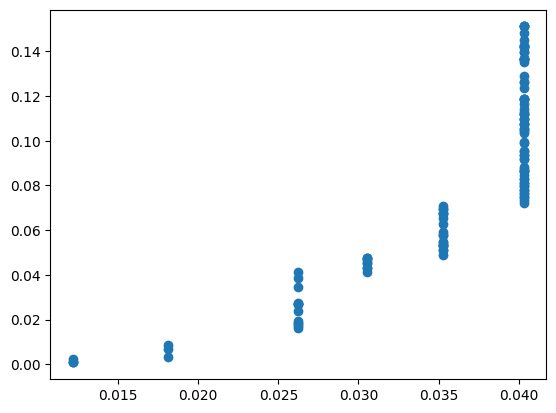

2022-08-21 05:33:28.231 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:28.232 | INFO     | __main__:apply_mean:92 - [0.012191518037366744, 0.012191518037366744, 0.012191518037366744, 0.012191518037366744, 0.018124358919276485, 0.018124358919276485, 0.018124358919276485, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.026201032226764658, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.03053790593523795, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.035269133644340124, 0.0352691336

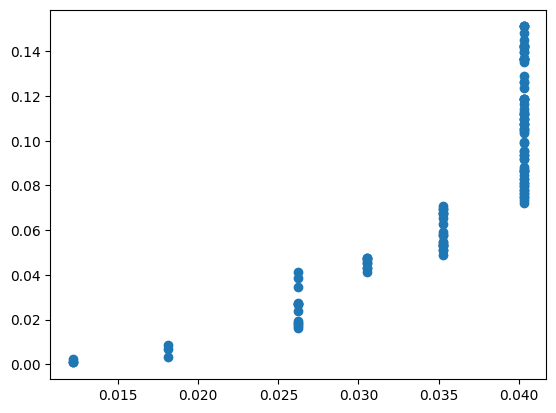

2022-08-21 05:33:28.581 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.0, 0.0, 0.005932840881909741, 0.0, 0.0, 0.008076673307488173, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.004336873708473292, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.004731227709102174, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.005053339674719937, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
2022-08-21 05:33:28.633 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:28.636 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:28.640 | INFO     | __main_

2022-08-21 05:33:28.664 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:28.666 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:28.668 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.025125794242384918], [0.01356262797619259, 0.004038751217872642], [0.011519347108399549], [0.06424009153884155], [0.005199771821048457], [0.0020933990585694623], [0.062439145719008035], [0.01978584922054619], [0.08482980568833494], [0.0376099765524103], [0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.0

2022-08-21 05:33:28.691 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:28.694 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:28.704 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155], [0.005199771821048457], [0.0020933990585694623], [0.062439145719008035], [0.01978584922054619], [0.08482980568833494], [0.0376099765524103], [0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.0416612496

2022-08-21 05:33:28.733 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:28.736 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:28.739 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457], [0.0020933990585694623], [0.062439145719008035], [0.01978584922054619], [0.08482980568833494], [0.0376099765524103], [0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.01709

2022-08-21 05:33:28.758 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:28.771 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:28.773 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035], [0.01978584922054619], [0.08482980568833494], [0.0376099765524103], [0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.01709082

Sstar: 0.4024663311349181
Tstar: 1.0000000000000002
stress: 0.6344023416846111
Sstar: Autograd ArrayBox with value 0.5223826097042492
Tstar: 1.0000000000000002


2022-08-21 05:33:28.785 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:28.788 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035], [0.01978584922054619], [0.08482980568833494], [0.0376099765524103], [0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [0.12027813054219677

2022-08-21 05:33:28.810 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:28.813 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:28.816 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.08482980568833494], [0.0376099765524103], [0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892

2022-08-21 05:33:28.839 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:28.842 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:28.844 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.08482980568833494, 0.0376099765524103], [0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.01709082376

2022-08-21 05:33:28.880 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:28.882 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:28.884 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.08482980568833494, 0.0376099765524103, 0.045953466544519955], [0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.01709082376531

2022-08-21 05:33:28.905 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:28.907 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:28.909 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.0170908237653143

2022-08-21 05:33:28.931 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:28.933 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:28.936 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749], [0.05200911697376682], [0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], 

2022-08-21 05:33:28.956 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:28.958 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:28.961 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749], [0.05200911697376682, 0.041733300978132964], [0.013047385186262325], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.

2022-08-21 05:33:28.982 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:28.985 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:28.988 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749], [0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.017090823765314338]

2022-08-21 05:33:29.009 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.011 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:29.013 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.062439145719008035, 0.01978584922054619], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249], [0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.0

2022-08-21 05:33:29.033 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.036 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.038 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893], [0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:29.065 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.067 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.070 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332], [0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.017090823765314338], [0.036794

2022-08-21 05:33:29.089 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.091 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.093 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.017090823765314338], [0.0367942

2022-08-21 05:33:29.107 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.109 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:29.112 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627], [0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.0170908237653

2022-08-21 05:33:29.127 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:29.129 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:29.132 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.07986504612344686], [0.048656261740528305], [0.09505384411602627, 0.0028068942024923934], [0.011676849441346697], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.0170908237653143

2022-08-21 05:33:29.156 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:29.158 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.160 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.07986504612344686], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305], [0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.017090823765314338], [0.03679426957

2022-08-21 05:33:29.176 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.177 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:29.180 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.07986504612344686], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.01709082376531433

2022-08-21 05:33:29.212 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:29.213 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:29.216 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.050165451923047735], [0.049147411485503445], [0.04166124969892694], [0.12350053116281678], [0.01

2022-08-21 05:33:29.255 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:29.257 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.260 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.050165451923047735], [0.04166124969892694, 0.049147411485503445], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684

2022-08-21 05:33:29.297 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:29.299 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.305 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684],

2022-08-21 05:33:29.331 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.333 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:29.336 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:29.360 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.362 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.364 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:29.396 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.399 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.401 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:29.428 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.429 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.431 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:29.460 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.463 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.466 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:29.494 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.496 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.498 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:29.516 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.518 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.521 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:29.539 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.541 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.557 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:29.579 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.581 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.584 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:29.605 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.607 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.609 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:29.629 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.636 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:29.639 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.03

2022-08-21 05:33:29.664 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:29.667 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:29.670 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:29.693 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:29.700 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:29.703 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:29.722 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.724 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:29.727 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.0170

2022-08-21 05:33:29.747 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:29.748 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:29.751 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0

2022-08-21 05:33:29.775 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.777 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.778 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:29.796 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.798 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:29.801 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:29.827 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:29.829 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:29.834 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0

2022-08-21 05:33:29.853 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:29.855 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:29.858 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:29.881 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:29.884 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:29.889 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.03

2022-08-21 05:33:29.914 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:29.917 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:29.922 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:29.945 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:29.947 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:29.952 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:29.976 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:29.979 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:29.982 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.0170908

2022-08-21 05:33:30.021 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.025 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.030 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.0170

2022-08-21 05:33:30.057 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.060 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.066 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709

2022-08-21 05:33:30.108 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:30.110 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:30.113 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:30.144 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.148 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.153 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.03

2022-08-21 05:33:30.173 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.176 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:30.196 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:30.217 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:30.220 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:30.226 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684],

2022-08-21 05:33:30.243 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.245 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:30.247 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:30.261 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:30.263 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.265 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:30.289 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.291 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:30.294 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:30.324 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:30.333 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:30.336 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684],

2022-08-21 05:33:30.363 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.366 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:30.369 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [

2022-08-21 05:33:30.390 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:30.392 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:30.395 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:30.413 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.415 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:30.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:30.437 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:30.439 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:30.452 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.0170908

2022-08-21 05:33:30.469 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:30.471 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:30.474 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.0170908

2022-08-21 05:33:30.499 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:30.502 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.505 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:30.532 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.534 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:30.538 | INFO     | __main__:eval_direction_expand:42 - merging down at index 20 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [

2022-08-21 05:33:30.556 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:30.569 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.572 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:30.591 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.594 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:30.596 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [

2022-08-21 05:33:30.613 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:30.623 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:30.626 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:30.641 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.643 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.646 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.03

2022-08-21 05:33:30.662 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.665 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.667 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:30.684 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.686 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.706 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:30.719 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.722 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.725 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:30.745 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.748 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.751 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:30.772 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.776 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:30.780 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:30.805 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.806 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:30.810 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.0170908

2022-08-21 05:33:30.834 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:30.836 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.840 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.0170

2022-08-21 05:33:30.885 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.888 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.891 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709

2022-08-21 05:33:30.913 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.916 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.919 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709

2022-08-21 05:33:30.949 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:30.954 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:30.958 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709

2022-08-21 05:33:30.984 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:30.987 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:30.991 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:31.010 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.012 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.034 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.037 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.039 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.057 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:31.060 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:31.069 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.03

2022-08-21 05:33:31.087 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.089 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.092 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.119 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:31.121 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:31.124 | INFO     | __main__:eval_direction_expand:42 - merging down at index 24 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [

2022-08-21 05:33:31.138 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.140 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.142 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:31.161 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.163 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.165 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.198 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.205 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.208 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.242 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.244 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.247 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.271 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:31.273 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.281 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:31.296 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:31.298 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:31.301 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036

2022-08-21 05:33:31.316 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.317 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.335 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.365 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:31.369 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:31.373 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [

2022-08-21 05:33:31.394 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.396 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.399 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], 

2022-08-21 05:33:31.449 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.454 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.457 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.481 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.496 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.498 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.521 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:31.524 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:31.527 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823765314338], [0.036794269577526684], [

2022-08-21 05:33:31.551 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.554 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.558 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.584 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.607 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.609 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.643 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.646 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.652 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.681 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.684 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.687 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.723 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.726 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.729 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.752 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.753 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.756 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.771 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.790 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.792 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.807 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.809 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.813 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.829 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.842 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.845 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.870 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.873 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.877 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.909 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.911 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.935 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.939 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.942 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.957 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.959 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.968 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:31.983 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:31.984 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:31.986 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.000 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.002 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.005 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.023 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.025 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.028 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.069 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.071 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.074 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.097 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.099 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.104 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.121 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.129 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.131 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.148 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.150 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.153 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.179 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.180 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.185 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.207 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.215 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.218 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.242 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.244 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.248 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.277 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.282 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.286 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.314 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.317 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.319 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.339 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.341 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.344 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.370 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.372 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.374 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.393 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.395 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.397 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.414 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.421 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.424 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.448 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.451 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.454 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.479 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:32.480 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.483 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

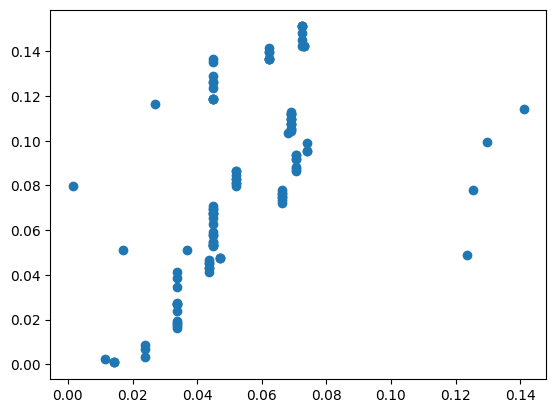

2022-08-21 05:33:32.769 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:32.770 | INFO     | __main__:apply_mean:92 - [0.014242391145483382, 0.014242391145483382, 0.014242391145483382, 0.011519347108399549, 0.02384442080615316, 0.02384442080615316, 0.02384442080615316, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.04699137103582604, 0.04699137103582604, 0.04699137103582604, 0.12350053116281678, 0.017090823765314338, 0.036794269577526684, 0.045011625611676716, 0.045011625611676716, 0.045011625611676716, 0.045011625611676716, 0.045011625611676716, 0.045011625611676716, 0.045011625611676716, 0.045011625611676716, 0

2022-08-21 05:33:32.796 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:32.799 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.801 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.011519347108399549], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090

2022-08-21 05:33:32.818 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:32.831 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.834 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.017090823

2022-08-21 05:33:32.852 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:32.857 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:32.860 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.888 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:32.891 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:32.896 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678], [0.01709082

2022-08-21 05:33:32.917 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:32.919 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:32.922 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338], [0.036794269577526684], [0.0

2022-08-21 05:33:32.950 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:32.952 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:32.954 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269577526684], [0.0899

2022-08-21 05:33:32.981 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:32.983 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:32.985 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269577526684, 0.089932

2022-08-21 05:33:33.005 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.008 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.012 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.030 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:33.032 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:33.041 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269577526684, 0.08993

2022-08-21 05:33:33.056 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.062 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:33.064 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269

2022-08-21 05:33:33.078 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.080 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:33.083 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.0367942695

2022-08-21 05:33:33.099 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.101 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.106 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765

2022-08-21 05:33:33.121 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.124 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:33.125 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269

2022-08-21 05:33:33.144 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.146 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:33.147 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.0367942695

2022-08-21 05:33:33.162 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:33.164 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:33.175 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269577526684, 0.089

2022-08-21 05:33:33.201 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.203 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.206 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.240 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:33.244 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:33.247 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.0367942695

2022-08-21 05:33:33.265 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:33.267 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:33.283 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269577526684, 0.089

2022-08-21 05:33:33.297 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.299 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:33.301 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.03679

2022-08-21 05:33:33.327 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:33.329 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:33.331 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.354 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.356 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.359 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765

2022-08-21 05:33:33.380 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.382 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.387 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765

2022-08-21 05:33:33.412 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.414 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.418 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765

2022-08-21 05:33:33.437 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.439 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.443 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765

2022-08-21 05:33:33.459 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:33.460 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.462 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765

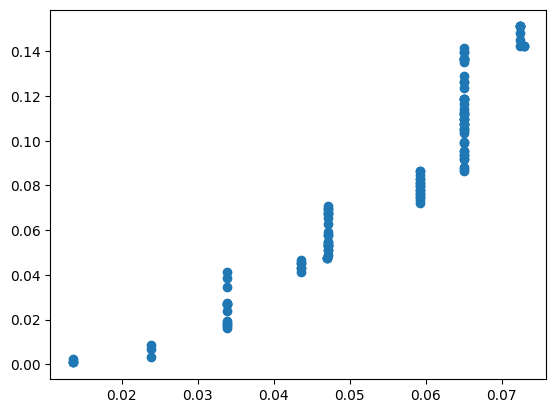

2022-08-21 05:33:33.749 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:33.751 | INFO     | __main__:apply_mean:92 - [0.013561630136212425, 0.013561630136212425, 0.013561630136212425, 0.013561630136212425, 0.02384442080615316, 0.02384442080615316, 0.02384442080615316, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.04699137103582604, 0.04699137103582604, 0.04699137103582604, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.

2022-08-21 05:33:33.782 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.784 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.789 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.814 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:33.818 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:33.823 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.860 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.862 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.865 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.892 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:33.896 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:33.907 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.935 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:33.937 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:33.940 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.0170908237

2022-08-21 05:33:33.968 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:33.970 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:33.972 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.011519347108399549, 0.01356262797619259, 0.004038751217872642, 0.025125794242384918], [0.06424009153884155, 0.005199771821048457, 0.0020933990585694623], [0.05200911697376682, 0.041733300978132964, 0.013047385186262325, 0.08482980568833494, 0.0376099765524103, 0.045953466544519955, 0.01487404982139749, 0.01583957782875249, 0.062439145719008035, 0.01978584922054619, 0.03459209372440893, 0.009436748685819332, 0.007454573851506727], [0.09505384411602627, 0.0028068942024923934, 0.011676849441346697, 0.048656261740528305, 0.02379469527374211, 0.07986504612344686], [0.04166124969892694, 0.049147411485503445, 0.050165451923047735], [0.12350053116281678, 0.017090823765314338, 0.036794269577526684, 0.08993

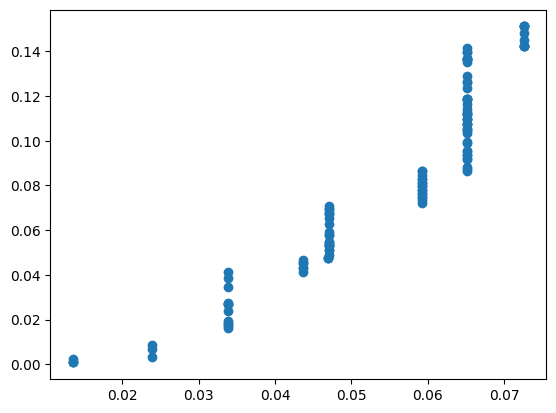

2022-08-21 05:33:34.188 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:34.189 | INFO     | __main__:apply_mean:92 - [0.013561630136212425, 0.013561630136212425, 0.013561630136212425, 0.013561630136212425, 0.02384442080615316, 0.02384442080615316, 0.02384442080615316, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.03381577621345127, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.043642265149597105, 0.04699137103582604, 0.04699137103582604, 0.04699137103582604, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.0471291629952081, 0.

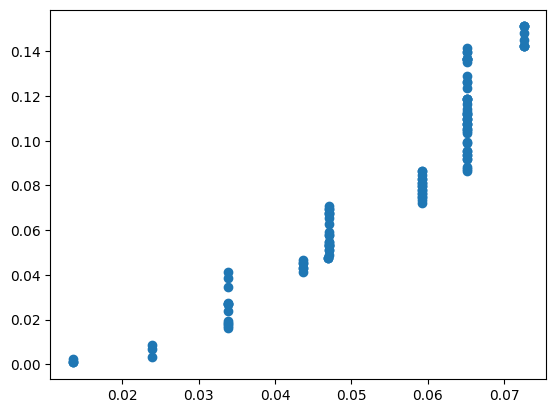

2022-08-21 05:33:34.337 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.0, 0.0, 0.010282790669940735, 0.0, 0.0, 0.00997135540729811, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.009826488936145836, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0033491058862289355, 0.0, 0.0, 0.00013779195938205813, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.012149941663959357, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.005799278617717535, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.007507251126528183, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
2022-08-21 05:33:34.380 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.381 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-s

2022-08-21 05:33:34.401 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.403 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:34.406 | INFO     | __main__:eval_direction_expand:42 - merging down at index 1 of partition [[0.8739455688051527], [0.02861959892615891], [0.2371164675189747], [0.29572031862639553], [0.006461487734421726], [0.08890925278194595], [0.06227277415446475], [0.04771956378689361], [0.046125368628922817], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.296705432

2022-08-21 05:33:34.423 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.424 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:34.427 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.02861959892615891, 0.8739455688051527], [0.2371164675189747], [0.29572031862639553], [0.006461487734421726], [0.08890925278194595], [0.06227277415446475], [0.04771956378689361], [0.046125368628922817], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.712766927775365

2022-08-21 05:33:34.455 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:34.458 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:34.461 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.02861959892615891, 0.8739455688051527], [0.2371164675189747], [0.29572031862639553, 0.006461487734421726], [0.08890925278194595], [0.06227277415446475], [0.04771956378689361], [0.046125368628922817], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.296705432262

2022-08-21 05:33:34.487 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:34.490 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:34.492 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.02861959892615891, 0.8739455688051527], [0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595], [0.06227277415446475], [0.04771956378689361], [0.046125368628922817], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.679900020947368

2022-08-21 05:33:34.509 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:34.511 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:34.514 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.06227277415446475], [0.04771956378689361], [0.046125368628922817], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.2

2022-08-21 05:33:34.544 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.546 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied


Sstar: 0.18373426997942183
Tstar: 1.0000000000000002
stress: 0.42864235672576945
Sstar: Autograd ArrayBox with value 0.4069570788882317
Tstar: 1.0000000000000002


2022-08-21 05:33:34.549 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.06227277415446475], [0.04771956378689361], [0.046125368628922817], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209473682], [0.9493392738317723], [0.4362893453681965], [0.6141944780780477], [0.1407809648285735], [0.2623314827562945], [0.6511611930357272], [0.25573838925166714], [0.3978733187921854], [

2022-08-21 05:33:34.567 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.569 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:34.573 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.06227277415446475], [0.046125368628922817, 0.04771956378689361], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [

2022-08-21 05:33:34.589 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.591 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:34.594 | INFO     | __main__:eval_direction_expand:42 - merging down at index 1 of partition [[0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.046125368628922817, 0.04771956378689361, 0.06227277415446475], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.

2022-08-21 05:33:34.610 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.611 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:34.616 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.2967054

2022-08-21 05:33:34.644 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:34.645 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:34.654 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106], [0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.67990

2022-08-21 05:33:34.676 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:34.677 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:34.680 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106, 0.03722574793443374], [0.8611679475832813], [0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226

2022-08-21 05:33:34.699 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:34.701 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:34.703 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [1.1000626600454106, 0.03722574793443374], [0.8611679475832813, 0.17457759703753306], [0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.67990

2022-08-21 05:33:34.718 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:34.720 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:34.721 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.5554263480494936], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209473682], [0.949339273

2022-08-21 05:33:34.741 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:34.743 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:34.746 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936], [0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.679900020947368

2022-08-21 05:33:34.763 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:34.765 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:34.768 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183], [0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209473682],

2022-08-21 05:33:34.782 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:34.784 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:34.786 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667], [0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209473682], [

2022-08-21 05:33:34.803 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:34.804 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:34.808 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [2.725790765893684], [0.3836006012658953], [0.1123381871747483], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6

2022-08-21 05:33:34.822 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:34.824 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:34.826 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [2.725790765893684], [0.1123381871747483, 0.3836006012658953], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209473682], [0.9493392738317723],

2022-08-21 05:33:34.851 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:34.853 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:34.854 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684], [0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209473682], [0.9493392738317723], [

2022-08-21 05:33:34.880 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:34.882 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:34.884 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354], [0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799

2022-08-21 05:33:34.905 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:34.908 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:34.912 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509], [0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000

2022-08-21 05:33:34.927 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:34.930 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:34.933 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499], [0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.679900020

2022-08-21 05:33:34.946 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:34.948 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:34.950 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209

2022-08-21 05:33:34.974 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:34.976 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:34.982 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [0.6859889726532383], [0.7127669277753651], [0.29670543226261237], [1.6799000209473682], [0.94933927

2022-08-21 05:33:35.003 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.007 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:35.009 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [0.6859889726532383], [0.29670543226261237, 0.7127669277753651], [1.6799000209473682], [0.9493392738

2022-08-21 05:33:35.028 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.030 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:35.035 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [0.29670543226261237, 0.7127669277753651, 0.6859889726532383], [1.6799000209473682], [0.949339273831

2022-08-21 05:33:35.053 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.055 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.058 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [1.6799000209473682],

2022-08-21 05:33:35.075 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.077 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:35.080 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [1.6799000209473682], [0.9493392738317

2022-08-21 05:33:35.104 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:35.108 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:35.114 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [1.6799000209473682], [0.9493392738317723], [0.6141944780780

2022-08-21 05:33:35.132 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.135 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:35.138 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [1.6799000209473682],

2022-08-21 05:33:35.155 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.157 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:35.160 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [0.6141944780780477, 0.1407809648285735, 0.

2022-08-21 05:33:35.192 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.194 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:35.197 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2.725790765893684, 0.33656091794076354, 0.08868922931328509, 0.592319284014499, 0.4761513671671771], [0.6141944780780477, 0.1407809648285735, 0.

2022-08-21 05:33:35.213 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:35.221 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:35.223 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953

2022-08-21 05:33:35.238 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.240 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.242 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383

2022-08-21 05:33:35.262 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.264 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:35.281 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.283 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.286 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:35.301 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.302 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.305 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:35.320 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.323 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.326 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:35.351 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.353 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.372 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 

2022-08-21 05:33:35.392 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.394 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.397 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 

2022-08-21 05:33:35.413 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.416 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 

2022-08-21 05:33:35.445 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.447 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.454 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 

2022-08-21 05:33:35.478 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.480 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.483 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:35.500 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.502 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.505 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:35.527 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.529 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.537 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:35.559 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.561 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.564 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:35.581 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.583 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:35.594 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0

2022-08-21 05:33:35.613 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:35.615 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:35.617 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953

2022-08-21 05:33:35.643 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.645 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.647 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:35.664 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.666 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.669 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 

2022-08-21 05:33:35.692 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.693 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:35.695 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 

2022-08-21 05:33:35.719 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:35.720 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:35.721 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:35.744 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.746 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:35.749 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:35.766 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.768 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:35.770 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.

2022-08-21 05:33:35.789 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.790 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:35.793 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483

2022-08-21 05:33:35.811 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.815 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:35.818 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483

2022-08-21 05:33:35.833 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:35.835 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:35.839 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:35.852 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.853 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:35.856 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0

2022-08-21 05:33:35.869 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:35.871 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:35.874 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:35.898 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:35.899 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:35.900 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953,

2022-08-21 05:33:35.917 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:35.919 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:35.923 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:35.942 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.944 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:35.947 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.

2022-08-21 05:33:35.963 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:35.970 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:35.974 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.

2022-08-21 05:33:36.002 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.003 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.005 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:36.024 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.027 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.029 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:36.048 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:36.050 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.053 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.

2022-08-21 05:33:36.070 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.072 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.075 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:36.092 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.095 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.097 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2

2022-08-21 05:33:36.116 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.118 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.120 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2

2022-08-21 05:33:36.142 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.145 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.148 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2

2022-08-21 05:33:36.164 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.173 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:36.183 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0

2022-08-21 05:33:36.206 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.208 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:36.211 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.

2022-08-21 05:33:36.241 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.252 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:36.255 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.

2022-08-21 05:33:36.281 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:36.283 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.284 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953

2022-08-21 05:33:36.302 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.304 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:36.313 | INFO     | __main__:eval_direction_expand:42 - merging down at index 20 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.112338187174748

2022-08-21 05:33:36.335 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.337 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.339 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:36.361 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.363 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.368 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 

2022-08-21 05:33:36.389 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:36.393 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:36.396 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483

2022-08-21 05:33:36.417 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:36.427 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:36.429 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:36.447 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.449 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:36.452 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.112338187174748

2022-08-21 05:33:36.467 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.468 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.471 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:36.488 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.491 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.493 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:36.511 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.512 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.514 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:36.533 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.535 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.537 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2

2022-08-21 05:33:36.553 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.556 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.558 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2

2022-08-21 05:33:36.577 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.580 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.582 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:36.613 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:36.618 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.620 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:36.636 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.638 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:36.641 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0

2022-08-21 05:33:36.658 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.660 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:36.663 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.

2022-08-21 05:33:36.690 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.692 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:36.713 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.

2022-08-21 05:33:36.736 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.737 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.741 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:36.757 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.759 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:36.761 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.112338187174748

2022-08-21 05:33:36.779 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:36.781 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:36.784 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:36.800 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:36.802 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:36.804 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953,

2022-08-21 05:33:36.822 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:36.825 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:36.840 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383,

2022-08-21 05:33:36.863 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.865 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.873 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:36.915 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.918 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.925 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:36.962 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:36.965 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:36.970 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.002 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.005 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.010 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.045 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.047 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.052 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.084 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.086 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.089 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.122 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.124 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.129 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.157 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.160 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.174 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.198 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.209 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.212 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.248 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.255 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.259 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.277 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.280 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.284 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.303 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.305 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.308 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.333 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.335 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.338 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.356 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.358 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.365 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.407 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.411 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.417 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.452 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.456 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.461 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.500 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.504 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.510 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.543 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.546 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.549 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.587 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.589 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.593 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.629 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.632 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.636 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.658 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.660 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.663 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.680 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.683 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.686 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.705 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.706 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.709 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.743 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.744 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.750 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.769 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.771 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.789 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.791 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.801 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.819 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.827 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.830 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.845 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.847 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.851 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.869 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.870 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.873 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:37.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:37.909 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:37.912 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

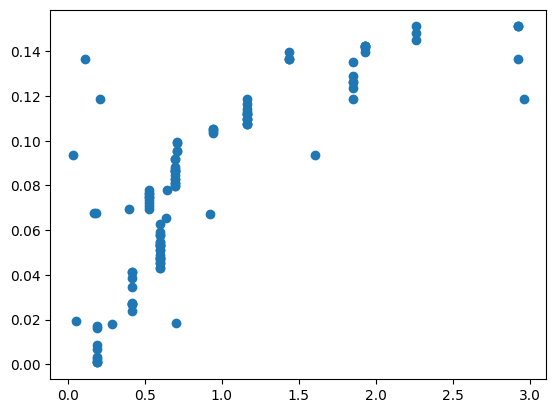

2022-08-21 05:33:38.197 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:38.199 | INFO     | __main__:apply_mean:92 - [0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.28852142401255587, 0.6999015297311846, 0.05370820332889653, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.59897686181754, 0.6377311635420173, 0.9221289688623115, 0.1

2022-08-21 05:33:38.222 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.225 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:38.228 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846], [0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0

2022-08-21 05:33:38.245 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:38.248 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:38.252 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 2.

2022-08-21 05:33:38.276 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.278 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:38.281 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:38.330 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:38.333 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:38.337 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1

2022-08-21 05:33:38.368 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.377 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:38.379 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.38

2022-08-21 05:33:38.400 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:38.402 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:38.405 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 0.3836006012658953, 

2022-08-21 05:33:38.432 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.434 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:38.437 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0.7127669277753651, 0.6859889726532383, 0.1123381871747483, 

2022-08-21 05:33:38.455 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:38.458 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:38.460 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 

2022-08-21 05:33:38.478 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:38.495 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:38.497 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 0

2022-08-21 05:33:38.518 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.520 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:38.523 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.2

2022-08-21 05:33:38.539 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:38.541 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:38.544 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29

2022-08-21 05:33:38.558 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:38.559 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:38.561 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.255

2022-08-21 05:33:38.584 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.586 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:38.589 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.2

2022-08-21 05:33:38.605 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:38.606 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:38.608 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 

2022-08-21 05:33:38.630 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.632 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:38.635 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.2

2022-08-21 05:33:38.652 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:38.654 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:38.657 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.29670543226261237, 

2022-08-21 05:33:38.684 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:38.704 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:38.708 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.25573838925166714, 0.

2022-08-21 05:33:38.725 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:38.729 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:38.731 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.255

2022-08-21 05:33:38.766 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:38.768 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:38.771 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.046125368628922817, 0.04771956378689361, 0.06227277415446475, 0.29572031862639553, 0.006461487734421726, 0.2371164675189747, 0.08890925278194595, 0.02861959892615891, 0.8739455688051527], [0.28852142401255587], [0.6999015297311846, 0.05370820332889653], [0.8611679475832813, 0.17457759703753306, 1.1000626600454106, 0.03722574793443374, 0.42173395516085643, 0.5554263480494936, 0.20997891444271183, 0.375346553591667, 0.009174481669250183], [0.9221289688623115, 0.18087231192102007, 0.6377311635420173, 0.17009715508129894, 0.6141944780780477, 0.1407809648285735, 0.4362893453681965, 0.2623314827562945, 0.9493392738317723, 1.6799000209473682, 0.6511611930357272, 0.255

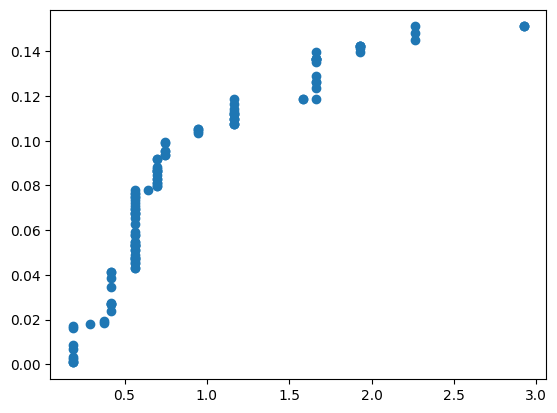

2022-08-21 05:33:39.022 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:39.023 | INFO     | __main__:apply_mean:92 - [0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.18743226677370342, 0.28852142401255587, 0.3768048665300405, 0.3768048665300405, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.41607713394607093, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.5615075743082777, 0.

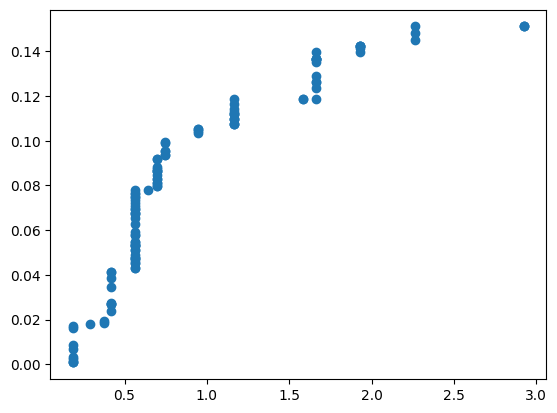

2022-08-21 05:33:39.297 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.10108915723885245, 0.08828344251748466, 0.0, 0.039272267416030404, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.14543044036220676, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08123703826764272, 0.05481674082494781, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.04846242590618666, 0.0, 0.0, 0.0, 0.0, 0.0, 0.19827320328397902, 0.0, 0.0, 0.0, 0.2214180333636251, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.42048948558294863, 0.0, 0.07358500437821536, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2710477350694893, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3313293272824611, 0.0, 0.0, 0.662394671912995, 0.0, 0.0]
2022-08-21 05:33:39.382 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 0

2022-08-21 05:33:39.424 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.427 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:39.432 | INFO     | __main__:eval_direction_expand:42 - merging down at index 1 of partition [[0.8739063823044063], [0.028618959224724187], [0.23710030524804176], [0.29571340142519204], [0.006461278196092824], [0.08890641404013244], [0.06227154811590891], [0.04771849699860457], [0.04612441458258764], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.296

2022-08-21 05:33:39.458 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.461 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:39.469 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.028618959224724187, 0.8739063823044063], [0.23710030524804176], [0.29571340142519204], [0.006461278196092824], [0.08890641404013244], [0.06227154811590891], [0.04771849699860457], [0.04612441458258764], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.712750705

2022-08-21 05:33:39.496 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:39.504 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:39.507 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.028618959224724187, 0.8739063823044063], [0.23710030524804176], [0.29571340142519204, 0.006461278196092824], [0.08890641404013244], [0.06227154811590891], [0.04771849699860457], [0.04612441458258764], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.296691

Sstar: 124.16505021803502
Tstar: 1.0000000000000002
stress: 11.142937234770507
Sstar: Autograd ArrayBox with value 201.234557779862
Tstar: 1.0000000000000002


2022-08-21 05:33:39.518 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:39.521 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:39.532 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.028618959224724187, 0.8739063823044063], [0.29571340142519204, 0.006461278196092824, 0.23710030524804176], [0.08890641404013244], [0.06227154811590891], [0.04771849699860457], [0.04612441458258764], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.296691132432

2022-08-21 05:33:39.558 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:39.561 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:39.562 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.06227154811590891], [0.04771849699860457], [0.04612441458258764], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347

2022-08-21 05:33:39.581 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:39.583 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:39.586 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.06227154811590891], [0.04771849699860457], [0.04612441458258764], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994]

2022-08-21 05:33:39.604 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.606 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:39.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.06227154811590891], [0.04612441458258764, 0.04771849699860457], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [

2022-08-21 05:33:39.643 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.645 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:39.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.04612441458258764, 0.04771849699860457, 0.06227154811590891], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.

2022-08-21 05:33:39.670 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.671 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:39.674 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.29

2022-08-21 05:33:39.691 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.694 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:39.696 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881], [0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2

2022-08-21 05:33:39.714 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:39.716 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:39.718 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881, 0.03722456290270548], [0.8611356754853141], [0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2

2022-08-21 05:33:39.754 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:39.763 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:39.765 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [1.1000046698335881, 0.03722456290270548], [0.8611356754853141, 0.17457400274313728], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347457117], [0.

2022-08-21 05:33:39.790 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:39.796 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:39.799 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.5553998489372756], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548], [0.4217174417703031], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.679821

2022-08-21 05:33:39.819 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:39.821 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:39.823 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756], [0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347457117], [0.9492

2022-08-21 05:33:39.847 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:39.849 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:39.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733], [0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.29669113243

2022-08-21 05:33:39.872 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:39.874 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:39.877 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424], [0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.29669113243281

2022-08-21 05:33:39.904 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:39.915 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:39.918 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148

2022-08-21 05:33:39.937 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.939 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:39.941 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [2.7255689014994755], [0.3835909497017753], [0.11233577815273557], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347457

2022-08-21 05:33:39.956 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:39.959 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:39.962 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [2.7255689014994755], [0.11233577815273557, 0.3835909497017753], [0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.679821834745711

2022-08-21 05:33:39.988 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:39.991 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:39.993 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857], [0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347457117], [0.9492915777933352],

2022-08-21 05:33:40.009 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.011 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.013 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632], [0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347457117], [0.9492915777933352], [0

2022-08-21 05:33:40.031 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.036 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.039 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398], [0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347457117], [0.9492915777933352], [0.4

2022-08-21 05:33:40.055 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.057 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.061 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218347457117], [0.9492915777933352], [0.43

2022-08-21 05:33:40.076 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.078 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.081 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [0.6859600190385524], [0.7127507059497994], [0.2966911324328148], [1.6798218

2022-08-21 05:33:40.097 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:40.100 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.103 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [0.6859600190385524], [0.2966911324328148, 0.7127507059497994], [1.6798218347

2022-08-21 05:33:40.118 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:40.120 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.123 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524], [1.679821834745

2022-08-21 05:33:40.141 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:40.143 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.148 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [1.67982183474571

2022-08-21 05:33:40.180 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.181 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.204 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [1.6798218347457117], [0.9492915777933352], [0.43626495

2022-08-21 05:33:40.220 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.223 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:40.225 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [1.6798218347457117], [0.949291577793

2022-08-21 05:33:40.245 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:40.246 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.248 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [1.6798218347457117], [0.6141793513705839, 0.14077750

2022-08-21 05:33:40.264 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:40.265 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [0.6141793513705839, 0.1407775083827378, 0.43626495542

2022-08-21 05:33:40.284 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.286 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:40.288 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [0.61417935137

2022-08-21 05:33:40.311 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:40.313 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:40.316 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753, 2.7255689014994755, 0.33654100818191857, 0.08868674468812632, 0.5922936104756398, 0.47612354573703664], [0.6141793513705839, 0.14077750838

2022-08-21 05:33:40.333 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.335 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.337 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.38359094970177

2022-08-21 05:33:40.352 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.355 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.356 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:40.375 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.377 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.379 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:40.396 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.398 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.400 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:40.417 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.419 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.423 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:40.463 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.464 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.465 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753

2022-08-21 05:33:40.489 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.503 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.505 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753

2022-08-21 05:33:40.535 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.538 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.542 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753

2022-08-21 05:33:40.579 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.581 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.584 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753

2022-08-21 05:33:40.604 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.606 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:40.641 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.643 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.645 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:40.671 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.674 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.676 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:40.700 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.703 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.706 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:40.726 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:40.728 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:40.733 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:40.756 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.758 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:40.760 | INFO     | __main__:eval_direction_expand:42 - merging down at index 14 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.1123357781527

2022-08-21 05:33:40.776 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.778 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.781 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:40.801 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.815 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.817 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753

2022-08-21 05:33:40.841 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:40.842 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.845 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753

2022-08-21 05:33:40.865 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.867 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:40.869 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557

2022-08-21 05:33:40.886 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:40.888 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.891 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017

2022-08-21 05:33:40.923 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:40.925 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:40.931 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.38359094970177

2022-08-21 05:33:40.949 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:40.952 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.955 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:40.978 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:40.981 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:40.984 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 

2022-08-21 05:33:41.001 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:41.003 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.006 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557,

2022-08-21 05:33:41.035 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.037 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.039 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017

2022-08-21 05:33:41.056 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.059 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:41.062 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.685960019038552

2022-08-21 05:33:41.084 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:41.103 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:41.105 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273

2022-08-21 05:33:41.126 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:41.130 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:41.133 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:41.156 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.157 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.159 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.38359094970177

2022-08-21 05:33:41.176 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.185 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.186 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.38359094970177

2022-08-21 05:33:41.206 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.208 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.211 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557

2022-08-21 05:33:41.230 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.231 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.233 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017

2022-08-21 05:33:41.252 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.254 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.255 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.38359094970177

2022-08-21 05:33:41.294 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.298 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.302 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557

2022-08-21 05:33:41.323 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.326 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.329 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557,

2022-08-21 05:33:41.355 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.357 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.367 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557,

2022-08-21 05:33:41.391 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.393 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.396 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557,

2022-08-21 05:33:41.413 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.416 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:41.419 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:41.438 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.440 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:41.443 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.685960019038552

2022-08-21 05:33:41.459 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.460 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:41.463 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524

2022-08-21 05:33:41.476 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.480 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:41.485 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273

2022-08-21 05:33:41.500 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:41.502 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.504 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:41.539 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.541 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.553 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557

2022-08-21 05:33:41.583 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.586 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.588 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017

2022-08-21 05:33:41.607 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.609 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:41.621 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:41.641 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:41.653 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:41.657 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 

2022-08-21 05:33:41.690 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:41.693 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.706 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:41.735 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.737 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.743 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557

2022-08-21 05:33:41.761 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.763 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.765 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017

2022-08-21 05:33:41.783 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.785 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.787 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557

2022-08-21 05:33:41.802 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.805 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.808 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557,

2022-08-21 05:33:41.823 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.825 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.828 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557,

2022-08-21 05:33:41.868 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.869 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:41.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:41.892 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.894 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:41.898 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557

2022-08-21 05:33:41.918 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:41.920 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:41.929 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017

2022-08-21 05:33:41.946 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:41.948 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:41.952 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.685960019038552

2022-08-21 05:33:41.972 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:41.974 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:41.978 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524

2022-08-21 05:33:41.998 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.001 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:42.012 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524

2022-08-21 05:33:42.037 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:42.041 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:42.051 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:42.072 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:42.074 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.077 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:42.109 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:42.111 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:42.114 | INFO     | __main__:eval_direction_expand:42 - merging down at index 28 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273

2022-08-21 05:33:42.134 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:42.136 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:42.138 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:42.175 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.178 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.182 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.220 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.223 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.229 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.256 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.259 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.266 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.308 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.310 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.312 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.338 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.343 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.347 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.370 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.372 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.374 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.395 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.397 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.401 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.415 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.417 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.422 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.437 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.438 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.440 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.465 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.466 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.469 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.489 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.491 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.494 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.526 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.529 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.532 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.549 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.551 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.554 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.572 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.574 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.577 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.599 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.600 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.607 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.626 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.628 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.631 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.664 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.666 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.670 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.691 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.693 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.695 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.720 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.722 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.724 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.741 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.744 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.780 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.783 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.787 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.823 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.826 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.831 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.859 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.862 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.867 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.891 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.896 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.902 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.959 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.961 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:42.966 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:42.995 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:42.998 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.001 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:43.020 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:43.029 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.031 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:43.050 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:43.052 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:43.077 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:43.080 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.084 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:43.116 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:43.126 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.130 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:43.159 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:43.188 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.191 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

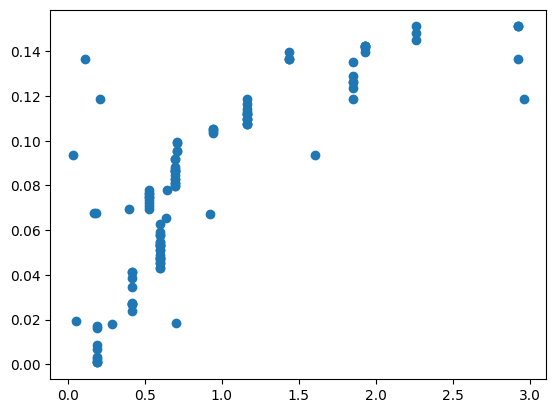

2022-08-21 05:33:43.476 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:43.477 | INFO     | __main__:apply_mean:92 - [0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.28851534778101834, 0.699864684072379, 0.053706314601207714, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.5989463458978157, 0.63770972

2022-08-21 05:33:43.496 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:43.504 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.507 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379], [0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524,

2022-08-21 05:33:43.526 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:43.536 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:43.538 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.3835909497017753,

2022-08-21 05:33:43.555 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:43.558 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.561 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:43.582 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:43.585 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:43.593 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0

2022-08-21 05:33:43.619 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:43.623 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:43.626 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0

2022-08-21 05:33:43.644 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:43.646 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:43.653 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.11233577815273557, 0.383590949701775

2022-08-21 05:33:43.668 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:43.670 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:43.674 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148, 0.7127507059497994, 0.6859600190385524, 0.1123357781527355

2022-08-21 05:33:43.691 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:43.694 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:43.695 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148

2022-08-21 05:33:43.713 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:43.720 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:43.722 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148,

2022-08-21 05:33:43.747 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:43.749 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:43.752 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 

2022-08-21 05:33:43.795 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:43.799 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:43.804 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0

2022-08-21 05:33:43.826 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:43.830 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.835 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0

2022-08-21 05:33:43.874 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:43.877 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.882 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948,

2022-08-21 05:33:43.912 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:43.915 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:43.920 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148

2022-08-21 05:33:43.971 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:43.974 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:43.997 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948,

2022-08-21 05:33:44.017 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:44.019 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:44.021 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776, 0.2966911324328148

2022-08-21 05:33:44.040 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:44.043 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:44.046 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0.2557233105025776,

2022-08-21 05:33:44.068 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:44.070 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:44.072 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0

2022-08-21 05:33:44.086 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:44.088 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:44.090 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.04612441458258764, 0.04771849699860457, 0.06227154811590891, 0.29571340142519204, 0.006461278196092824, 0.23710030524804176, 0.08890641404013244, 0.028618959224724187, 0.8739063823044063], [0.28851534778101834], [0.699864684072379, 0.053706314601207714], [0.8611356754853141, 0.17457400274313728, 1.1000046698335881, 0.03722456290270548, 0.4217174417703031, 0.5553998489372756, 0.20996644751811733, 0.37533639865082424, 0.009174101404138154], [0.9220772327388909, 0.18086846560576833, 0.6377097202134586, 0.17009309523044525, 0.6141793513705839, 0.1407775083827378, 0.43626495542685795, 0.26232138323535964, 0.9492915777933352, 1.6798218347457117, 0.6511411662112948, 0

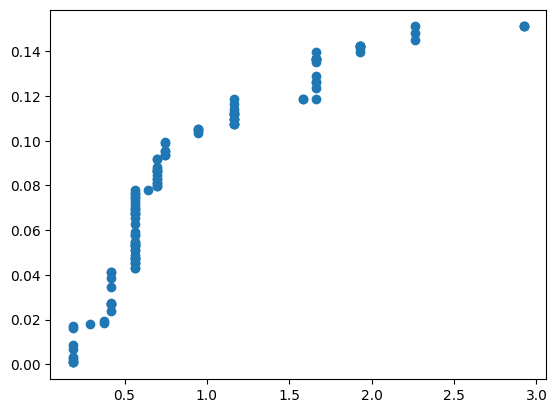

2022-08-21 05:33:44.328 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:44.330 | INFO     | __main__:apply_mean:92 - [0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.18742457779285454, 0.28851534778101834, 0.37678549933679334, 0.37678549933679334, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.4160592388050448, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804399828802, 0.5614804

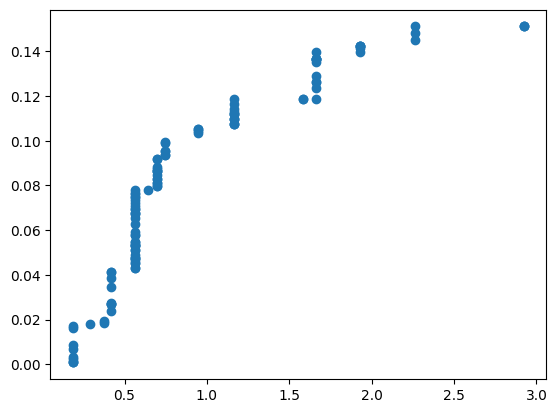

2022-08-21 05:33:44.575 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1010907699881638, 0.088270151555775, 0.0, 0.03927373946825147, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.1454212011778354, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.08124734863754146, 0.05480054948916391, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.04846543961608274, 0.0, 0.0, 0.0, 0.0, 0.0, 0.19825027861105826, 0.0, 0.0, 0.0, 0.22140247764383736, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.42047390321936673, 0.0, 0.07355513346031906, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.2710204899072115, 0.0, 0.0, 0.0, 0.0, 0.0, 0.3313290174004584, 0.0, 0.0, 0.6623134445217844, 0.0, 0.0]


Sstar: 124.1476621840737
Tstar: 1.0000000000000002
stress: 11.142156980767847
Sstar: Autograd ArrayBox with value 201.20587563548622
Tstar: 1.0000000000000002


In [55]:
# training loop
old_stress = 1e6
diff = 1e3 
alpha = 0.8
loop_config = deepcopy(start_config)
start_grad = np.ravel(start_config)
start_grad /= np.linalg.norm(start_grad)
old_stress = 1
iteration = 0
stress_vec = []
while diff > 1e-2:
    pwds = get_pairwise_distances(loop_config)
    
    # monotone regression
    mpwds = MonoReg(pred_dis = pwds, true_dis = dissimilarity_vec).run_monoreg()
    # end monotone regression
    iter_stress = stress(dissimilarity_vec, mpwds)
    print(f"stress: {iter_stress}")
    stress_grad = gradiente(loop_config)
    grad_mag = np.linalg.norm(stress_grad)
    af = angle_factor(start_grad,stress_grad)
    good_luck = min(1, iter_stress/old_stress)
    five_iter = 1 if iteration < 5 else min(1, iter_stress/stress_vec[iteration-5])
    alpha = af*good_luck*five_iter
    loop_config += -1.*alpha*stress_grad*(1./grad_mag)
    diff = abs(old_stress - iter_stress)
    old_stress = iter_stress
    stress_vec.append(iter_stress)
    iteration += 1
    start_grad = stress_grad

    

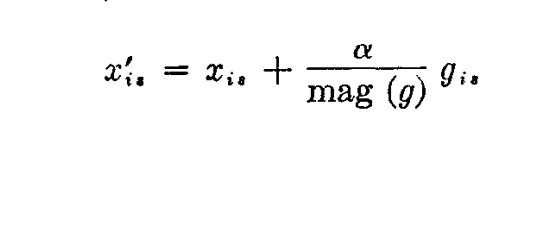

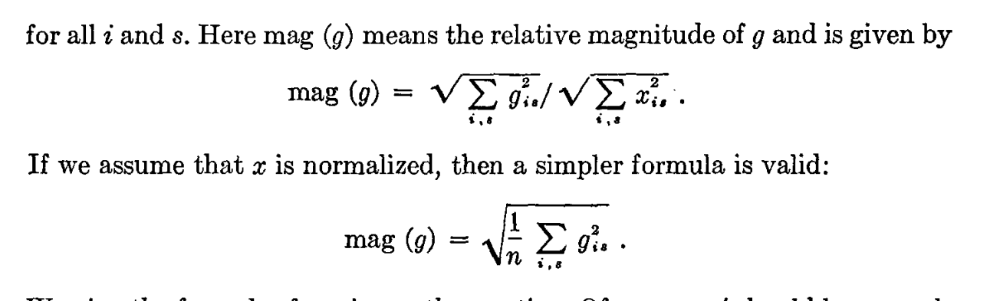

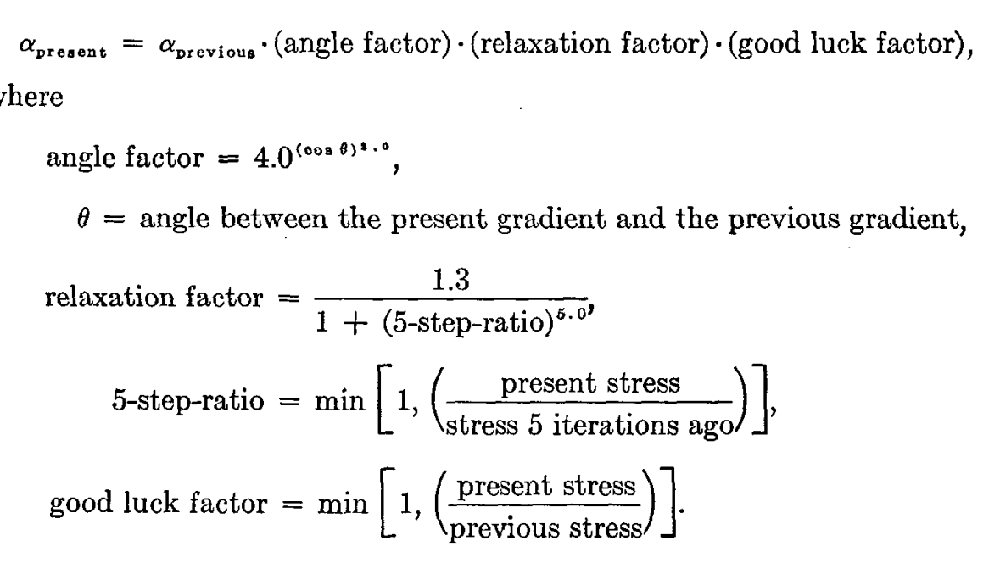

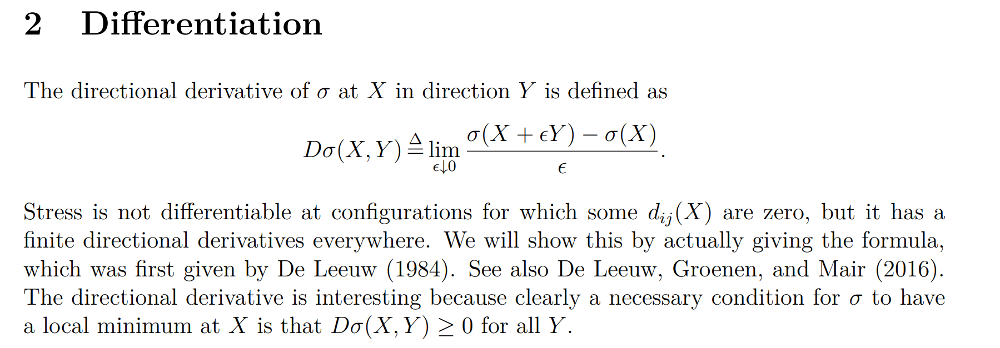
From https://jansweb.netlify.app/publication/deleeuw-e-18-c/

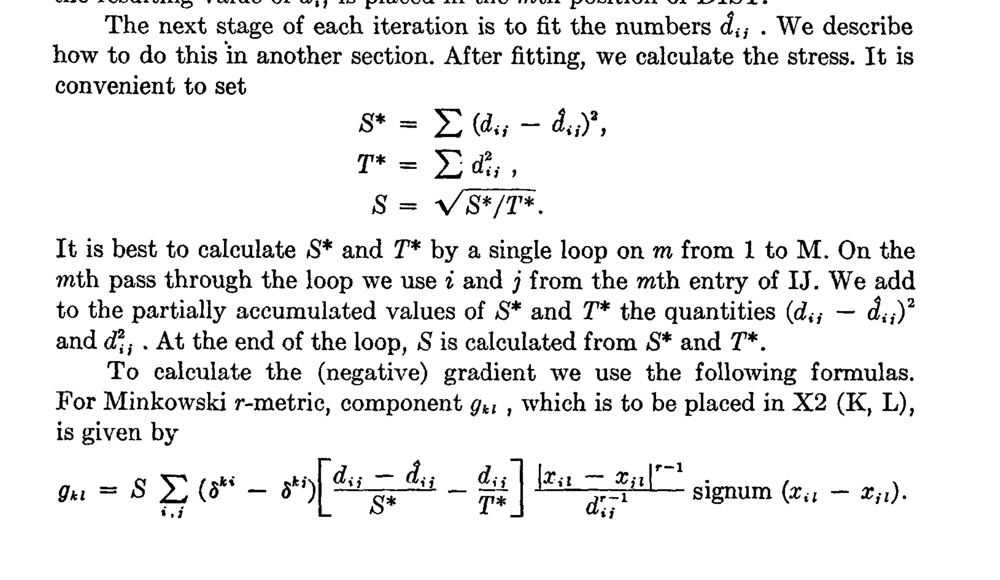
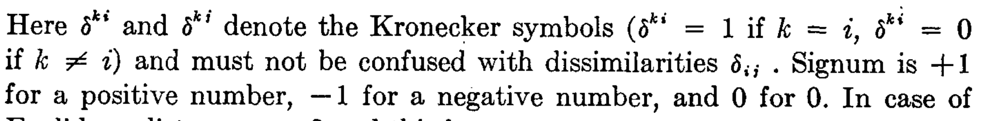
From Kruskal, 1964

In [56]:
from sklearn.utils import check_random_state

# Unused but required import for doing 3d projections with matplotlib < 3.2
import mpl_toolkits.mplot3d  # noqa: F401
import warnings

# Variables for manifold learning.
n_neighbors = 10
n_samples = 1000

# Create our sphere.
random_state = check_random_state(0)
p = random_state.rand(n_samples) * (2 * np.pi - 0.55)

t= random_state.rand(n_samples) * np.pi

indices = (t < (np.pi - (np.pi / 8))) & (t > ((np.pi / 8)))
colors = p[indices]
x, y, z = (
    np.sin(t[indices]) * np.cos(p[indices]),
    np.sin(t[indices]) * np.sin(p[indices]),
    np.cos(t[indices]),
)
sphere_data = np.array([x, y, z]).T


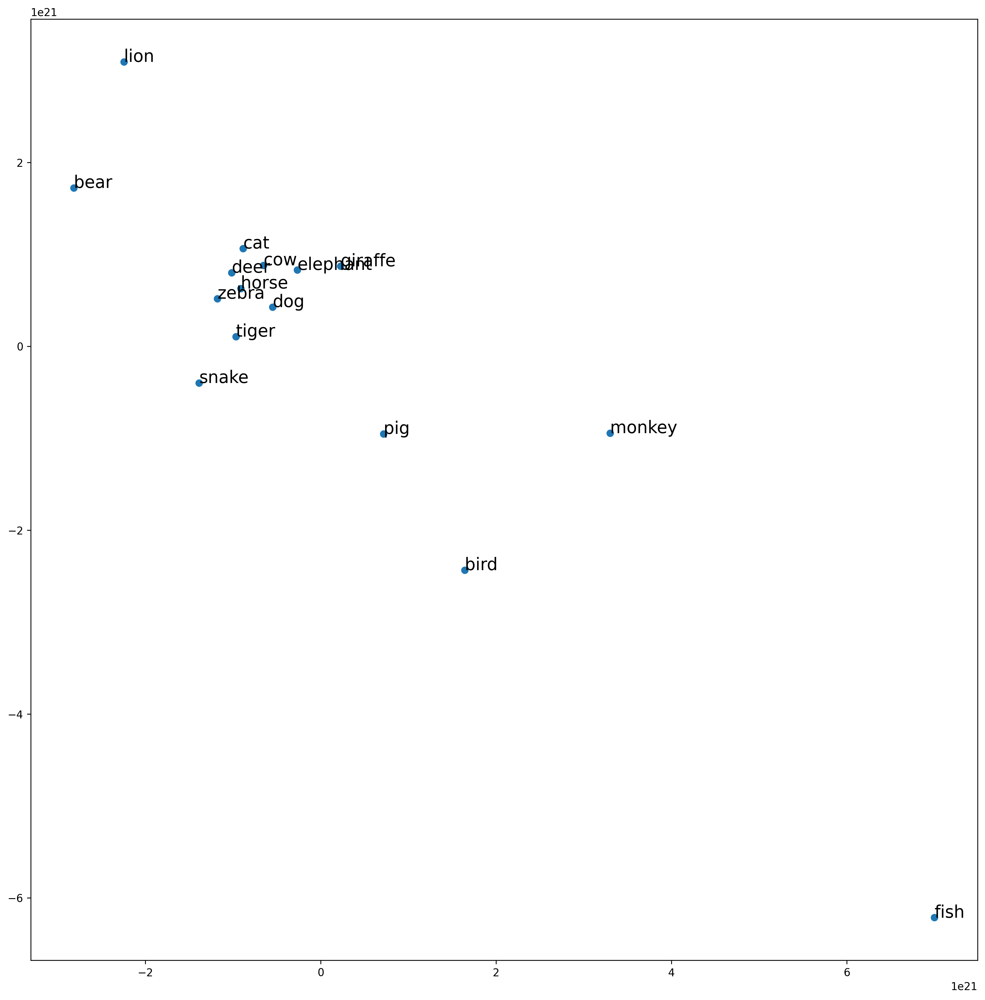

In [57]:
fig, ax = plt.subplots(figsize=(16,16), dpi=300)
ax.scatter(x=loop_config[:,0], y=loop_config[:,1])
for i, label in enumerate(big_matrix.index.to_list()):
       ax.annotate(label, (loop_config[i,0], loop_config[i,1]), fontsize=16)

# ax.set_yscale('log')
# ax.set_xscale('log')
plt.show()

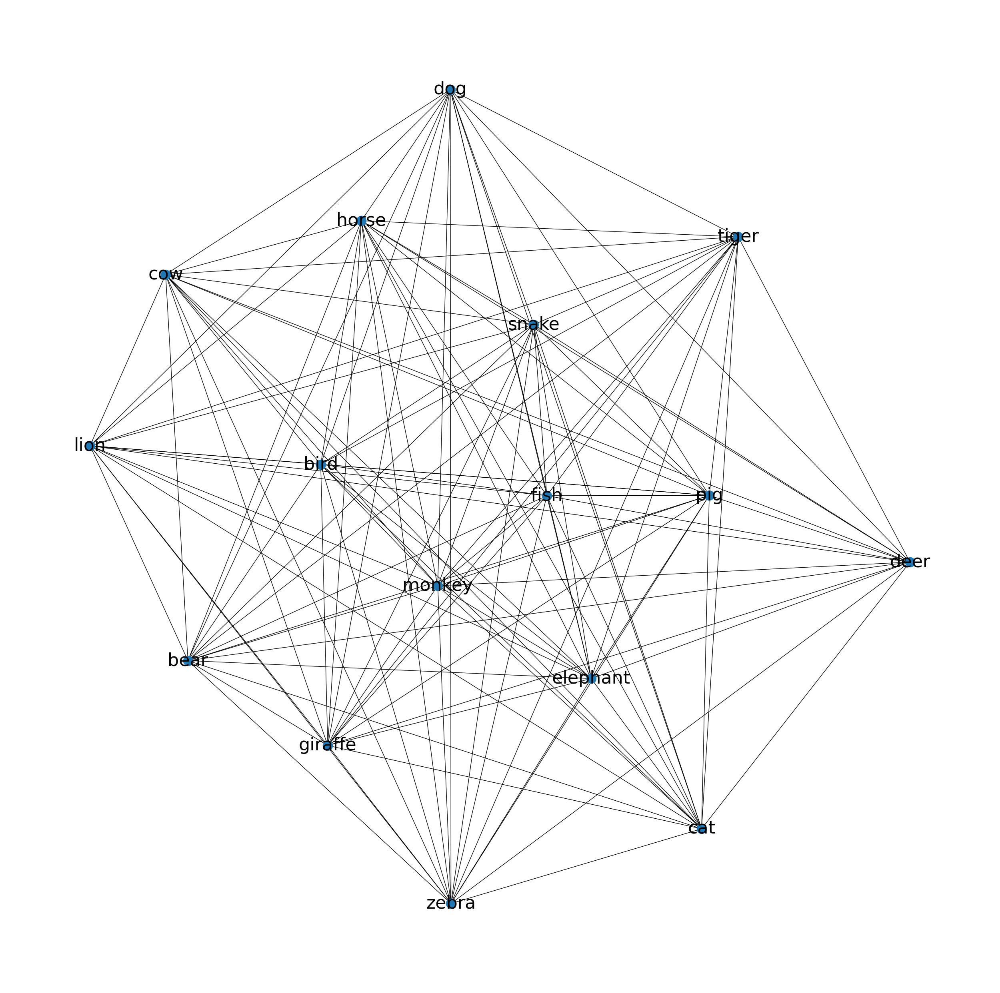

In [58]:
fig, ax = plt.subplots(figsize=(32,32))
nx.draw(animal_pairs.subgraph(big_matrix.index.to_list()), with_labels=True, ax=ax, font_size=32,
       pos=nx.spring_layout(animal_pairs.subgraph(big_matrix.index.to_list())))

plt.show()

In [59]:
from sklearn.manifold import MDS

In [60]:
refMDS = MDS(dissimilarity="precomputed",metric=False,)

In [61]:
dissimilarity_mat = np.exp(-1*np.nan_to_num(similarities)) - np.eye(similarities.shape[0])

In [62]:
plt.matshow(dissimilarity_mat)

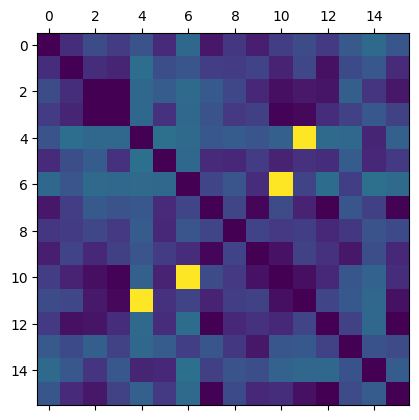

In [63]:
plt.show()

In [64]:
new_config = refMDS.fit_transform(dissimilarity_mat)

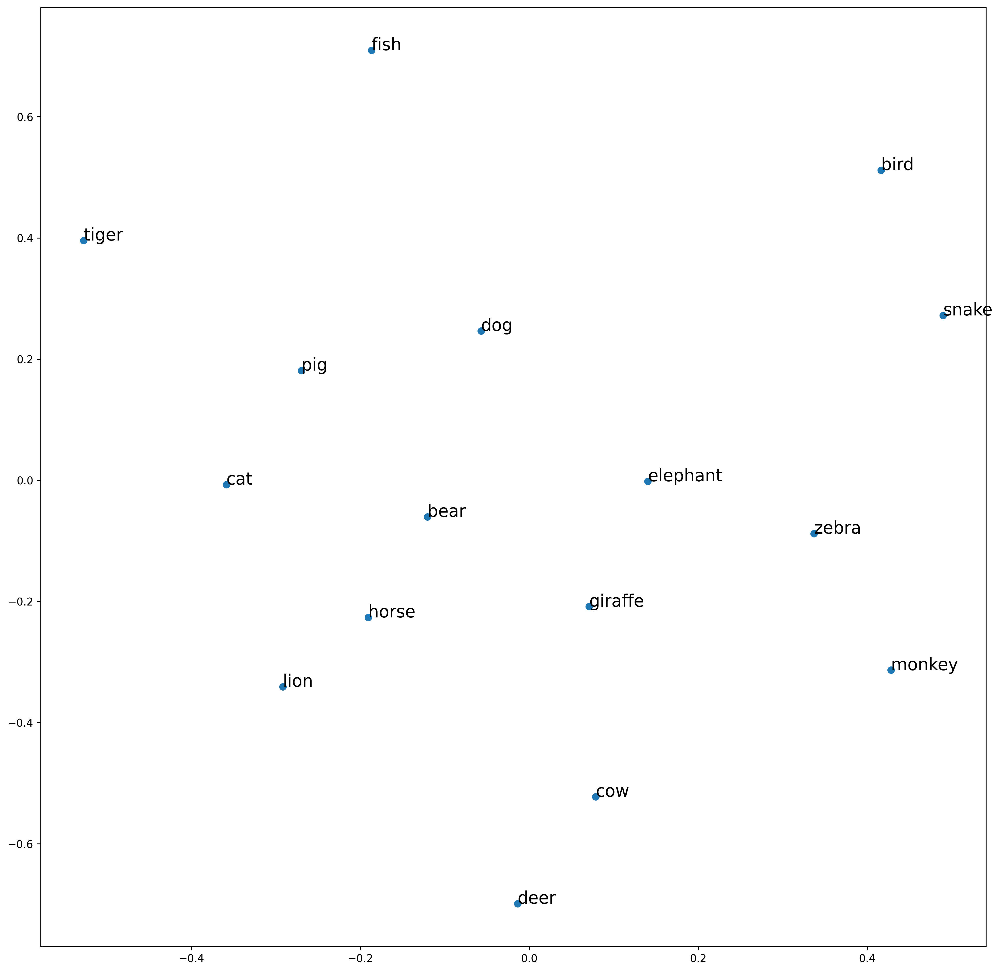

In [65]:
fig, ax = plt.subplots(figsize=(16,16), dpi=300)
ax.scatter(x=new_config[:,0], y=new_config[:,1])
for i, label in enumerate(big_matrix.index.to_list()):
       ax.annotate(label, (new_config[i,0], new_config[i,1]), fontsize=16)

# ax.set_yscale('log')
# ax.set_xscale('log')
plt.show()

In [66]:
import numpy as np

from matplotlib import pyplot as plt
from matplotlib.collections import LineCollection

from sklearn import manifold
from sklearn.metrics import euclidean_distances
from sklearn.decomposition import PCA

EPSILON = np.finfo(np.float32).eps
n_samples = 20
seed = np.random.RandomState(seed=3)
X_true = seed.randint(0, 20, 2 * n_samples).astype(float)
X_true = X_true.reshape((n_samples, 2))
# Center the data
X_true -= X_true.mean()

similarities = euclidean_distances(X_true)

# Add noise to the similarities
noise = np.random.rand(n_samples, n_samples)
noise = noise + noise.T
noise[np.arange(noise.shape[0]), np.arange(noise.shape[0])] = 0
similarities += noise
nmds = manifold.MDS(
    n_components=2,
    metric=False,
    max_iter=3000,
    eps=1e-12,
    dissimilarity="precomputed",
    random_state=seed,
    n_jobs=1,
    n_init=100,
)
npos = nmds.fit_transform(similarities)


In [67]:
similarity_vec = np.tril(similarities, -1)
similarity_vec = similarity_vec[np.nonzero(similarity_vec)]
dissimilarities = np.exp(-1*similarity_vec)
dissimilarities/= np.linalg.norm(dissimilarities)

2022-08-21 05:33:53.161 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:53.163 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:53.170 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.037828158879762666], [0.07550887428269994], [0.03214730601318545], [0.04944439790697727], [0.027905769639306355], [0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136

2022-08-21 05:33:53.201 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:53.209 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:53.219 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.037828158879762666], [0.07550887428269994], [0.03214730601318545], [0.04944439790697727], [0.027905769639306355], [0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.0430813

2022-08-21 05:33:53.245 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:53.248 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.257 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.037828158879762666], [0.07550887428269994], [0.03214730601318545], [0.04944439790697727], [0.027905769639306355], [0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.01554

2022-08-21 05:33:53.269 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:53.272 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.278 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.037828158879762666], [0.07550887428269994, 0.03214730601318545], [0.04944439790697727], [0.027905769639306355], [0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.0430813

2022-08-21 05:33:53.294 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.297 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.300 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.037828158879762666], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727], [0.027905769639306355], [0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.0204

2022-08-21 05:33:53.313 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.315 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.319 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.037828158879762666], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727], [0.027905769639306355], [0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.0155486362

2022-08-21 05:33:53.331 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.333 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.337 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.037828158879762666], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355], [0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.043081365535

2022-08-21 05:33:53.348 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.351 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.353 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.037828158879762666], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:53.364 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.366 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.373 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.037828158879762666], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098], [0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.01554863626374

2022-08-21 05:33:53.385 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.390 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:53.393 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.016419973013870496], [0.037828158879762666], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263

2022-08-21 05:33:53.402 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:53.404 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.408 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666], [0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.01554863626374726

2022-08-21 05:33:53.418 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:53.420 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.423 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452], [0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781]

2022-08-21 05:33:53.443 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.444 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.448 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622

2022-08-21 05:33:53.459 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.461 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.465 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624], [0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [

2022-08-21 05:33:53.482 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.484 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.489 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963], [0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.

2022-08-21 05:33:53.499 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.501 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.503 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615]

2022-08-21 05:33:53.514 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.515 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.528 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364], [0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.02

2022-08-21 05:33:53.536 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.538 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.542 | INFO     | __main__:stabilize_block:65 - at end of iteration 19, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.0155

2022-08-21 05:33:53.554 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:53.557 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:53.560 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.09500326192170473], [0.053829637285505855], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548

2022-08-21 05:33:53.572 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:53.575 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.578 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473], [0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [

2022-08-21 05:33:53.589 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.592 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.613 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:53.626 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.629 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.636 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911], [0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:53.651 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.655 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.661 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888], [0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.01554863626

2022-08-21 05:33:53.691 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.693 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.696 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287

2022-08-21 05:33:53.716 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.719 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.726 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141], [0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595

2022-08-21 05:33:53.743 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.747 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.751 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041], [0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747

2022-08-21 05:33:53.777 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.780 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.783 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287827

2022-08-21 05:33:53.800 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.802 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.806 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505], [0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.0204945215956226

2022-08-21 05:33:53.818 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.821 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.826 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854], [0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265

2022-08-21 05:33:53.853 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.856 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.858 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0352878278210

2022-08-21 05:33:53.876 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.878 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:53.882 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718], [0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615],

2022-08-21 05:33:53.895 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.897 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:53.901 | INFO     | __main__:stabilize_block:65 - at end of iteration 17, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005], [0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [

2022-08-21 05:33:53.920 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:53.929 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:53.932 | INFO     | __main__:stabilize_block:65 - at end of iteration 18, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287827821038],

2022-08-21 05:33:53.947 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:53.949 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:53.953 | INFO     | __main__:stabilize_block:65 - at end of iteration 20, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020

2022-08-21 05:33:53.978 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:53.981 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:53.990 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.051027556906423126], [0.04481805084346143], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615],

2022-08-21 05:33:54.011 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.014 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:54.018 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04481805084346143, 0.051027556906423126], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.02049

2022-08-21 05:33:54.038 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.042 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:54.049 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04481805084346143, 0.051027556906423126], [0.0548893617922514], [0.0004930531130614941], [0.04308136553534781], [0.015548636263747265], [0.0204

2022-08-21 05:33:54.063 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:54.066 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.069 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04481805084346143, 0.051027556906423126], [0.0004930531130614941, 0.0548893617922514], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287827821038], [0

2022-08-21 05:33:54.089 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.091 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:54.097 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04481805084346143, 0.051027556906423126], [0.0004930531130614941, 0.0548893617922514], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:54.113 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.126 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:54.130 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:54.149 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.152 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:54.158 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:54.173 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.176 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:54.181 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:54.194 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.196 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:54.200 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.03528

2022-08-21 05:33:54.219 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.222 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.228 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:54.243 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:54.246 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.251 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287827821038], [0.105

2022-08-21 05:33:54.266 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.270 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:54.281 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287

2022-08-21 05:33:54.303 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.306 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.312 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:54.343 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:54.346 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.349 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287827821038], [0.105

2022-08-21 05:33:54.366 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.368 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:54.372 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287

2022-08-21 05:33:54.384 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.387 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.393 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:54.416 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.418 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:54.421 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.03528

2022-08-21 05:33:54.432 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.436 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:54.441 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:54.452 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.454 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:54.458 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.03528

2022-08-21 05:33:54.468 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.471 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.475 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:54.486 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:54.489 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.492 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287827821038], [0.055

2022-08-21 05:33:54.509 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.510 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:54.515 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287

2022-08-21 05:33:54.546 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.549 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.568 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:54.586 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:54.590 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:54.595 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:54.610 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:54.613 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.617 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.035287827821038], [0.0

2022-08-21 05:33:54.638 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.640 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:54.644 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.03

2022-08-21 05:33:54.655 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.658 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:54.671 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:54.688 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:54.693 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.696 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:54.710 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.720 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.725 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:54.739 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.743 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:54.765 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.768 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:54.791 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:54.794 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.797 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:54.812 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:54.815 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.819 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:54.847 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:54.849 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:54.866 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.875 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:54.879 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:54.897 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:54.900 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.906 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:54.927 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:54.930 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.934 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:54.959 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:54.961 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:54.963 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:54.978 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:54.981 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:54.986 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:55.003 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.006 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.009 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:55.033 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:55.035 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.037 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:55.050 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.052 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:55.075 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:55.077 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.080 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:55.093 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:55.096 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.100 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:55.111 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:55.113 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:55.123 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:55.133 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:55.135 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.139 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.149 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:55.151 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:55.155 | INFO     | __main__:eval_direction_expand:42 - merging down at index 14 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:55.163 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:55.165 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.171 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:55.183 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:55.185 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.187 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:55.199 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.201 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.203 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:55.230 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.232 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.236 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.254 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.256 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:55.277 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.279 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.280 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:55.304 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:55.305 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.308 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 

2022-08-21 05:33:55.326 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.331 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.336 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:55.351 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.358 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.362 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.393 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.401 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.406 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:55.430 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.437 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.440 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:55.463 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.465 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:55.470 | INFO     | __main__:stabilize_block:65 - at end of iteration 18, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:55.486 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:55.488 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:55.493 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:55.516 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:55.518 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:55.522 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:55.557 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:55.559 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:55.562 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:55.578 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:55.580 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.582 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:55.601 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.603 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.607 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:55.623 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:55.625 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.628 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:55.643 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.645 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:55.665 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.667 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.670 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.681 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.683 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.689 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:55.711 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.717 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.722 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:55.736 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.738 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.741 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.757 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.759 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.764 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:55.778 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:55.781 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:55.797 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:55.809 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:55.811 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.813 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:55.823 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:55.826 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:55.836 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:55.852 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:55.854 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.859 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.869 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:55.871 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.875 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:55.892 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.894 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.897 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:55.917 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.919 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.923 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.934 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.940 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:55.944 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:55.956 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:55.958 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:55.960 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:55.970 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.976 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:55.978 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:55.986 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:55.988 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:55.993 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:56.000 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.002 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.005 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:56.013 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.022 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049

2022-08-21 05:33:56.036 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.038 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.040 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:56.050 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.051 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.055 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:56.064 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.065 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.075 | INFO     | __main__:stabilize_block:65 - at end of iteration 19, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:56.086 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.089 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.093 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.111 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.113 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.119 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.130 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.133 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.136 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:56.148 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.150 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.154 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:56.167 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.168 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.172 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.183 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.185 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.189 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:56.198 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.200 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.204 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:56.214 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.216 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.219 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:56.229 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.231 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.243 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:56.263 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.264 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.279 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:56.281 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.283 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:56.293 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.297 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.301 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.324 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.326 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.328 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:56.344 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:56.346 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.349 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:56.365 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.366 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.369 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:56.383 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:56.385 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.387 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:56.400 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.403 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.419 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.421 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.425 | INFO     | __main__:eval_direction_expand:42 - merging down at index 24 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:56.435 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.438 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.443 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:56.461 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:56.462 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.464 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:56.474 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.476 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.480 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:56.490 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.502 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.506 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:56.522 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:56.524 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.527 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:56.544 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.546 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.549 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.559 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.560 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.562 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:56.571 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:56.573 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.576 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:56.588 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.590 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.594 | INFO     | __main__:eval_direction_expand:42 - merging down at index 24 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:56.610 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.612 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.616 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:56.629 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.631 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.634 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:56.650 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.656 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.660 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:56.670 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.671 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.676 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:56.686 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.689 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:56.693 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:56.717 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.720 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.723 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:56.740 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:56.742 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.746 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:56.757 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.759 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.761 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:56.772 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.779 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.782 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:56.804 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.809 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.813 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:56.827 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.829 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.831 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:56.845 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.848 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.851 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:56.871 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.875 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.881 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:56.896 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.898 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.904 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:56.918 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.920 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:56.925 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:56.938 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.940 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:56.943 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:56.955 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.962 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:56.965 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:56.979 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:56.981 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:56.984 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:56.997 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:56.998 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.000 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:57.007 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.009 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.012 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945215

2022-08-21 05:33:57.023 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.025 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.027 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.036 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:57.038 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.042 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:57.067 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.069 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.072 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:57.083 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.086 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:57.090 | INFO     | __main__:eval_direction_expand:42 - merging down at index 29 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:57.106 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.109 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.113 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:57.131 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.134 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.137 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:57.147 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:57.150 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.152 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:57.167 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.169 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.170 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.179 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:57.181 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.183 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:57.193 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.194 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.198 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:57.209 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.211 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:57.213 | INFO     | __main__:eval_direction_expand:42 - merging down at index 31 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:57.222 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.224 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.227 | INFO     | __main__:eval_direction_expand:42 - merging up at index 30 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:57.236 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.238 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:57.240 | INFO     | __main__:eval_direction_expand:42 - merging down at index 30 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:57.249 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.250 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.253 | INFO     | __main__:eval_direction_expand:42 - merging up at index 29 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:57.263 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.265 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:57.267 | INFO     | __main__:eval_direction_expand:42 - merging down at index 29 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:57.276 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.278 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.297 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:57.332 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.335 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.341 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:57.363 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.365 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.368 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:57.379 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.387 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.391 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:57.405 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.407 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.411 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:57.423 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.425 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.433 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.442 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.444 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.448 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945215

2022-08-21 05:33:57.467 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.469 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.471 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.487 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.489 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.493 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:57.504 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.506 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.510 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:57.520 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.522 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.524 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:57.532 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.533 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.536 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:57.544 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.552 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.559 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:57.567 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.571 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.574 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:57.582 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.584 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.587 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521

2022-08-21 05:33:57.598 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.600 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.602 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.610 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.612 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.615 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:57.637 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.640 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:57.645 | INFO     | __main__:eval_direction_expand:42 - merging down at index 35 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:57.661 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.663 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.667 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:57.679 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.682 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.684 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:57.696 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.699 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.701 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.03

2022-08-21 05:33:57.718 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.724 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.727 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945215

2022-08-21 05:33:57.748 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.749 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.751 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.764 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:57.766 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.769 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:57.780 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.782 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.784 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.797 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:57.799 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.802 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:57.815 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.817 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.820 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:57.852 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.855 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.867 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:57.880 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:57.882 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.889 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.0204945

2022-08-21 05:33:57.903 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.905 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:57.908 | INFO     | __main__:eval_direction_expand:42 - merging up at index 37 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:57.919 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.921 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:57.924 | INFO     | __main__:eval_direction_expand:42 - merging down at index 37 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:57.936 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:57.939 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:57.947 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:57.959 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:57.960 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.963 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.

2022-08-21 05:33:57.972 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:57.975 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:57.978 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:57.990 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:57.992 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:57.994 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.0

2022-08-21 05:33:58.004 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:58.006 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.008 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0

2022-08-21 05:33:58.042 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.044 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:58.047 | INFO     | __main__:eval_direction_expand:42 - merging down at index 37 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0

2022-08-21 05:33:58.057 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.059 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:58.062 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.00948

2022-08-21 05:33:58.072 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:58.074 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:58.077 | INFO     | __main__:eval_direction_expand:42 - merging down at index 36 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.

2022-08-21 05:33:58.087 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:58.093 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:58.099 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:58.113 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:58.116 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.120 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

2022-08-21 05:33:58.131 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:58.134 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:58.137 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:58.146 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:58.148 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:58.152 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:58.163 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:58.166 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:58.169 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494521595622615], [0.0094

2022-08-21 05:33:58.178 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:58.186 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.189 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.020494

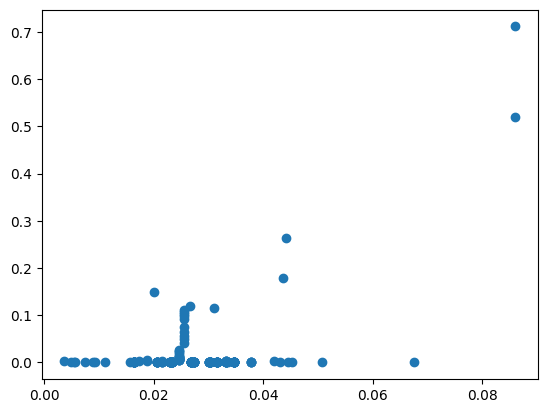

2022-08-21 05:33:58.495 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:58.497 | INFO     | __main__:apply_mean:92 - [0.016419973013870496, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03147687239210386, 0.03780700566379936, 0.03780700566379936, 0.03780700566379936, 0.03780700566379936, 0.04308136553534781, 0.015548636263747265, 0.020494521595622615, 0.034586083602828215, 0.034586083602828215, 0.034586083602828215, 0.034586083602828215, 0.034586083602828215, 0.034586083602828215, 0.034586083602828215, 0.034586083602828215, 0.03458608360282821

2022-08-21 05:33:58.511 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.512 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.517 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:58.527 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.530 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.534 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:58.546 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.548 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.552 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:58.566 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.568 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.571 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781], [0.015548636263747265], [0.02049452

2022-08-21 05:33:58.596 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:58.598 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.620 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.04308136553534781, 0.015548636263747265], [0.020494521595622615], [0.009489194177851823, 0.039

2022-08-21 05:33:58.633 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:58.637 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.643 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04308136553534781, 0.015548636263747265, 0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126], [0.020494521595622615], [0.009489194177851823, 0.039

2022-08-21 05:33:58.664 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:58.667 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.671 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04308136553534781, 0.015548636263747265, 0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126, 0.020494521595622615], [0.009489194177851823, 0.0398016

2022-08-21 05:33:58.685 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:58.688 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:58.692 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04308136553534781, 0.015548636263747265, 0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126, 0.0204945215956226

2022-08-21 05:33:58.713 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:58.716 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.719 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04308136553534781, 0.015548636263747265, 0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126, 0.020494521595622615], [0.009489194177851823, 0.0398016

2022-08-21 05:33:58.738 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:58.743 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.746 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04308136553534781, 0.015548636263747265, 0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126, 0.020494521595622615], [0.044577847356516875, 0.00919

2022-08-21 05:33:58.760 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:58.776 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.779 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.04308136553534781, 0.015548636263747265, 0.0004930531130614941, 0.0548893617922514, 0.04481805084346143, 0.051027556906423126, 0.020494521595622615], [0.044577847356516875, 0.0091990

2022-08-21 05:33:58.812 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:58.814 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.817 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.060882347

2022-08-21 05:33:58.832 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:58.835 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.837 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.053829637285505855, 0.09500326192170473, 0.06510260605108911, 0.0016539475369967888, 0.01916532969249141, 0.02526046919038041, 0.0428941398443505, 0.018861626554909854, 0.00440395190711718, 0.018758137803238005, 0.0013124885253587063], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743

2022-08-21 05:33:58.852 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:58.855 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.858 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.0004930531130

2022-08-21 05:33:58.873 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.876 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.880 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:58.916 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:58.918 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.924 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:58.940 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:58.943 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.952 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.000493053113061

2022-08-21 05:33:58.964 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:58.966 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:58.970 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 

2022-08-21 05:33:58.979 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:58.981 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:58.984 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781,

2022-08-21 05:33:58.994 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:58.996 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:58.998 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.0004930531130614

2022-08-21 05:33:59.010 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:59.013 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:59.031 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.

2022-08-21 05:33:59.046 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.049 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:59.055 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.083 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:59.090 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.094 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.000493053113061

2022-08-21 05:33:59.108 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:59.110 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.112 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.0004930531130

2022-08-21 05:33:59.132 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:59.134 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.135 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.000493053113061

2022-08-21 05:33:59.145 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:59.147 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:59.150 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 

2022-08-21 05:33:59.166 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:59.169 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:59.173 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.0155486362637472

2022-08-21 05:33:59.185 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.187 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:59.191 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.203 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.205 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:59.209 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.226 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.229 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:59.233 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.258 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.261 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:59.265 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265

2022-08-21 05:33:59.280 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.283 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:59.288 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.01554863626374

2022-08-21 05:33:59.301 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.312 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:59.317 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265

2022-08-21 05:33:59.328 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.331 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:59.334 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781

2022-08-21 05:33:59.354 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:59.356 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.362 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.0004930531130614

2022-08-21 05:33:59.373 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:59.375 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:59.380 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265,

2022-08-21 05:33:59.396 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:59.398 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:59.402 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747

2022-08-21 05:33:59.415 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.417 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:33:59.422 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265

2022-08-21 05:33:59.434 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:33:59.438 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:59.441 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781

2022-08-21 05:33:59.452 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:59.454 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.456 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.000493053113061

2022-08-21 05:33:59.474 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:33:59.477 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:59.481 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0

2022-08-21 05:33:59.490 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.494 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:59.498 | INFO     | __main__:eval_direction_expand:42 - merging down at index 13 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747

2022-08-21 05:33:59.506 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.514 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:59.516 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0

2022-08-21 05:33:59.524 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:59.530 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.532 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.00049305311306

2022-08-21 05:33:59.540 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.544 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:33:59.548 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747

2022-08-21 05:33:59.556 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.558 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:33:59.561 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0

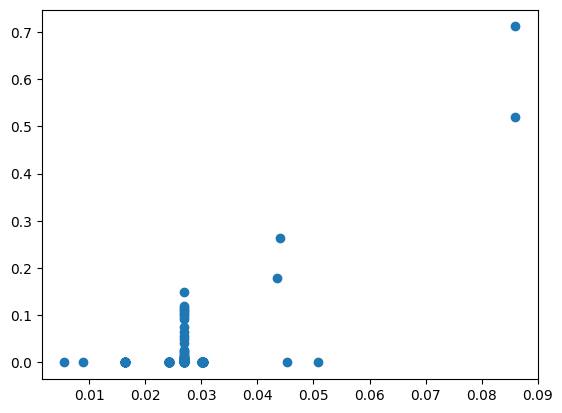

2022-08-21 05:33:59.852 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:33:59.854 | INFO     | __main__:apply_mean:92 - [0.016419973013870496, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.026824469776672345, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.030074740861929666, 0.0

2022-08-21 05:33:59.867 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.868 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:59.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.885 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.887 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:59.891 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.913 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.915 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:59.917 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.931 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:33:59.933 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:33:59.935 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 

2022-08-21 05:33:59.947 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:59.950 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.952 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.000493053113061

2022-08-21 05:33:59.975 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:33:59.978 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:33:59.981 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.0004930531130

2022-08-21 05:33:59.996 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:33:59.998 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:00.001 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.044577847356516875, 0.009199056645756327, 0.009489194177851823, 0.03980167534743407, 0.05525937380391711, 0.007447550122095567, 0.10593946722758177, 0.0727556961138911, 0.06088234743601462, 0.04605884550804765, 0.018724048416869577, 0.001609474973335493, 0.019535416360091713, 0.010907529177576746, 0.00050672395384977, 0.035287827821038, 0.004818990471494102, 0.04308136553534781, 0.015548636263747265, 0.000493053113061

2022-08-21 05:34:00.012 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:00.013 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:00.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.0167613198639

2022-08-21 05:34:00.030 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:00.032 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:00.033 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.07550887428269994, 0.03214730601318545, 0.04944439790697727, 0.027905769639306355, 0.021966440551007098, 0.00720949528327868, 0.037828158879762666, 0.0018036079516929452, 0.0002420632825740624, 0.024149833673503963, 0.0223165098912364, 0.02137117996484321], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.016761319863964

2022-08-21 05:34:00.048 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:00.050 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:00.052 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077, 0.04957276870961813, 0.003576991507

2022-08-21 05:34:00.067 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:00.069 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:00.072 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077

2022-08-21 05:34:00.083 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:00.085 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:00.088 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077

2022-08-21 05:34:00.099 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:00.101 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:00.104 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077

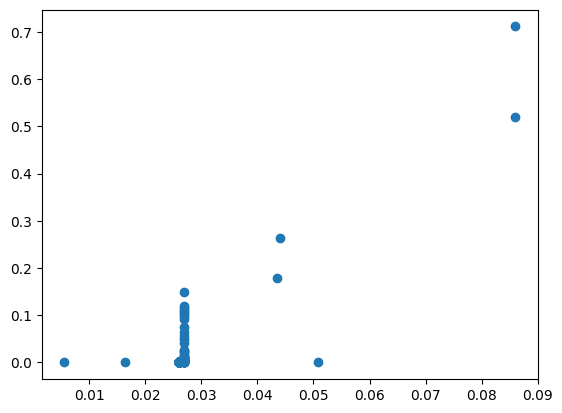

2022-08-21 05:34:00.404 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:00.408 | INFO     | __main__:apply_mean:92 - [0.016419973013870496, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.0

2022-08-21 05:34:00.430 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:00.434 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:00.441 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077

2022-08-21 05:34:00.464 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:00.467 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:00.472 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077

2022-08-21 05:34:00.487 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:00.489 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:00.491 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077, 0.04957276870961813, 0.00357699150769

2022-08-21 05:34:00.503 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:00.504 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:00.507 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077, 0.04957276870961813,

2022-08-21 05:34:00.542 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:00.545 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:00.549 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.01235448604070807

2022-08-21 05:34:00.566 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:00.568 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:00.579 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077

2022-08-21 05:34:00.588 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:00.590 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:00.594 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077

2022-08-21 05:34:00.611 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:00.613 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:00.615 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.016419973013870496], [0.04520486319101462, 0.00884432964856369, 0.004945584330505602, 0.06420209937964258, 0.0317235681255327, 0.08049642956222211, 0.03752937524421454, 0.01534350487596893, 0.03437439630458864, 0.011122813519766704, 0.036152510899162, 0.006277386416216311, 0.061281007356354195, 0.01942506434315465, 0.05173471618858701, 0.014523844802686266, 0.013147352407507664, 0.0019597345466899237, 0.0024724989179506387, 0.01676131986396411, 0.07649787959344763, 0.025237169357371907, 0.0047047550099568475, 0.0024817099640628386, 0.009753034009807662, 0.003997684138932616, 0.005383225591895904, 0.04330366529609262, 0.020790378855582048, 0.012354486040708077, 

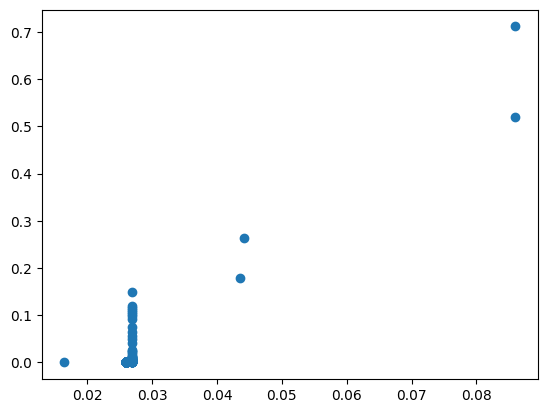

2022-08-21 05:34:00.904 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:00.906 | INFO     | __main__:apply_mean:92 - [0.016419973013870496, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.025939502974356824, 0.0

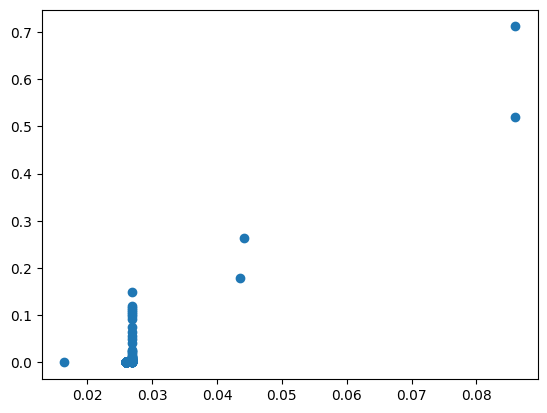

2022-08-21 05:34:01.138 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.009519529960486328, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0009623252032200033, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

2022-08-21 05:34:01.286 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:01.289 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:01.294 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.038277935601416], [0.04484164339441768], [0.007867886786137633], [0.011854289233353922], [0.02522387579152959], [0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309

2022-08-21 05:34:01.319 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:01.323 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:01.329 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.005850686167189137], [0.038277935601416], [0.04484164339441768], [0.007867886786137633], [0.011854289233353922], [0.02522387579152959], [0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024

Sstar: 0.8176809431002604
Tstar: 1.0
stress: 0.9042571222281085
Sstar: Autograd ArrayBox with value 0.9239946239401533
Tstar: 1.0


2022-08-21 05:34:01.344 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.038277935601416], [0.04484164339441768, 0.007867886786137633], [0.011854289233353922], [0.02522387579152959], [0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.02115701834357506], [0.06778132953234764], [0.020063090458986584], [0.006491915203119096], [0.06148140188095745], [0.08148219640351118

2022-08-21 05:34:01.364 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:01.368 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.372 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416], [0.011854289233353922], [0.02522387579152959], [0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0

2022-08-21 05:34:01.394 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:01.403 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.405 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922], [0.02522387579152959], [0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037

2022-08-21 05:34:01.421 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.424 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:01.429 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922], [0.02522387579152959], [0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.0246992311

2022-08-21 05:34:01.441 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.444 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:01.449 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959], [0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.043095940072

2022-08-21 05:34:01.460 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:01.463 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.465 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.03743538

2022-08-21 05:34:01.477 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.479 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:01.483 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.05300443499709163], [0.008927780578649567], [0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632

2022-08-21 05:34:01.496 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:01.498 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.500 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.05300443499709163], [0.008927780578649567, 0.0015075550620723432], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384

2022-08-21 05:34:01.521 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:01.524 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.527 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.008927780578649567, 0.0015075550620723432, 0.05300443499709163], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384

2022-08-21 05:34:01.566 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:01.568 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:01.573 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.005850686167189137], [0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.008927780578649567, 0.0015075550620723432, 0.05300443499709163], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.02469923119854

2022-08-21 05:34:01.595 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:01.598 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:01.605 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0

2022-08-21 05:34:01.629 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:01.632 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:01.638 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.051018976382442474], [0.00506957827977793], [0.0019786781291251934], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [

2022-08-21 05:34:01.655 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:01.670 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.673 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.051018976382442474], [0.0019786781291251934, 0.00506957827977793], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.03743538480607

2022-08-21 05:34:01.690 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:01.694 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:01.705 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.005850686167189137], [0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.051018976382442474], [0.0019786781291251934, 0.00506957827977793], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608

2022-08-21 05:34:01.733 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:01.736 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:01.740 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024

2022-08-21 05:34:01.753 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:01.756 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.767 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517], [0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626

2022-08-21 05:34:01.778 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:01.781 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.783 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], 

2022-08-21 05:34:01.798 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.802 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:01.805 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538], [0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.0374

2022-08-21 05:34:01.816 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.821 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:01.824 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087], [0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.0246992

2022-08-21 05:34:01.835 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:01.837 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.846 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.0

2022-08-21 05:34:01.857 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.859 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:01.865 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829], [0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.03743538

2022-08-21 05:34:01.878 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.880 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:01.883 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699], [0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.0246992311

2022-08-21 05:34:01.895 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:01.897 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.900 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.02115

2022-08-21 05:34:01.916 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.918 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:01.921 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423], [0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806

2022-08-21 05:34:01.932 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.934 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:01.937 | INFO     | __main__:stabilize_block:65 - at end of iteration 17, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976], [0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.02469923119854

2022-08-21 05:34:01.962 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:01.965 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:01.968 | INFO     | __main__:stabilize_block:65 - at end of iteration 18, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.021157018

2022-08-21 05:34:01.979 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:01.982 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:01.986 | INFO     | __main__:stabilize_block:65 - at end of iteration 20, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242], [0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608]

2022-08-21 05:34:01.998 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.000 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.002 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.021308664439832807], [0.029325706217107242, 0.004309088573369966], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.02115701834

2022-08-21 05:34:02.013 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.015 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.018 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807], [0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.02115701834

2022-08-21 05:34:02.036 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.045 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.048 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.03992790641904283], [0.05591272886139691], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.021157018343575

2022-08-21 05:34:02.057 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.059 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.062 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.03992790641904283], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626], [0.021157018343575

2022-08-21 05:34:02.085 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.088 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:02.092 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.03992790641904283], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.037435384806074626],

2022-08-21 05:34:02.111 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.114 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:02.118 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.03743

2022-08-21 05:34:02.132 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:02.134 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:02.137 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.0360694216668039], [0.039220515879413456], [0.04309594007277632], [0.024699231198542608], [0.0374

2022-08-21 05:34:02.150 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.152 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.154 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.0360694216668039], [0.039220515879413456], [0.024699231198542608, 0.04309594007277632], [0.037435384806074626], [0.02115701834357506], 

2022-08-21 05:34:02.170 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.173 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:02.176 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.0360694216668039], [0.039220515879413456], [0.024699231198542608, 0.04309594007277632], [0.037435384806074626], [0.

2022-08-21 05:34:02.185 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.188 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:02.191 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.0360694216668039], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456], [0.037435384

2022-08-21 05:34:02.211 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.214 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.216 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:02.225 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.228 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.231 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:02.242 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.245 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.247 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.06

2022-08-21 05:34:02.258 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.261 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.263 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:02.272 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.274 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.278 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:02.297 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.298 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.300 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.02

2022-08-21 05:34:02.310 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.327 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.328 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:02.340 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.342 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.344 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.02

2022-08-21 05:34:02.353 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.356 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.360 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701

2022-08-21 05:34:02.371 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.373 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.381 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:02.397 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.404 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.020

2022-08-21 05:34:02.419 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.422 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.438 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701

2022-08-21 05:34:02.458 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.461 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:02.467 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211

2022-08-21 05:34:02.483 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:02.484 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.489 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:02.502 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:02.504 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.508 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353

2022-08-21 05:34:02.521 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.523 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.526 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:02.546 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.549 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.554 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701

2022-08-21 05:34:02.568 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.570 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.575 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:02.589 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.591 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.593 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:02.607 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.609 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.613 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701

2022-08-21 05:34:02.634 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.636 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.639 | INFO     | __main__:stabilize_block:65 - at end of iteration 19, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:02.654 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:02.658 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.661 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:02.670 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:02.672 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:02.677 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021

2022-08-21 05:34:02.697 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:02.699 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:02.703 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:02.720 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.722 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.724 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:02.735 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.740 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.744 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:02.753 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.755 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.759 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701

2022-08-21 05:34:02.769 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.779 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.782 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:02.798 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.799 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.804 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:02.815 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.817 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:02.823 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701

2022-08-21 05:34:02.835 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.838 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.842 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:02.859 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.861 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.865 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:02.876 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.880 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:02.883 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538480

2022-08-21 05:34:02.893 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.895 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.899 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:02.913 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.924 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.926 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:02.938 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:02.940 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:02.945 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806

2022-08-21 05:34:02.960 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:02.963 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.966 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:02.975 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:02.977 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:02.978 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:02.987 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:02.989 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:02.992 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.020 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:03.023 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.024 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:03.032 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.034 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.036 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:03.050 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.052 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.055 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:03.065 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.072 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.075 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:03.083 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.084 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.095 | INFO     | __main__:eval_direction_expand:42 - merging down at index 14 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:03.104 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.109 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.113 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:03.122 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.125 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.128 | INFO     | __main__:eval_direction_expand:42 - merging down at index 13 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:03.137 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.140 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.143 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:03.154 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.157 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.161 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:03.173 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:03.179 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.181 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:03.190 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.191 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.195 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806

2022-08-21 05:34:03.207 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:03.209 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.229 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:03.240 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:03.242 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.245 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:03.256 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.266 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.269 | INFO     | __main__:eval_direction_expand:42 - merging down at index 14 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021

2022-08-21 05:34:03.282 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.284 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.288 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538480

2022-08-21 05:34:03.298 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:03.300 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.307 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:03.314 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.321 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.324 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.342 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:03.345 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.348 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:03.360 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:03.362 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.364 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:03.374 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:03.376 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.378 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:03.389 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.390 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.393 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:03.401 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.402 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.405 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:03.414 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.416 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.419 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:03.427 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.429 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.433 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:03.440 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.441 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.445 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.456 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:03.458 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.460 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:03.471 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:03.473 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.475 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:03.487 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.490 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.492 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:03.501 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.512 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.515 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:03.527 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:03.530 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.532 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:03.544 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.548 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.552 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:03.574 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:03.576 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.582 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:03.616 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.618 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.624 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.639 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:03.642 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.644 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:03.653 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.659 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.663 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021

2022-08-21 05:34:03.670 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.672 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.675 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:03.684 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.692 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.697 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:03.704 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.706 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.709 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:03.718 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.720 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.723 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:03.735 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.737 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.742 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.763 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.765 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.769 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.784 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.792 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:03.797 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:03.809 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.815 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.819 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:03.830 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.835 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.839 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.852 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:03.854 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.857 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.868 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:03.874 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.876 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:03.889 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.897 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.901 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:03.928 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.932 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:03.936 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021

2022-08-21 05:34:03.948 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.951 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:03.955 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538480

2022-08-21 05:34:03.966 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:03.968 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:03.974 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:03.986 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:03.988 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:03.995 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:04.012 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.015 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.017 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.032 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.034 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:04.036 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806

2022-08-21 05:34:04.045 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:04.051 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.054 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:04.065 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.067 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.069 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.079 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:04.081 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.086 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:04.100 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.102 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.105 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.116 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:04.119 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.126 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:04.138 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.141 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.143 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.159 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.162 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:04.166 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806

2022-08-21 05:34:04.184 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.187 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.189 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.211 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.214 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.217 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:04.227 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.229 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.233 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:04.250 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.252 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.254 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:04.263 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.266 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.270 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:04.280 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.285 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.293 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:04.304 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.306 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.308 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:04.329 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.331 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:04.334 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538480

2022-08-21 05:34:04.349 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.351 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.353 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.362 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.364 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.375 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:04.384 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.386 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.390 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:04.401 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:04.403 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.405 | INFO     | __main__:eval_direction_expand:42 - merging up at index 29 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:04.423 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:04.425 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:04.428 | INFO     | __main__:eval_direction_expand:42 - merging down at index 29 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:04.440 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:04.443 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.451 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:04.460 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:04.463 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.467 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:04.476 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:04.479 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.482 | INFO     | __main__:eval_direction_expand:42 - merging up at index 30 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:04.493 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:04.494 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:04.497 | INFO     | __main__:eval_direction_expand:42 - merging down at index 30 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:04.507 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:04.509 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:04.512 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:04.531 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:04.534 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.547 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:04.560 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:04.565 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.569 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:04.584 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.586 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.591 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.601 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.603 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:04.606 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806

2022-08-21 05:34:04.618 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:04.620 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.623 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:04.637 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:04.639 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.642 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:04.652 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.663 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.664 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.679 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:04.681 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.682 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:04.693 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.695 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.698 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.707 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.709 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.719 | INFO     | __main__:eval_direction_expand:42 - merging up at index 33 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:04.725 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.727 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.730 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:04.745 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.746 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:04.759 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.761 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.764 | INFO     | __main__:eval_direction_expand:42 - merging up at index 33 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:04.773 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.777 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.780 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:04.791 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.793 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.795 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.803 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.805 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:04.807 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538480

2022-08-21 05:34:04.828 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.830 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.831 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.847 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:04.849 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:04.869 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.871 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.873 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:04.883 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.893 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.896 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:04.914 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.917 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.922 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:04.934 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.936 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:04.938 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:04.947 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.949 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:04.953 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:04.964 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:04.967 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:04.971 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:04.992 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:04.995 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.001 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:05.009 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.010 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.013 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:05.021 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.023 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:05.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:05.037 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:05.038 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.041 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:05.049 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.050 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.053 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:05.061 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.062 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:05.065 | INFO     | __main__:eval_direction_expand:42 - merging down at index 34 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021

2022-08-21 05:34:05.079 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.080 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.083 | INFO     | __main__:stabilize_block:65 - at end of iteration 18, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:05.092 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.094 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.096 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:05.107 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:05.109 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.130 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:05.142 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:05.150 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.153 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:05.169 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:05.171 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.186 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:05.199 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:05.203 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:05.207 | INFO     | __main__:eval_direction_expand:42 - merging down at index 34 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021

2022-08-21 05:34:05.219 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:05.221 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.224 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538480

2022-08-21 05:34:05.234 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.236 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.239 | INFO     | __main__:eval_direction_expand:42 - merging up at index 37 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:05.261 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.263 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:05.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:05.287 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.289 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.292 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:05.307 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.309 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.312 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:05.321 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.322 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:05.325 | INFO     | __main__:eval_direction_expand:42 - merging down at index 39 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:05.346 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.349 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.352 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:05.367 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.370 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.373 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:05.383 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.385 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:05.388 | INFO     | __main__:eval_direction_expand:42 - merging down at index 40 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:05.397 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.399 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.403 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:05.425 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.427 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:05.431 | INFO     | __main__:eval_direction_expand:42 - merging down at index 39 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02

2022-08-21 05:34:05.440 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.443 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.449 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:05.460 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:05.462 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.468 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.0

2022-08-21 05:34:05.479 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:05.481 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:05.488 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:05.500 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:05.502 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:05.506 | INFO     | __main__:eval_direction_expand:42 - merging down at index 41 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021

2022-08-21 05:34:05.517 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:05.519 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.521 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:05.531 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.533 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:05.541 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:05.553 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.555 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.558 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:05.570 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.572 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.575 | INFO     | __main__:eval_direction_expand:42 - merging up at index 43 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.021157

2022-08-21 05:34:05.598 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:05.600 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:05.604 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.03743538

2022-08-21 05:34:05.616 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:05.619 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.621 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:05.629 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:05.636 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.638 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.

2022-08-21 05:34:05.648 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:05.657 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.660 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:05.686 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.693 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.699 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806

2022-08-21 05:34:05.712 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:05.718 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.720 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.08

2022-08-21 05:34:05.736 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.739 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.741 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:05.756 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.758 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:05.762 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:05.780 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:05.785 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:05.787 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.02115701834357506], [0.081

2022-08-21 05:34:05.798 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.800 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:05.803 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626], [0.0211570

2022-08-21 05:34:05.823 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.825 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:05.828 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384

2022-08-21 05:34:05.841 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:05.842 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:05.847 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806

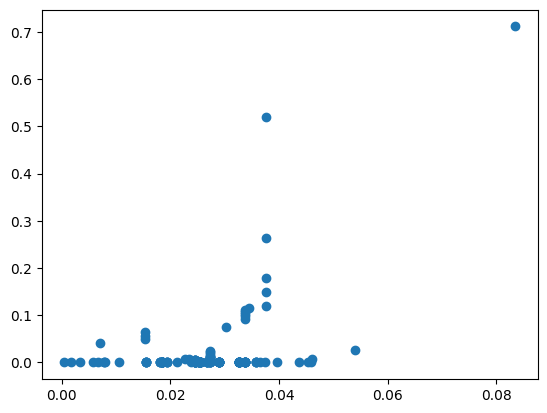

2022-08-21 05:34:06.048 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:06.049 | INFO     | __main__:apply_mean:92 - [0.005850686167189137, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.02731344801457276, 0.02731344801457276, 0.02731344801457276, 0.02731344801457276, 0.02731344801457276, 0.02731344801457276, 0.03577127720438407, 0.03577127720438407, 0.03577127720438407, 0.03577127720438407, 0.037435384806074626, 0.02115701834357506, 0.025486868594181075, 0.025486868594181075, 0.025486868594181075, 0.025486868594181075, 0.025486868594181075, 0.025486868594181075, 0.025486868594181075, 0.025486868594181075, 0.025486868

2022-08-21 05:34:06.063 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.065 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.069 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:06.079 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.080 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.082 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:06.092 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.094 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.097 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:06.116 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.118 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.121 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0374353848

2022-08-21 05:34:06.134 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.136 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.138 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.037435384806074626, 0.02115701834357506], [0.0814

2022-08-21 05:34:06.151 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:06.153 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.155 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039], [0.0814

2022-08-21 05:34:06.164 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.166 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.168 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039, 0.08148219

2022-08-21 05:34:06.175 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.177 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:06.180 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.0392205158794

2022-08-21 05:34:06.190 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.193 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.195 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039, 0.08148219

2022-08-21 05:34:06.221 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:06.223 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.225 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039, 0.081482

2022-08-21 05:34:06.237 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.239 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.241 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694216668039, 0.08148219

2022-08-21 05:34:06.254 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.256 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:06.260 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.03606942166

2022-08-21 05:34:06.269 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.275 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:06.281 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.037435384806074626, 0.02115701834357506, 0.024699231198542608, 0.04309594007277632, 0.039220515879413456, 0.0360694

2022-08-21 05:34:06.294 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.295 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:06.298 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.09372670856

2022-08-21 05:34:06.307 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.309 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:06.312 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.029325706217107242, 0.004309088573369966, 0.021308664439832807, 0.013096593576686827, 0.05591272886139691, 0.03992790641904283], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267

2022-08-21 05:34:06.320 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.321 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:06.324 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.334 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.336 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:06.340 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856

2022-08-21 05:34:06.355 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.360 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:06.363 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.00784114745

2022-08-21 05:34:06.378 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.382 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:06.385 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856

2022-08-21 05:34:06.394 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.396 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.400 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.02249908501130

2022-08-21 05:34:06.421 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.431 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.433 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.031714018837

2022-08-21 05:34:06.443 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.445 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:06.449 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.0078411474528563

2022-08-21 05:34:06.463 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.465 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.469 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301

2022-08-21 05:34:06.486 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.488 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.490 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.031714018837

2022-08-21 05:34:06.503 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.506 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:06.510 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.02249908501130122

2022-08-21 05:34:06.519 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.521 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:06.525 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452

2022-08-21 05:34:06.536 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.538 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:06.546 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.02249908501130122

2022-08-21 05:34:06.559 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:06.566 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.567 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.0317140188

2022-08-21 05:34:06.576 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.578 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.587 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.03171401883

2022-08-21 05:34:06.596 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.598 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:06.600 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226

2022-08-21 05:34:06.611 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.613 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.617 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.625 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.627 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.629 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.639 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.641 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.643 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.03171401883

2022-08-21 05:34:06.665 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:06.670 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.672 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.031714018

2022-08-21 05:34:06.685 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.688 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.690 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.03171401883

2022-08-21 05:34:06.707 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:06.709 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.712 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.031714018

2022-08-21 05:34:06.733 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.736 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.740 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.03171401883

2022-08-21 05:34:06.751 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.753 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:06.756 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.0078411474528563

2022-08-21 05:34:06.765 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:06.768 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.771 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301

2022-08-21 05:34:06.781 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.795 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:06.797 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.808 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.811 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:06.814 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.823 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.825 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:06.828 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.00784114745285

2022-08-21 05:34:06.841 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:06.844 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.850 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.02249908501130

2022-08-21 05:34:06.858 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:06.863 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.865 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.031714018837

2022-08-21 05:34:06.878 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:06.880 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:06.882 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.031714018

2022-08-21 05:34:06.889 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.891 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.893 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.907 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.908 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.911 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.919 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.921 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.923 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:06.934 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:06.943 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:06.945 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

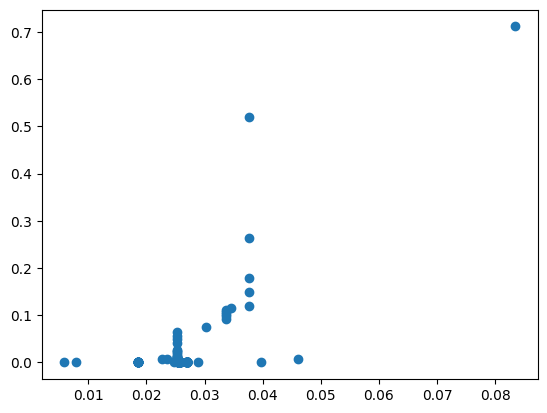

2022-08-21 05:34:07.275 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:07.276 | INFO     | __main__:apply_mean:92 - [0.005850686167189137, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151, 0.02703814709254151,

2022-08-21 05:34:07.290 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.293 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.297 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:07.313 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.316 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.322 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:07.349 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.357 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.363 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113012

2022-08-21 05:34:07.381 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:07.385 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:07.389 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.022499085011301226, 0.007841147452856335, 0.03171401883

2022-08-21 05:34:07.411 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:07.415 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:07.419 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.02249908501

2022-08-21 05:34:07.443 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:07.445 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:07.447 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.014729261085886791, 0.0224990850113

2022-08-21 05:34:07.459 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:07.461 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:07.465 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 

2022-08-21 05:34:07.474 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.476 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:07.478 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609, 0.01472926108588

2022-08-21 05:34:07.490 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.492 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:07.495 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817609,

2022-08-21 05:34:07.511 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:07.513 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:07.515 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.0037205358088

2022-08-21 05:34:07.531 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:07.533 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:07.535 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.00372053580881

2022-08-21 05:34:07.543 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:07.546 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:07.549 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 

2022-08-21 05:34:07.565 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.566 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.575 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:07.586 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.587 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.590 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:07.603 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.607 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:07.618 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.620 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.623 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:07.638 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.642 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.646 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:07.662 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.664 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.668 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

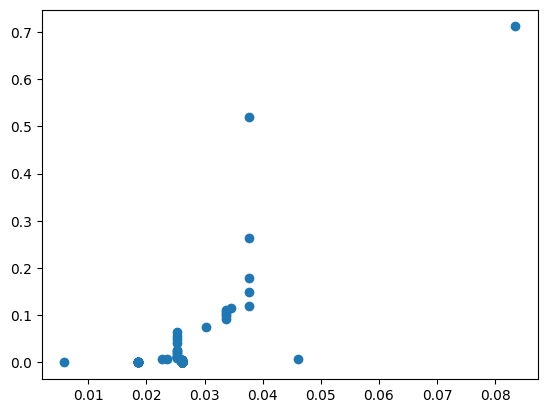

2022-08-21 05:34:07.913 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:07.915 | INFO     | __main__:apply_mean:92 - [0.005850686167189137, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 0.026171055292777856, 

2022-08-21 05:34:07.925 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.927 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.931 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:07.951 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.954 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.959 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:07.982 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:07.984 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:07.988 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452

2022-08-21 05:34:08.005 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:08.007 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:08.010 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.00372053580881

2022-08-21 05:34:08.021 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:08.024 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:08.028 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176,

2022-08-21 05:34:08.047 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:08.050 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:08.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.0389247506922945

2022-08-21 05:34:08.071 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:08.074 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:08.078 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.00783496157590936, 0.039660672461506126, 0.02888966003483508, 0.02466637913254363, 0.045383022758819974, 0.006736758783980969, 0.029909844099878215, 0.02318677021395344, 0.0353409523894125, 0.0937267085617302, 0.03892475069229452, 0.04211387032436176, 0.003720535808817

2022-08-21 05:34:08.122 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:08.124 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:08.128 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.04605621876798828, 0.022724525626977018, 0.023514533637054753, 0.054031080632588546, 0.007050081890541011, 0.001845519489116569, 0.031812126013703035, 0.012250683488939526, 0.03270926538470258, 0.004412040413491882, 0.03739508659463004, 0.019539368279590345, 0.04545

2022-08-21 05:34:08.150 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:08.158 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:08.162 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.04605621876798828, 0.022724525626977018, 0.023514533637054753, 0.054031080632588546, 0.007050081890541011, 0.001845519489116569, 0.031812126013703035, 0.012250683488939526, 0.03270926538470258, 0.004412040413491882, 0.03739508659

2022-08-21 05:34:08.177 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:08.180 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:08.184 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.04605621876798828, 0.022724525626977018, 0.023514533637054753, 0.054031080632588546, 0.007050081890541011, 0.001845519489116569, 0.031812126013703035, 0.012250683488939526, 0.03270926538470258, 0.004412040413491882, 0.03739508659

2022-08-21 05:34:08.199 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:08.202 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:08.206 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.04605621876798828, 0.022724525626977018, 0.023514533637054753, 0.054031080632588546, 0.007050081890541011, 0.001845519489116569, 0.031812126013703035, 0.012250683488939526, 0.03270926538470258, 0.004412040413491882, 0.03739508659

2022-08-21 05:34:08.220 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:08.223 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:08.226 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.005850686167189137], [0.0019786781291251934, 0.00506957827977793, 0.051018976382442474, 0.008927780578649567, 0.0015075550620723432, 0.05300443499709163, 0.04484164339441768, 0.007867886786137633, 0.038277935601416, 0.011854289233353922, 0.02522387579152959, 0.01898550809293517, 0.021889999998797538, 0.007781188781904087, 0.00985277922525829, 0.012595691697170699, 0.011499222012180423, 0.0030299289063514976, 0.017209967808751656], [0.04605621876798828, 0.022724525626977018, 0.023514533637054753, 0.054031080632588546, 0.007050081890541011, 0.001845519489116569, 0.031812126013703035, 0.012250683488939526, 0.03270926538470258, 0.004412040413491882, 0.03739508659

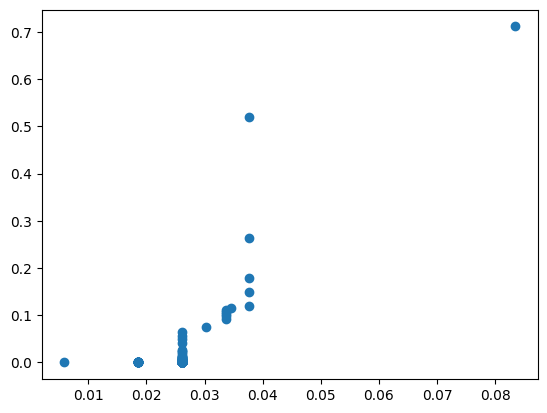

2022-08-21 05:34:08.560 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:08.562 | INFO     | __main__:apply_mean:92 - [0.005850686167189137, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.01854825898733491, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 0.026169735041339123, 

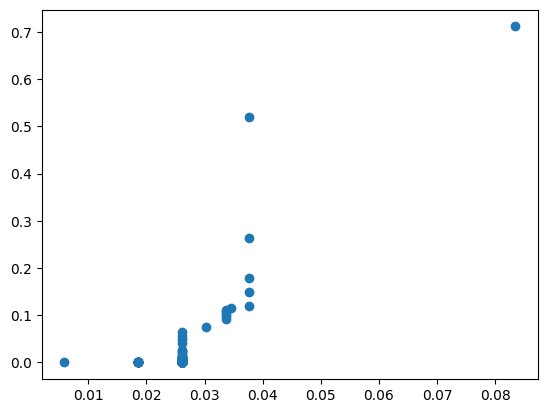

2022-08-21 05:34:08.840 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.012697572820145773, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.007621476054004213, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.004098

2022-08-21 05:34:09.011 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.016 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.023 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.01692794118230705], [0.04615599798549752], [0.007118219932944299], [0.03605395075454739], [0.009260497645364008], [0.04285569018958407], [0.06541761217304437], [0.0006773912084179032], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.

2022-08-21 05:34:09.043 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}


Sstar: 0.8524594212378311
Tstar: 1.0
stress: 0.9232872907377373
Sstar: Autograd ArrayBox with value 0.9707360590048498
Tstar: 1.0


2022-08-21 05:34:09.047 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:09.053 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.04615599798549752, 0.007118219932944299], [0.03605395075454739], [0.009260497645364008], [0.04285569018958407], [0.06541761217304437], [0.0006773912084179032], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.03553476683885029], [0.035819894472742], [0.017901

2022-08-21 05:34:09.074 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.076 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.081 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.01692794118230705], [0.04615599798549752, 0.007118219932944299], [0.03605395075454739], [0.009260497645364008], [0.04285569018958407], [0.06541761217304437], [0.0006773912084179032], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.00

2022-08-21 05:34:09.095 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.096 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:09.101 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.01692794118230705], [0.04615599798549752, 0.007118219932944299], [0.03605395075454739, 0.009260497645364008], [0.04285569018958407], [0.06541761217304437], [0.0006773912084179032], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.

2022-08-21 05:34:09.111 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.117 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:09.121 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.04285569018958407], [0.06541761217304437], [0.0006773912084179032], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531

2022-08-21 05:34:09.133 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.136 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.140 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.04285569018958407], [0.06541761217304437], [0.0006773912084179032], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.006906

2022-08-21 05:34:09.151 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.153 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:09.156 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.04285569018958407], [0.06541761217304437, 0.0006773912084179032], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069

2022-08-21 05:34:09.173 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.175 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.178 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407], [0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994

2022-08-21 05:34:09.191 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.193 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:09.202 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743], [0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.0496125315430

2022-08-21 05:34:09.213 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:09.216 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.225 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.03553476

2022-08-21 05:34:09.242 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:09.244 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:09.251 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186]

2022-08-21 05:34:09.262 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:09.264 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:09.274 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.057662387038974264], [0.01049263071719687], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.00690609947

2022-08-21 05:34:09.288 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:09.291 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.294 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.01049263071719687, 0.057662387038974264], [0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.00690609947816928

2022-08-21 05:34:09.307 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.309 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:09.311 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.01049263071719687, 0.057662387038974264, 0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186]

2022-08-21 05:34:09.323 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.325 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:09.329 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.01049263071719687, 0.057662387038974264, 0.02946146834819012], [0.042438301078238004], [0.004485227789797347], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], 

2022-08-21 05:34:09.347 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:09.350 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.352 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.01049263071719687, 0.057662387038974264, 0.02946146834819012], [0.004485227789797347, 0.042438301078238004], [0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.035534766838

2022-08-21 05:34:09.385 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:09.388 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.393 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.01049263071719687, 0.057662387038974264, 0.02946146834819012], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.035534766838850

2022-08-21 05:34:09.409 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:09.412 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012], [0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.035534766838850

2022-08-21 05:34:09.436 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:09.439 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.450 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.03553476683885029],

2022-08-21 05:34:09.467 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:09.470 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.472 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.03553476683885029],

2022-08-21 05:34:09.487 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:09.490 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:09.494 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548], [0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060

2022-08-21 05:34:09.514 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:09.526 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.531 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.03553476683885029], [0.

2022-08-21 05:34:09.546 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:09.548 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.553 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166], [0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.035534

2022-08-21 05:34:09.566 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:09.569 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:09.575 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166, 0.029715162041294693], [0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994

2022-08-21 05:34:09.589 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:09.592 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.595 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.03553476683885029], [0.03581

2022-08-21 05:34:09.614 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:09.618 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.623 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706], [0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.0355347668

2022-08-21 05:34:09.646 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:09.649 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:09.656 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.00690609947816

2022-08-21 05:34:09.673 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.681 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.688 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994], [0.05707283539127708], [0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.03553476683

2022-08-21 05:34:09.701 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.706 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:09.709 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994], [0.05707283539127708, 0.0013633823042851266], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.035534766

2022-08-21 05:34:09.735 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.737 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:09.741 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994], [0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895], [0.035534766838850

2022-08-21 05:34:09.753 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.756 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:09.764 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895

2022-08-21 05:34:09.779 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.782 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:09.799 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.049612531543028186], [0.0069060994781692895],

2022-08-21 05:34:09.827 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:09.829 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.832 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.0069060994781692895, 0.049612531543028186], [0.03553476683885029], [0.0358198944727

2022-08-21 05:34:09.855 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:09.860 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:09.865 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.0069060994781692895, 0.049612531543028186], [0.0355347668388502

2022-08-21 05:34:09.880 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:09.884 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:09.889 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.0

2022-08-21 05:34:09.902 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:09.904 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:09.909 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.

2022-08-21 05:34:09.927 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:09.933 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:09.943 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.03553476683885029], [0.017901212722683

2022-08-21 05:34:09.957 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:09.960 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:09.964 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.03553476683885029]

2022-08-21 05:34:09.976 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:09.979 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:09.983 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001515253553687917], [0.0

2022-08-21 05:34:09.996 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:09.999 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.001 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:10.013 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:10.020 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.023 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:10.036 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:10.041 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.051 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:10.065 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.067 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.069 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.096 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.099 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.103 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:10.114 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.120 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.123 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167

2022-08-21 05:34:10.136 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.138 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.140 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:10.149 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.152 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:10.155 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:10.173 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.175 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.178 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.194 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.196 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.199 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:10.209 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.218 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.221 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.233 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.236 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.239 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:10.255 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.257 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.259 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167

2022-08-21 05:34:10.269 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.271 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.274 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:10.285 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.287 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:10.289 | INFO     | __main__:eval_direction_expand:42 - merging down at index 13 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:10.298 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.301 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.304 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:10.324 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.327 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.331 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:10.343 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.346 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.349 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:10.359 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.363 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.369 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:10.397 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.400 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167

2022-08-21 05:34:10.420 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.421 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.423 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:10.441 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.443 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.446 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:10.458 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.459 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.464 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:10.481 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.483 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.487 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:10.501 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.503 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:10.506 | INFO     | __main__:eval_direction_expand:42 - merging down at index 14 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:10.515 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.517 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:10.520 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:10.528 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:10.530 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.533 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:10.547 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.551 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.554 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:10.567 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.569 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.572 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:10.580 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:10.582 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.586 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:10.607 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:10.609 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:10.612 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:10.621 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:10.623 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:10.627 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:10.646 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.648 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.651 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:10.663 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.668 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.688 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.691 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.698 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:10.711 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.714 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.716 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.727 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.729 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.731 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:10.748 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:10.750 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.753 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:10.770 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.772 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.787 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.789 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.792 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:10.805 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.807 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.810 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.824 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:10.834 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:10.838 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:10.849 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:10.851 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:10.857 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:10.871 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.873 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.876 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.887 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.889 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.915 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:10.929 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.932 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.935 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:10.956 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:10.961 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.964 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:10.978 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:10.981 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:10.984 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:11.000 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.003 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.007 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:11.017 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:11.020 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.023 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:11.032 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:11.034 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:11.037 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:11.048 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:11.052 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:11.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167

2022-08-21 05:34:11.080 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.082 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.086 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.096 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.098 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.100 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:11.120 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.127 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:11.131 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.142 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.145 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.148 | INFO     | __main__:eval_direction_expand:42 - merging down at index 20 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:11.158 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.159 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.163 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:11.177 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.179 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:11.182 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:11.191 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.194 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.197 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:11.206 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.207 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.210 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.222 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.224 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.228 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.265 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.269 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.272 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:11.288 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.292 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:11.298 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.316 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.319 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.324 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:11.339 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.342 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.349 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:11.369 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.373 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.376 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:11.393 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.395 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:11.401 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.420 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.423 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.429 | INFO     | __main__:eval_direction_expand:42 - merging down at index 24 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:11.443 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.446 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.450 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:11.494 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.496 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.499 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:11.515 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.518 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.523 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:11.537 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.540 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.543 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:11.556 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.559 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:11.562 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:11.579 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.581 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.589 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:11.602 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.610 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.614 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.626 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.629 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.631 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:11.651 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.653 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.656 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:11.668 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.670 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.674 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:11.685 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.688 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.690 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:11.705 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.708 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:11.712 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.726 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:11.728 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.734 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:11.744 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.747 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.750 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:11.758 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.761 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:11.764 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.775 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.776 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.780 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:11.789 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.791 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.816 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:11.829 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.831 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.842 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:11.856 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:11.859 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:11.862 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:11.877 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.879 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.883 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:11.901 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:11.904 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:11.910 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:11.923 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.925 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:11.929 | INFO     | __main__:eval_direction_expand:42 - merging up at index 29 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:11.938 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.940 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.955 | INFO     | __main__:eval_direction_expand:42 - merging down at index 29 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:11.965 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.967 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:11.972 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:11.985 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:11.989 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:11.993 | INFO     | __main__:eval_direction_expand:42 - merging down at index 28 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:12.006 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.010 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.014 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.035 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.042 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.045 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:12.055 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.058 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.062 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.073 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.075 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:12.079 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:12.104 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:12.106 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.108 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:12.119 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:12.120 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.124 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:12.134 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:12.137 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.140 | INFO     | __main__:eval_direction_expand:42 - merging down at index 30 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:12.152 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:12.155 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.169 | INFO     | __main__:eval_direction_expand:42 - merging up at index 29 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:12.180 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.182 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:12.189 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:12.200 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:12.206 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.208 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:12.216 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:12.218 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.221 | INFO     | __main__:eval_direction_expand:42 - merging up at index 29 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:12.231 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:12.233 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:12.244 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167

2022-08-21 05:34:12.253 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.255 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.259 | INFO     | __main__:eval_direction_expand:42 - merging up at index 31 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.268 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.270 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.274 | INFO     | __main__:eval_direction_expand:42 - merging down at index 31 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:12.296 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.298 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.302 | INFO     | __main__:eval_direction_expand:42 - merging up at index 30 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.318 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.320 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.326 | INFO     | __main__:eval_direction_expand:42 - merging down at index 30 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:12.348 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.352 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.355 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:12.374 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.377 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.382 | INFO     | __main__:eval_direction_expand:42 - merging up at index 32 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.394 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.404 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:12.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:12.420 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.423 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.433 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:12.449 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.453 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.456 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:12.473 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.474 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.476 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.492 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.495 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.499 | INFO     | __main__:eval_direction_expand:42 - merging down at index 35 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:12.518 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.523 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.528 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.539 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.542 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:12.548 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:12.566 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.569 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.575 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.589 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.592 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.597 | INFO     | __main__:eval_direction_expand:42 - merging down at index 36 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:12.609 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.611 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.614 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.625 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.628 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.631 | INFO     | __main__:eval_direction_expand:42 - merging down at index 35 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:12.668 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.670 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:12.673 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:12.683 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.686 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:12.697 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:12.711 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:12.714 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.718 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:12.730 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:12.732 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.742 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:12.750 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:12.753 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:12.756 | INFO     | __main__:eval_direction_expand:42 - merging down at index 36 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:12.765 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:12.768 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.771 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:12.782 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:12.784 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.786 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:12.796 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:12.798 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.800 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:12.812 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:12.815 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.820 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:12.831 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:12.833 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.847 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:12.858 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:12.860 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.861 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:12.874 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:12.877 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:12.882 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:12.903 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:12.905 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.917 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:12.930 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:12.931 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.934 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:12.946 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:12.948 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:12.950 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:12.959 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:12.962 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:12.973 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:12.992 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:12.999 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.003 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.022 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.024 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.026 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:13.042 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.044 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.046 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.061 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.063 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.067 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.077 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.079 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:13.082 | INFO     | __main__:eval_direction_expand:42 - merging down at index 42 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:13.094 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.096 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.099 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:13.114 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.118 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:13.121 | INFO     | __main__:eval_direction_expand:42 - merging up at index 43 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:13.128 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.131 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:13.134 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116

2022-08-21 05:34:13.144 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.146 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.149 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:13.159 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.164 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:13.168 | INFO     | __main__:eval_direction_expand:42 - merging up at index 43 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:13.185 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.187 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:13.190 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167

2022-08-21 05:34:13.202 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.204 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.206 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000

2022-08-21 05:34:13.224 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.226 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.230 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:13.239 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.244 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.246 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.259 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.261 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.264 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:13.278 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.280 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:13.283 | INFO     | __main__:eval_direction_expand:42 - merging down at index 44 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:13.292 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.294 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.298 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:13.319 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.322 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:13.325 | INFO     | __main__:eval_direction_expand:42 - merging up at index 45 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:13.332 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.335 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:13.338 | INFO     | __main__:eval_direction_expand:42 - merging down at index 45 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:13.349 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.352 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.355 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:13.370 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.371 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.372 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:13.382 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.384 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:13.387 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:13.405 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.407 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.409 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.423 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.424 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.426 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:13.438 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.444 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.446 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.460 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.463 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.465 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:13.475 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.477 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.479 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.494 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.496 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.498 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:13.510 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.512 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.514 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.525 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.527 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.528 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.

2022-08-21 05:34:13.540 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.542 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.544 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.558 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.560 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.563 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:13.588 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.590 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:13.597 | INFO     | __main__:eval_direction_expand:42 - merging down at index 47 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:13.608 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.616 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.620 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:13.635 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.638 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.641 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:13.658 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.660 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:13.663 | INFO     | __main__:eval_direction_expand:42 - merging down at index 45 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:13.673 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.675 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.684 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:13.699 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:13.701 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.704 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0

2022-08-21 05:34:13.717 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.730 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:13.734 | INFO     | __main__:eval_direction_expand:42 - merging down at index 43 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02

2022-08-21 05:34:13.748 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:13.750 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:13.755 | INFO     | __main__:eval_direction_expand:42 - merging up at index 42 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371

2022-08-21 05:34:13.765 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.767 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:13.771 | INFO     | __main__:eval_direction_expand:42 - merging down at index 42 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0

2022-08-21 05:34:13.784 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.787 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:13.791 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.02737

2022-08-21 05:34:13.812 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:13.814 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:13.817 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111

2022-08-21 05:34:13.826 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:13.828 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:13.836 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00

2022-08-21 05:34:13.849 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.850 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.854 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.01116726

2022-08-21 05:34:13.864 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.865 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.873 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.884 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.887 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.892 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.905 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.907 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.911 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.924 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.926 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.930 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.942 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.943 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.946 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.956 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.958 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.961 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.972 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.986 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:13.988 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:13.997 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:13.999 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.002 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.010 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.012 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.026 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.028 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.031 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.042 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.044 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.047 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.057 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.060 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.063 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.076 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.078 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.081 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.093 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.095 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.123 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.138 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.142 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.148 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.169 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.176 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.180 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.197 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.200 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.204 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.218 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.221 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.227 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.252 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.253 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.256 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.267 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.268 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.275 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.286 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.288 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.294 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.306 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.307 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.310 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.322 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.324 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.333 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.346 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.347 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.350 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.363 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.364 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.367 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.378 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.380 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.382 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.398 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.399 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.402 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.417 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.420 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.423 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.434 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.436 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.440 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.460 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.463 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.466 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.478 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.486 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.488 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.499 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.501 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.508 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.520 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.522 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.531 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.544 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.546 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.550 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.560 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.567 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.572 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.583 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.586 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.589 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.607 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.608 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.611 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.625 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.627 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.630 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.646 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.647 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.651 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.669 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.671 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.693 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.694 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.698 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.707 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.709 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.712 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.732 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.734 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.736 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.751 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.753 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.756 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.767 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.769 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.791 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.793 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.795 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.806 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.808 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.811 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.825 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.826 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.829 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.840 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.842 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.845 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.858 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.859 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.862 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.877 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.878 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.880 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.890 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.892 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.895 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.909 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.912 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.928 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.929 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.932 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.953 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.955 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:14.961 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:14.990 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:14.993 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.000 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.023 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.026 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.030 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.047 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.049 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.055 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.068 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.071 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.074 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.085 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.088 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.091 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.117 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.121 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.127 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.142 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.144 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.147 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.159 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.161 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.163 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.175 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.177 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.180 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.194 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.199 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.202 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.232 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.235 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.238 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.253 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.255 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.259 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.272 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.275 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.279 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.297 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.298 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.301 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.312 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.314 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.317 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

2022-08-21 05:34:15.331 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.333 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.339 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264

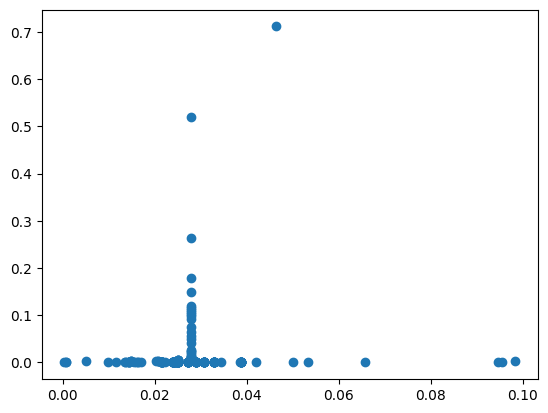

2022-08-21 05:34:15.623 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:15.625 | INFO     | __main__:apply_mean:92 - [0.01692794118230705, 0.024647166579588306, 0.024647166579588306, 0.024647166579588306, 0.024647166579588306, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.030670181860316677, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.02393988466230303, 0.02393988466230303, 0.02393

2022-08-21 05:34:15.643 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:15.646 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:15.650 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:15.668 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:15.670 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:15.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:15.697 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:15.699 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:15.710 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994], [0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672

2022-08-21 05:34:15.729 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:15.732 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:15.734 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.0001

2022-08-21 05:34:15.744 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.745 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:15.748 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192], [0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262

2022-08-21 05:34:15.757 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.760 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:15.763 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242], [0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.0111672645

2022-08-21 05:34:15.786 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:15.789 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:15.792 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000151525

2022-08-21 05:34:15.811 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.814 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.818 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266

2022-08-21 05:34:15.832 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:15.837 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:15.841 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.00015152

2022-08-21 05:34:15.850 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.851 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:15.854 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0273712620992

2022-08-21 05:34:15.870 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.872 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:15.875 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572

2022-08-21 05:34:15.889 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:15.891 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:15.895 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262099219994, 0.000151525

2022-08-21 05:34:15.904 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.906 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:15.916 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.0273712620992

2022-08-21 05:34:15.925 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:15.926 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:15.929 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.06576969005720994, 0.01403061476867192, 0.015954333253557242, 0.017901212722683087, 0.035819894472742, 0.03553476683885029, 0.0069060994781692895, 0.049612531543028186, 0.05707283539127708, 0.0013633823042851266, 0.08643805838900548, 0.039658368975926166, 0.029715162041294693, 0.011167264572266706, 0.027371262

2022-08-21 05:34:15.943 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:15.946 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.950 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.01883476091150951, 0.009652112933043352, 0.051775590

2022-08-21 05:34:15.960 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:15.966 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:15.969 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.01883476091150951, 0.009652112933043352, 0.05177559017850692, 0.014981636

2022-08-21 05:34:15.977 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:15.979 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:15.982 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.01883476091150951, 0.009652112933043352, 0.05177559017850692, 0.01498

2022-08-21 05:34:15.990 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:15.992 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:15.995 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.01883476091150951, 0.009652112933043352, 0.051775590

2022-08-21 05:34:16.017 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:16.019 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.021 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.02213367863746221, 0.0007562821839794107, 0.05340374122740137, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.01883476091150951, 0.0096

2022-08-21 05:34:16.036 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:16.039 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.043 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.02213367863746221, 0.0007562821839794107, 0.05340374122740137, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574

2022-08-21 05:34:16.053 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:16.056 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:16.062 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.02213367863746221, 0.0007562821839794107, 0.05340374122740137, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.01883

2022-08-21 05:34:16.071 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:16.073 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.077 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.02213367863746221, 0.0007562821839794107, 0.05340374122740137, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.018834760

2022-08-21 05:34:16.093 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.095 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:16.099 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.02213367863746221, 0.0007562821839794107, 0.05340374122740137, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.0188

2022-08-21 05:34:16.112 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.115 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.118 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.02213367863746221, 0.0007562821839794107, 0.05340374122740137, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.01883476

2022-08-21 05:34:16.129 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.131 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:16.133 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.02213367863746221, 0.0007562821839794107, 0.05340374122740137, 0.09461975230992861, 0.015539727721045725, 0.00031700001502681633, 0.014484570175816693, 0.0012536564255067138, 0.005507732894502226, 0.04480793667634587, 0.013664517742065074, 0.02141948834542571, 0.021001174636204184, 0.05819574015167372, 0.0188

2022-08-21 05:34:16.146 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.148 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.153 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092

2022-08-21 05:34:16.162 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.165 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.173 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.0116731391

2022-08-21 05:34:16.186 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.189 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:16.191 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177

2022-08-21 05:34:16.201 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:16.202 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.209 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.0145292

2022-08-21 05:34:16.217 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:16.219 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.221 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.01452924

2022-08-21 05:34:16.233 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:16.235 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.236 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.014529

2022-08-21 05:34:16.246 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:16.248 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.249 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.01452924

2022-08-21 05:34:16.257 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:16.258 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.260 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.014529

2022-08-21 05:34:16.267 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:16.273 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.279 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177

2022-08-21 05:34:16.289 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:16.291 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.301 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.01452924

2022-08-21 05:34:16.308 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:16.310 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.313 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.028016940924

2022-08-21 05:34:16.321 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:16.323 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:16.326 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694

2022-08-21 05:34:16.348 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.351 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.355 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092

2022-08-21 05:34:16.365 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.368 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.378 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.0116731391

2022-08-21 05:34:16.396 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.399 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.403 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092

2022-08-21 05:34:16.418 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:16.422 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.426 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.0116731391

2022-08-21 05:34:16.436 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:16.438 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.441 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.014529241

2022-08-21 05:34:16.452 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:16.455 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.457 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.014529

2022-08-21 05:34:16.480 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:16.482 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.487 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.01452924

2022-08-21 05:34:16.498 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:16.501 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.504 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.028016940924

2022-08-21 05:34:16.514 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:16.516 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.519 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.01167313917

2022-08-21 05:34:16.531 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:16.533 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:16.536 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.014529241

2022-08-21 05:34:16.548 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:16.550 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:16.554 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.028016940924

2022-08-21 05:34:16.576 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:16.578 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.583 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.0116731391

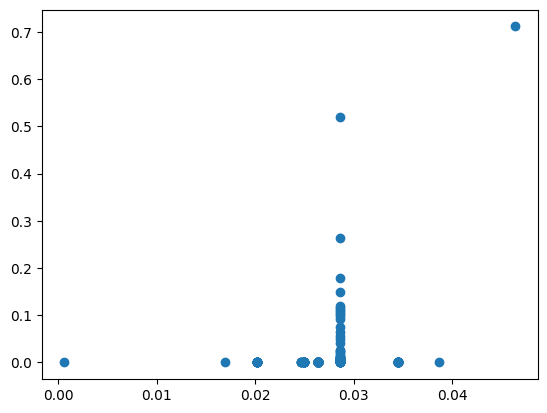

2022-08-21 05:34:16.929 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:16.931 | INFO     | __main__:apply_mean:92 - [0.01692794118230705, 0.024647166579588306, 0.024647166579588306, 0.024647166579588306, 0.024647166579588306, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.026

2022-08-21 05:34:16.944 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:16.945 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.948 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177

2022-08-21 05:34:16.963 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:16.965 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.970 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177

2022-08-21 05:34:16.985 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:16.987 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:16.991 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177

2022-08-21 05:34:17.003 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:17.005 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:17.009 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177

2022-08-21 05:34:17.020 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:17.022 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:17.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177

2022-08-21 05:34:17.037 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:17.039 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:17.042 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.01452924

2022-08-21 05:34:17.051 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:17.066 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:17.072 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.014529

2022-08-21 05:34:17.080 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:17.082 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:17.085 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.02801694092465653, 0.01452924

2022-08-21 05:34:17.093 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:17.096 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:17.099 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.011673139177683318, 0.028016940924

2022-08-21 05:34:17.114 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:17.116 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:17.118 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.01692794118230705], [0.03605395075454739, 0.009260497645364008, 0.04615599798549752, 0.007118219932944299], [0.004485227789797347, 0.042438301078238004, 0.014609054331444812, 0.01049263071719687, 0.057662387038974264, 0.02946146834819012, 0.009529269335619405, 0.06541761217304437, 0.0006773912084179032, 0.04285569018958407, 0.010231208420404743, 0.011565955604367998], [0.011607768041051668, 0.0419791215576527, 0.00115692494368535, 0.02598356159278268, 0.054515988284711867, 0.028431224796999565, 0.052205538729402645, 0.010271412466231174, 0.036663282289629735, 0.0008986598770836269, 0.04831556283899725, 0.012253986224316936, 0.04980266537725608, 0.01167313917

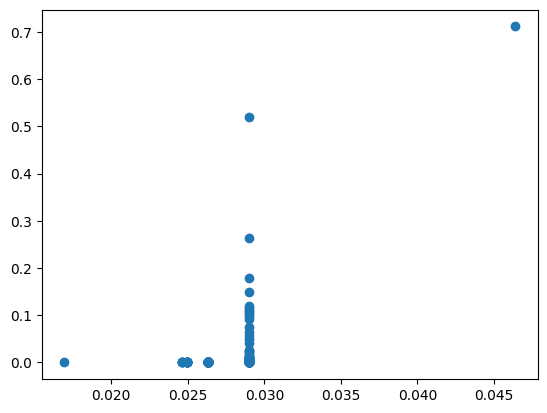

2022-08-21 05:34:17.390 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:17.393 | INFO     | __main__:apply_mean:92 - [0.01692794118230705, 0.024647166579588306, 0.024647166579588306, 0.024647166579588306, 0.024647166579588306, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.024952183019606663, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.02633035757735241, 0.026

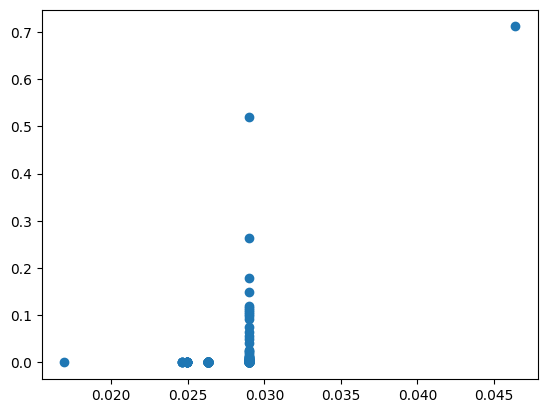

2022-08-21 05:34:17.623 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.007719225397281256, 0.0, 0.0, 0.0, 0.0003050164400183568, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0013781745577457483, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.002676320453235969, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.

2022-08-21 05:34:17.749 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:17.754 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:17.758 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.02593594100038958], [0.0032341855131083133], [0.020560835252401537], [0.05236233527882231], [0.005749011407445217], [0.014220210973602158], [0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.02497

2022-08-21 05:34:17.768 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:17.770 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:17.772 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231], [0.005749011407445217], [0.014220210973602158], [0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103],

2022-08-21 05:34:17.781 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:17.784 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:17.788 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231], [0.005749011407445217], [0.014220210973602158], [0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.0249790

2022-08-21 05:34:17.806 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:17.808 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:17.811 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231, 0.005749011407445217], [0.014220210973602158], [0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0

2022-08-21 05:34:17.831 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:17.834 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied


Sstar: 0.9407100037894066
Tstar: 1.0
stress: 0.9699020588644024
Sstar: Autograd ArrayBox with value 1.0625603583278789
Tstar: 1.0


2022-08-21 05:34:17.842 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231, 0.005749011407445217], [0.014220210973602158], [0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.005198136084903616], [0.05040595286002661], [0.029598344340749354], [0.03845878670518918], [0.003876539152451431], [0.07793782412421137], [0.04246823769139698], [0.02419339188533771

2022-08-21 05:34:17.863 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:17.865 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:17.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158], [0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.0249790886

2022-08-21 05:34:17.884 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:17.888 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:17.900 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.0051

2022-08-21 05:34:17.913 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:17.915 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:17.919 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273], [0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.00305163079

2022-08-21 05:34:17.941 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:17.945 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:17.950 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.0032341855131083133, 0.02593594100038958], [0.020560835252401537], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.003051630

2022-08-21 05:34:17.963 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:17.966 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:17.970 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.0032341855131083133, 0.02593594100038958], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537], [0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.00305163079227

2022-08-21 05:34:17.983 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:17.986 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:17.991 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0032341855131083133, 0.02593594100038958], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.02497908866365587

2022-08-21 05:34:18.016 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.019 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.023 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.0032341855131083133, 0.02593594100038958], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606], [0.018119813060432848], [0.007923441192269494], [0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718

2022-08-21 05:34:18.035 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.038 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.043 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.0032341855131083133, 0.02593594100038958], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606], [0.018119813060432848], [0.007923441192269494, 0.0022163498768848844], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.00305163079227

2022-08-21 05:34:18.054 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.062 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.065 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0032341855131083133, 0.02593594100038958], [0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606], [0.007923441192269494, 0.0022163498768848844, 0.018119813060432848], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0

2022-08-21 05:34:18.077 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:18.079 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.082 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.0032341855131083133, 0.02593594100038958], [0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606], [0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.00519813608490

2022-08-21 05:34:18.093 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:18.096 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.098 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.0032341855131083133, 0.02593594100038958], [0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.00519813608490361

2022-08-21 05:34:18.110 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.112 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.117 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.0032341855131083133, 0.02593594100038958], [0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398], [0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.

2022-08-21 05:34:18.129 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.131 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.134 | INFO     | __main__:eval_direction_expand:42 - merging down at index 1 of partition [[0.0032341855131083133, 0.02593594100038958], [0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [

2022-08-21 05:34:18.145 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.147 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.153 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516

2022-08-21 05:34:18.177 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.179 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.182 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516

2022-08-21 05:34:18.195 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.197 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.200 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793], [0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.005

2022-08-21 05:34:18.211 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.213 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:18.216 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793, 0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516

2022-08-21 05:34:18.227 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.229 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.233 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793, 0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.003051630

2022-08-21 05:34:18.245 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.250 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.253 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793, 0.013646105252447959], [0.0360884887694903], [0.036786684571715154], [0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.00519

2022-08-21 05:34:18.264 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.266 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.270 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793, 0.013646105252447959], [0.0360884887694903], [0.036786684571715154, 0.024912910757246005], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.005

2022-08-21 05:34:18.279 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.281 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.285 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793, 0.013646105252447959], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903], [0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.005198136

2022-08-21 05:34:18.295 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.297 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.301 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.04178652497850793, 0.013646105252447959], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.0051981

2022-08-21 05:34:18.312 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.314 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.325 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.00305163079227181

2022-08-21 05:34:18.343 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.346 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.350 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.00305163079227181

2022-08-21 05:34:18.364 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.371 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.375 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665], [0.024979088663655877], [0.0030516307922718103], [0.0051981360849

2022-08-21 05:34:18.385 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.387 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.391 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.0504890827457641], [0.06395144167131665, 0.024979088663655877], [0.0030516307922718103], [0.00519813608

2022-08-21 05:34:18.411 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.413 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.416 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641], [0.0030516307922718103], [0.00519813608490361

2022-08-21 05:34:18.426 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.431 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:18.435 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103],

2022-08-21 05:34:18.446 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:18.449 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.451 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0504059528600266

2022-08-21 05:34:18.476 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.479 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.484 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:18.501 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:18.503 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.507 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:18.517 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:18.518 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.524 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [

2022-08-21 05:34:18.535 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.537 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:18.541 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:18.553 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:18.569 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.572 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:18.582 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.589 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.593 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:18.610 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:18.614 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.616 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:18.638 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:18.647 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.650 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:18.666 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:18.668 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.670 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:18.682 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.684 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.688 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:18.699 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.702 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:18.705 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:18.726 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:18.728 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.731 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:18.740 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.743 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.746 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:18.765 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.767 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:18.770 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:18.783 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.787 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:18.796 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:18.810 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:18.812 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.815 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:18.826 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:18.829 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:18.831 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:18.841 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.843 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.846 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:18.867 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:18.868 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:18.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:18.883 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.885 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.890 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:18.904 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.906 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.910 | INFO     | __main__:eval_direction_expand:42 - merging down at index 13 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:18.919 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.922 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.926 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:18.944 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.946 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.949 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:18.962 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.964 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:18.967 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:18.984 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:18.985 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:18.989 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:19.003 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.005 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:19.010 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:19.022 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.024 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.028 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:19.047 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.050 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.054 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.068 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.072 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.075 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:19.084 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.086 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.090 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:19.101 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.109 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.112 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:19.124 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.127 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.130 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:19.143 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.145 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.148 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:19.169 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.171 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.176 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:19.187 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.190 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.193 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:19.214 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.215 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.219 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:19.228 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.230 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.234 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.245 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.248 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.250 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:19.271 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.274 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.280 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:19.294 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.296 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.302 | INFO     | __main__:stabilize_block:65 - at end of iteration 17, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.319 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.338 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.342 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:19.359 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.362 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:19.366 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:19.382 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.384 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.387 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:19.397 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.399 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.405 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.423 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.426 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.431 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:19.444 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.446 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.452 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.483 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.486 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.489 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:19.513 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.515 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:19.521 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:19.541 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.544 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.548 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:19.577 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:19.581 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.585 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:19.604 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.608 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.624 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:19.641 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.644 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.650 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:19.669 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.671 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:19.675 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:19.686 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.689 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.694 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:19.715 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.721 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.729 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.743 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.745 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:19.769 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.771 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:19.776 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:19.795 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.797 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.800 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:19.812 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.815 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.819 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:19.832 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.834 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.840 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:19.853 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.854 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.859 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:19.876 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.878 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.883 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.908 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.911 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:19.915 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:19.930 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:19.934 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:19.945 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:19.963 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:19.965 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:19.967 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:19.978 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:19.980 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:19.993 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:20.007 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:20.010 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:20.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:20.034 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.038 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.046 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.064 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.069 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:20.074 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:20.084 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.087 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:20.090 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:20.100 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.102 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.104 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:20.127 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.129 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.133 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:20.150 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:20.153 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.158 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:20.176 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:20.179 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:20.183 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:20.213 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:20.216 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.223 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:20.243 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.245 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.251 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:20.268 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:20.271 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.275 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:20.289 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:20.310 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:20.313 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:20.331 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:20.334 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:20.342 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:20.360 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.377 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:20.385 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:20.402 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.410 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:20.416 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:20.437 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.440 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:20.449 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:20.463 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.465 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.467 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:20.482 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:20.485 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.491 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:20.502 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.504 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.506 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:20.523 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.531 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.534 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:20.545 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.547 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.549 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.572 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.575 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.580 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:20.595 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.597 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.599 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.615 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.618 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.621 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:20.635 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.636 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.638 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.656 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:20.658 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.662 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:20.671 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.672 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.688 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:20.689 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.693 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:20.704 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.706 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.708 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.720 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:20.722 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.724 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:20.745 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.747 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.749 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.762 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.764 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:20.769 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:20.780 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.782 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:20.785 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:20.797 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:20.803 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:20.812 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:20.832 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:20.833 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.836 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:20.851 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:20.853 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:20.856 | INFO     | __main__:eval_direction_expand:42 - merging down at index 28 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:20.869 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:20.870 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:20.873 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:20.885 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.887 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:20.890 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:20.904 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.916 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:20.919 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:20.927 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.933 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:20.937 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:20.945 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.947 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.951 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:20.962 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:20.965 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:20.982 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.000 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.006 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.008 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:21.020 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.022 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.034 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.036 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:21.043 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:21.054 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.056 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.059 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:21.069 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.077 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.079 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:21.088 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.091 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.094 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:21.108 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.110 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.112 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.127 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.130 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.132 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:21.146 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.148 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.150 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.159 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.161 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.164 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:21.188 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.189 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:21.192 | INFO     | __main__:eval_direction_expand:42 - merging down at index 31 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:21.216 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.217 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.220 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:21.232 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.234 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.237 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:21.248 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.249 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.252 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.272 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.282 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.284 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.297 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.299 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.302 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:21.318 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.320 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:21.323 | INFO     | __main__:eval_direction_expand:42 - merging down at index 31 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:21.334 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.336 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.339 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:21.349 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.351 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.353 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:21.364 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.369 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.372 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.384 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.386 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.389 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.400 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.402 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.404 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:21.431 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.434 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.436 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.465 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.467 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.470 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:21.480 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.482 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:21.486 | INFO     | __main__:eval_direction_expand:42 - merging down at index 31 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:21.495 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.506 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.509 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:21.520 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.522 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.524 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:21.540 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.542 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:21.545 | INFO     | __main__:eval_direction_expand:42 - merging down at index 29 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:21.554 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.556 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.562 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.573 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:21.575 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.580 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.592 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:21.595 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.599 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.610 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:21.612 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:21.615 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:21.631 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:21.633 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:21.636 | INFO     | __main__:eval_direction_expand:42 - merging down at index 36 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:21.649 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:21.651 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.660 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.678 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.680 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.682 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:21.692 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.694 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.698 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.711 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.713 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:21.716 | INFO     | __main__:eval_direction_expand:42 - merging down at index 37 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:21.726 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.729 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.733 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:21.742 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:21.760 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.762 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:21.777 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:21.780 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.786 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:21.803 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.806 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.808 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.819 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.821 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:21.824 | INFO     | __main__:eval_direction_expand:42 - merging up at index 38 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:21.835 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.837 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.842 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:21.855 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.859 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.862 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:21.871 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.873 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:21.876 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:21.887 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.888 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.891 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:21.900 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.902 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:21.905 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:21.914 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.916 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.920 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:21.931 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:21.933 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:21.935 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:21.944 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:21.946 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:21.949 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:21.959 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:21.961 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:21.963 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:21.984 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.986 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:21.988 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:21.996 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:21.998 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:22.001 | INFO     | __main__:eval_direction_expand:42 - merging down at index 40 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:22.009 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.011 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:22.014 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:22.022 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.028 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:22.032 | INFO     | __main__:eval_direction_expand:42 - merging down at index 39 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981360849036

2022-08-21 05:34:22.040 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.042 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:22.045 | INFO     | __main__:eval_direction_expand:42 - merging up at index 38 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:22.053 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.055 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.062 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:22.069 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:22.071 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.073 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:22.084 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.087 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:22.091 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0

2022-08-21 05:34:22.138 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:22.140 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:22.145 | INFO     | __main__:eval_direction_expand:42 - merging down at index 41 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:22.164 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:22.168 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:22.174 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:22.199 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.202 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.209 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

2022-08-21 05:34:22.229 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:22.234 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.239 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407493

2022-08-21 05:34:22.270 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:22.273 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.277 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295983443407

2022-08-21 05:34:22.298 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:22.300 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.303 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:22.313 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.315 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:22.319 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00

2022-08-21 05:34:22.331 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:22.333 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.335 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:22.345 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.347 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:22.350 | INFO     | __main__:eval_direction_expand:42 - merging up at index 42 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:22.359 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.361 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:22.364 | INFO     | __main__:eval_direction_expand:42 - merging down at index 42 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490361

2022-08-21 05:34:22.387 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.388 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:22.391 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:22.408 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:22.412 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074

2022-08-21 05:34:22.434 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:22.436 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.440 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:22.452 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:22.454 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.460 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749

2022-08-21 05:34:22.467 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.469 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:22.471 | INFO     | __main__:eval_direction_expand:42 - merging up at index 43 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], 

2022-08-21 05:34:22.481 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.483 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.485 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0

2022-08-21 05:34:22.496 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.498 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:22.501 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616],

2022-08-21 05:34:22.510 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:22.512 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.515 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 

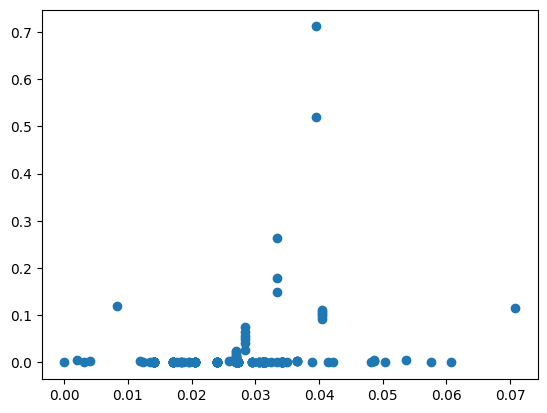

2022-08-21 05:34:22.792 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:22.793 | INFO     | __main__:apply_mean:92 - [0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.041379185086357864, 0.05038783726572216, 0.003057121767692795, 0.01398609116629924, 0.026931231078923475, 0.026931231078923475, 0.026931231078923475, 0.026931231078923475, 0.026931231078923475, 0.026931231078923475, 0.04816690455866171, 0.013456896662448415, 0.029533875991582408, 0.029533875991582408, 0.029533875991582408, 0.029533875991582408, 0.029533875991582408, 0.030584905764604143, 0.030584905764604143, 0.030584905764604143, 0.030584905764604143, 0.03125404830207636, 0.03125404830207636, 0.03125404830207636, 0.03125404830207636, 0.03125404

2022-08-21 05:34:22.812 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:22.814 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.819 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:22.844 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:22.848 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.853 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216], [0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.

2022-08-21 05:34:22.872 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:22.876 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.883 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.041379185086357864], [0.05038783726572216, 0.003057121767692795], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074935

2022-08-21 05:34:22.902 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:22.904 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.909 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864], [0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.02959834434074935

2022-08-21 05:34:22.928 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:22.932 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:22.936 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0

2022-08-21 05:34:22.954 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.957 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:22.964 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924], [0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0295

2022-08-21 05:34:22.991 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:22.994 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:22.997 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.0051981

2022-08-21 05:34:23.012 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.014 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.018 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.04816690455866171], [0.013456896662448415], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813

2022-08-21 05:34:23.030 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:23.032 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.034 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171], [0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0.05

2022-08-21 05:34:23.047 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:23.048 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.055 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0.05040

2022-08-21 05:34:23.071 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:23.075 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.082 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.00519813608490

2022-08-21 05:34:23.101 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:23.103 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:23.108 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084

2022-08-21 05:34:23.119 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:23.123 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:23.126 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084

2022-08-21 05:34:23.136 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:23.138 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.141 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0.05040

2022-08-21 05:34:23.151 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:23.153 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.156 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0.050

2022-08-21 05:34:23.179 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:23.181 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.187 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0.05040

2022-08-21 05:34:23.196 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:23.206 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.213 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0.050

2022-08-21 05:34:23.242 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:23.245 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.248 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.029598344340749354, 0.05040

2022-08-21 05:34:23.266 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:23.269 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.272 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.0607788843944678, 0.01235

2022-08-21 05:34:23.286 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:23.291 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:23.298 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.013456896662448415, 0.04816690455866171, 0.06395144167131665, 0.024979088663655877, 0.0504890827457641, 0.0030516307922718103, 0.005198136084903616], [0.060778

2022-08-21 05:34:23.308 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:23.316 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.323 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.05038783726572216, 0.003057121767692795, 0.041379185086357864, 0.01398609116629924, 0.036786684571715154, 0.024912910757246005, 0.0360884887694903, 0.008366672144133478, 0.04178652497850793, 0.013646105252447959], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.0338456571537

2022-08-21 05:34:23.336 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:23.339 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.342 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006351337974045652, 0.044

2022-08-21 05:34:23.358 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:23.365 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:23.367 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.04280452

2022-08-21 05:34:23.377 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:23.379 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.381 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006351337974045652, 0.0443

2022-08-21 05:34:23.400 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:23.401 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:23.404 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006351337

2022-08-21 05:34:23.414 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:23.416 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:23.419 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.04280452

2022-08-21 05:34:23.440 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.443 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.446 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:23.463 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.465 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.468 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:23.482 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.484 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:23.486 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.0063513

2022-08-21 05:34:23.497 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.499 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:23.502 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006

2022-08-21 05:34:23.512 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.514 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.516 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:23.524 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.535 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:23.539 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.0063513

2022-08-21 05:34:23.547 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.549 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:23.552 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.0428045

2022-08-21 05:34:23.566 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:23.568 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.571 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006351337974045652, 0.04432

2022-08-21 05:34:23.581 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:23.582 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.584 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006351337974045652, 0.04

2022-08-21 05:34:23.594 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:23.596 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:23.598 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006351337974045652, 0.0443

2022-08-21 05:34:23.610 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:23.612 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:23.631 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.00635133

2022-08-21 05:34:23.642 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:23.644 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:23.651 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.04280452

2022-08-21 05:34:23.666 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.670 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.672 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:23.682 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.684 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:23.686 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.0063513

2022-08-21 05:34:23.695 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.696 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:23.700 | INFO     | __main__:eval_direction_expand:42 - merging down at index 13 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006

2022-08-21 05:34:23.722 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.724 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:23.729 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.0063513

2022-08-21 05:34:23.743 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.746 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:23.749 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006

2022-08-21 05:34:23.763 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.767 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:23.770 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.0063513

2022-08-21 05:34:23.784 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.786 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:23.790 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006

2022-08-21 05:34:23.804 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.806 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.809 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:23.819 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:23.821 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.824 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:23.835 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:23.837 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:23.840 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.04280452243

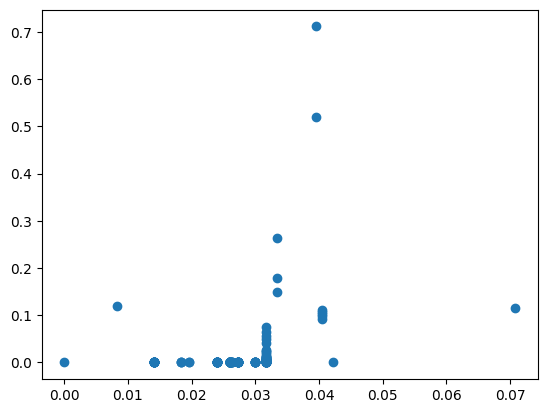

2022-08-21 05:34:24.079 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:24.081 | INFO     | __main__:apply_mean:92 - [0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604703572592585, 0.02604

2022-08-21 05:34:24.090 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:24.095 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:24.097 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:24.110 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:24.114 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:24.118 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522

2022-08-21 05:34:24.135 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:24.137 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:24.143 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042804522438794256, 0.006351337974045652, 0.0443

2022-08-21 05:34:24.158 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:24.165 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:24.169 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.0

2022-08-21 05:34:24.182 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:24.184 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:24.188 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042

2022-08-21 05:34:24.198 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:24.201 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:24.205 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.00652227

2022-08-21 05:34:24.216 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:24.228 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:24.231 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.94753497

2022-08-21 05:34:24.246 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:24.249 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:24.251 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.0428

2022-08-21 05:34:24.270 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:24.273 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:24.277 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.94753497672

2022-08-21 05:34:24.291 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:24.295 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:24.300 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976

2022-08-21 05:34:24.321 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:24.322 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:24.325 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976

2022-08-21 05:34:24.336 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:24.338 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:24.341 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976

2022-08-21 05:34:24.351 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:24.353 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:24.358 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976

2022-08-21 05:34:24.369 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:24.371 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:24.373 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042

2022-08-21 05:34:24.385 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:24.388 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:24.399 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.0

2022-08-21 05:34:24.406 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:24.408 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:24.411 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.947534976729783e-05, 0.006522273822743733, 0.042

2022-08-21 05:34:24.421 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:24.423 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:24.426 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.007923441192269494, 0.0022163498768848844, 0.018119813060432848, 0.05236233527882231, 0.005749011407445217, 0.014220210973602158, 0.018236736277964273, 0.005493554990552303, 0.020560835252401537, 0.00950451253079606, 0.011519591805617398, 0.001830615054213441, 0.0032341855131083133, 0.02593594100038958], [0.04212733016784777, 3.8160471367510014e-05, 0.0607788843944678, 0.012352870227116343, 0.03887516982081124, 0.020008066955070212, 0.003955904458661773, 0.053715917370889155, 0.03384565715376952, 0.016832686477352365, 0.027052414573110396, 0.011049908513982855, 0.024752703260679625, 0.01722191831094709, 0.0008407395593663169, 0.005901779446084511, 7.94753497672

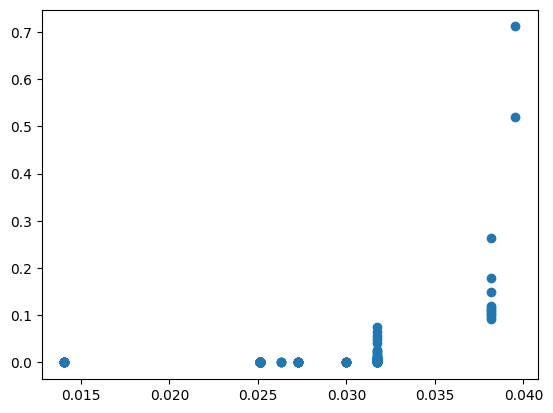

2022-08-21 05:34:24.711 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:24.714 | INFO     | __main__:apply_mean:92 - [0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.014064795301035707, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512371532132718, 0.02512

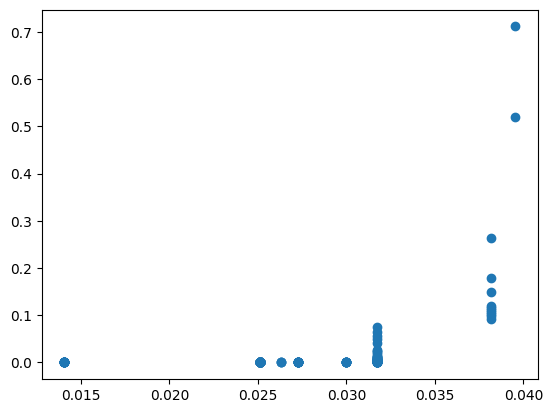

2022-08-21 05:34:24.952 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.011058920020291475, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.001186730707906987, 0.0, 0.0, 0.0009497064270816216, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0027150297532224817, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.001783645627176443, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

Sstar: 0.913728124698955
Tstar: 1.0
stress: 0.9558912724253502


2022-08-21 05:34:25.280 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:25.283 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.290 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.007113558517998964], [0.00992164654239357], [0.0005977409812225236], [0.04698368935217838], [0.03572198389801657], [0.017191231380222112], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.01

2022-08-21 05:34:25.309 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.313 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.318 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.007113558517998964], [0.00992164654239357], [0.0005977409812225236], [0.04698368935217838], [0.03572198389801657], [0.017191231380222112], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0

2022-08-21 05:34:25.336 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.338 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:25.342 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.003007387920283013], [0.007113558517998964], [0.00992164654239357], [0.0005977409812225236], [0.04698368935217838], [0.03572198389801657], [0.017191231380222112], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.

2022-08-21 05:34:25.354 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.356 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:25.360 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.003007387920283013], [0.007113558517998964], [0.00992164654239357, 0.0005977409812225236], [0.04698368935217838], [0.03572198389801657], [0.017191231380222112], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [

2022-08-21 05:34:25.379 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.381 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.386 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.04698368935217838], [0.03572198389801657], [0.017191231380222112], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.01619

2022-08-21 05:34:25.401 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.404 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:25.409 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.04698368935217838], [0.03572198389801657], [0.017191231380222112], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.0225

2022-08-21 05:34:25.421 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.424 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:25.428 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.04698368935217838], [0.03572198389801657, 0.017191231380222112], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.02

Sstar: Autograd ArrayBox with value 1.0245048682443014
Tstar: 1.0


2022-08-21 05:34:25.432 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:25.434 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.436 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838], [0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.

2022-08-21 05:34:25.456 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:25.458 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.461 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.0484

2022-08-21 05:34:25.471 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:25.474 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:25.477 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733], [0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.02250399181

2022-08-21 05:34:25.503 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:25.509 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:25.514 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.016194098172

2022-08-21 05:34:25.528 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.531 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.536 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.046267871952436174], [0.020605760964929158], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721

2022-08-21 05:34:25.556 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:25.558 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.560 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.020605760964929158, 0.046267871952436174], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.0484124

2022-08-21 05:34:25.581 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:25.584 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:25.589 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.020605760964929158, 0.046267871952436174], [0.04441539218517439], [0.02004977851007537], [0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.016194098172198

2022-08-21 05:34:25.606 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:25.608 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.020605760964929158, 0.046267871952436174], [0.04441539218517439], [0.02004977851007537, 0.0073203466354173465], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.0484124184

2022-08-21 05:34:25.620 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:25.622 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.625 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.020605760964929158, 0.046267871952436174], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.0484124184

2022-08-21 05:34:25.635 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:25.637 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:25.640 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.020605760964929158, 0.046267871952436174], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030

2022-08-21 05:34:25.649 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:25.651 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.654 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.

2022-08-21 05:34:25.667 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.670 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.673 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174], [0.039381596748291954], [0.02295221029906703], [0.012069813062353054], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0

2022-08-21 05:34:25.684 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:25.688 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.705 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174], [0.039381596748291954], [0.012069813062353054, 0.02295221029906703], [0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.048412418447825

2022-08-21 05:34:25.716 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:25.719 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.721 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174], [0.039381596748291954], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.04841241844782592]

2022-08-21 05:34:25.736 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:25.737 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.740 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.04841241844782592]

2022-08-21 05:34:25.750 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:25.752 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:25.757 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0

2022-08-21 05:34:25.768 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:25.770 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.02250399

2022-08-21 05:34:25.785 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:25.787 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.790 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.04841241844782592], [0.

2022-08-21 05:34:25.803 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:25.821 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:25.824 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694], [0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991

2022-08-21 05:34:25.844 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:25.847 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.851 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694, 0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.04841241844782592], [0.026

2022-08-21 05:34:25.866 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:25.875 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:25.880 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694, 0.007275974083367052], [0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.048412418

2022-08-21 05:34:25.900 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:25.902 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:25.905 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.01839724159516072], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.0484124

2022-08-21 05:34:25.924 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.927 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.930 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030

2022-08-21 05:34:25.941 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:25.943 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:25.948 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.04446649089712295], [0.01320114513900127], [0.021407505633413627], [0.0161940981721981], [0.022503991816030

2022-08-21 05:34:25.964 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:25.966 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.973 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295], [0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.04841241844782592], [0.02623563

2022-08-21 05:34:25.990 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:25.992 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:25.995 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.04841241844782592], [0.02623563750

2022-08-21 05:34:26.009 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.012 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:26.016 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627], [0.0161940981721981], [0.022503991816030584], [0.04841241844782592

2022-08-21 05:34:26.034 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.036 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.040 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627, 0.0161940981721981], [0.022503991816030584],

2022-08-21 05:34:26.050 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.053 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.055 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627, 0.0161940981721981, 0.022503991816030584], [0.04841241844782592], [0.0262356375013660

2022-08-21 05:34:26.069 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.070 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.073 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627, 0.0161940981721981, 0.022503991816030584], [0.0

2022-08-21 05:34:26.086 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.091 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.095 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627, 0.0161940981721981, 0.022503991816030584], [0.04841241844782592], [0.026235637501366

2022-08-21 05:34:26.103 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.104 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.106 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627, 0.0161940981721981, 0.022503991816030584], [0.026235637501366038, 0.01134688484081

2022-08-21 05:34:26.117 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.119 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.122 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.01320114513900127, 0.04446649089712295, 0.021407505633413627, 0.0161940981721981, 0.022503991816030584], [0.026235637501366038, 0.0113468848408189

2022-08-21 05:34:26.135 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.138 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.143 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.04446649089712295, 0.021407505633413

2022-08-21 05:34:26.162 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.165 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.167 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.04446649089712295, 0.02140750563341362

2022-08-21 05:34:26.179 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.182 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:26.186 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.04446649089712295, 0.

2022-08-21 05:34:26.196 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.209 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.212 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 

2022-08-21 05:34:26.223 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.230 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.231 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.04446649089712295, 0.021407505633413627

2022-08-21 05:34:26.241 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.242 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:26.246 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.04446649089712295, 0.

2022-08-21 05:34:26.259 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.261 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.264 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127,

2022-08-21 05:34:26.282 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:26.284 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.287 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0

2022-08-21 05:34:26.301 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.304 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.308 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.04446649089712295, 0.0214075056334136

2022-08-21 05:34:26.318 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.320 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:26.323 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.04446649089712295

2022-08-21 05:34:26.342 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.343 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.347 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114513900127, 0.

2022-08-21 05:34:26.357 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.360 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.365 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:26.373 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.375 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.385 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:26.396 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.398 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:26.402 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:26.411 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.414 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:26.422 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:26.430 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:26.432 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:26.436 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592

2022-08-21 05:34:26.456 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:26.458 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.462 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:26.473 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.475 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.477 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:26.498 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.500 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.503 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:26.516 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.518 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.521 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:26.536 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.541 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:26.545 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:26.559 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.562 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.566 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:26.578 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.581 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.587 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:26.597 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.600 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:26.608 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:26.621 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.624 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.632 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:26.648 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.650 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.652 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:26.661 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.663 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.666 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:26.683 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.685 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.689 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:26.702 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.705 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.709 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:26.720 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.722 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.725 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:26.749 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.750 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:26.753 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:26.765 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:26.767 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.771 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:26.781 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:26.783 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.785 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:26.802 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.804 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.806 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:26.819 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.824 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.832 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:26.850 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.852 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:26.854 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:26.869 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.871 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.875 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:26.895 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.900 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.902 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:26.912 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.914 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:26.917 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:26.932 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:26.934 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.936 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:26.949 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:26.951 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:26.953 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:26.963 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.965 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:26.968 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:26.979 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:26.982 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:26.994 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:27.006 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.008 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.011 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:27.022 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.024 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.028 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:27.039 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.044 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.046 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:27.061 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.063 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.071 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:27.078 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.081 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.084 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:27.100 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.103 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.105 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:27.116 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.118 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.122 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:27.137 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.146 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.151 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:27.163 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.167 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.172 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.181 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.184 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:27.187 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:27.200 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.202 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.204 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.216 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.219 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.223 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:27.255 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.260 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:27.290 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.298 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.302 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:27.327 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.331 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:27.335 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:27.347 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:27.349 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.353 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:27.368 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.377 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.379 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.393 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.397 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.400 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:27.414 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.417 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.423 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:27.436 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.440 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.442 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:27.457 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:27.458 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.461 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:27.475 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.477 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.480 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.495 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:27.497 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.502 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:27.515 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.519 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.522 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.538 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.543 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.550 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:27.566 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.568 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.571 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:27.585 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.587 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:27.593 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:27.606 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:27.608 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.612 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:27.629 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:27.631 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:27.635 | INFO     | __main__:eval_direction_expand:42 - merging down at index 20 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:27.648 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:27.651 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.659 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:27.671 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.673 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:27.693 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.696 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.699 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:27.709 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:27.711 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.713 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:27.726 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.729 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.737 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.747 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.749 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:27.756 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:27.771 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.773 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.775 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.802 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.808 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:27.813 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:27.824 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:27.831 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.835 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:27.849 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:27.861 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:27.864 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:27.884 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.887 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.891 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:27.906 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:27.909 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:27.921 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:27.936 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.944 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.954 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:27.965 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.967 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:27.970 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592

2022-08-21 05:34:27.980 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.983 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:27.986 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:27.996 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:27.999 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.017 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:28.027 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.030 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.033 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:28.047 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.050 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:28.052 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:28.064 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.071 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.073 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.086 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.089 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.091 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.105 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.108 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.112 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:28.136 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.139 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.141 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.155 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.158 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.160 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.178 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.181 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.186 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:28.196 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.199 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:28.202 | INFO     | __main__:eval_direction_expand:42 - merging down at index 28 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:28.216 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.218 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:28.221 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:28.229 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.232 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:28.235 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592

2022-08-21 05:34:28.242 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.244 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:28.250 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:28.259 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.265 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.268 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:28.276 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.279 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.282 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:28.306 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.307 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.309 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.322 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.324 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.326 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:28.337 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.339 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:28.342 | INFO     | __main__:eval_direction_expand:42 - merging down at index 29 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:28.353 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.355 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:28.357 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:28.366 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.368 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.371 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:28.387 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.389 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:28.391 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:28.404 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.406 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.413 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:28.424 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.426 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.433 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.450 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.454 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.456 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.466 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.473 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.476 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:28.488 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.490 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.492 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.501 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.509 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.511 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.522 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.524 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.526 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.536 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.538 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.540 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.561 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.563 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.565 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.582 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.584 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.586 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.596 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.598 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.601 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.612 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.616 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:28.634 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:28.653 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.656 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:28.662 | INFO     | __main__:eval_direction_expand:42 - merging down at index 32 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:28.683 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:28.687 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:28.691 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:28.705 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.710 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:28.715 | INFO     | __main__:eval_direction_expand:42 - merging up at index 33 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:28.737 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.740 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.751 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:28.768 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.771 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.773 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:28.782 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.785 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:28.788 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:28.802 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.804 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.806 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.824 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.826 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:28.829 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:28.840 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.841 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.844 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:28.853 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.855 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.857 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:28.882 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:28.883 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.885 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:28.895 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.897 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.899 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.909 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:28.913 | INFO     | __main__:eval_direction_expand:42 - merging up at index 33 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:28.927 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.929 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:28.932 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:28.939 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:28.941 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:28.943 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:28.950 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.952 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:28.955 | INFO     | __main__:eval_direction_expand:42 - merging up at index 33 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:28.964 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:28.975 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:28.981 | INFO     | __main__:eval_direction_expand:42 - merging down at index 33 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:28.990 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:28.991 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:28.994 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:29.003 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.005 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.008 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:29.017 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:29.018 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.020 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:29.030 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.031 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.033 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:29.041 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:29.055 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.057 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:29.066 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.072 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.075 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:29.084 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.086 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:29.089 | INFO     | __main__:eval_direction_expand:42 - merging up at index 33 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:29.102 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.104 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:29.106 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:29.119 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.121 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.124 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:29.133 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:29.134 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.135 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:29.143 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.145 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:29.149 | INFO     | __main__:eval_direction_expand:42 - merging down at index 35 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:29.160 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.162 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.166 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:29.177 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:29.178 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.180 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552

2022-08-21 05:34:29.201 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.202 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:29.205 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:29.216 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.218 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.220 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:29.230 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.232 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:29.235 | INFO     | __main__:eval_direction_expand:42 - merging up at index 37 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:29.251 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.254 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:29.258 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:29.270 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.282 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:29.285 | INFO     | __main__:eval_direction_expand:42 - merging up at index 38 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:29.299 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.301 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:29.304 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:29.316 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.318 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.320 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:29.330 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:29.350 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.361 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:29.373 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.375 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:29.378 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:29.396 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.399 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.401 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:29.410 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:29.412 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.415 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:29.425 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.426 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.433 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:29.442 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.444 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:29.459 | INFO     | __main__:eval_direction_expand:42 - merging up at index 38 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:29.469 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.471 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:29.475 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.

2022-08-21 05:34:29.487 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.488 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.490 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:29.498 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.501 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.512 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:29.524 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.526 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:29.529 | INFO     | __main__:eval_direction_expand:42 - merging down at index 40 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:29.538 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.539 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:29.542 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.0

2022-08-21 05:34:29.551 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.553 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:29.564 | INFO     | __main__:eval_direction_expand:42 - merging down at index 39 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592

2022-08-21 05:34:29.573 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.575 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:29.578 | INFO     | __main__:eval_direction_expand:42 - merging up at index 38 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:29.589 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.592 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:29.596 | INFO     | __main__:eval_direction_expand:42 - merging down at index 38 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592

2022-08-21 05:34:29.603 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.605 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.609 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:29.628 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.629 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:29.637 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.

2022-08-21 05:34:29.647 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:29.649 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:29.653 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0

2022-08-21 05:34:29.666 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.669 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.671 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 

2022-08-21 05:34:29.684 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.686 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.689 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:29.701 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.702 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.704 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:29.728 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:29.732 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.734 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791769855

2022-08-21 05:34:29.745 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:29.746 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:29.749 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552,

2022-08-21 05:34:29.762 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.764 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.767 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

2022-08-21 05:34:29.777 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.778 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:29.781 | INFO     | __main__:eval_direction_expand:42 - merging down at index 43 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592,

2022-08-21 05:34:29.795 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:29.797 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.800 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04

2022-08-21 05:34:29.810 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:29.812 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:29.814 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048

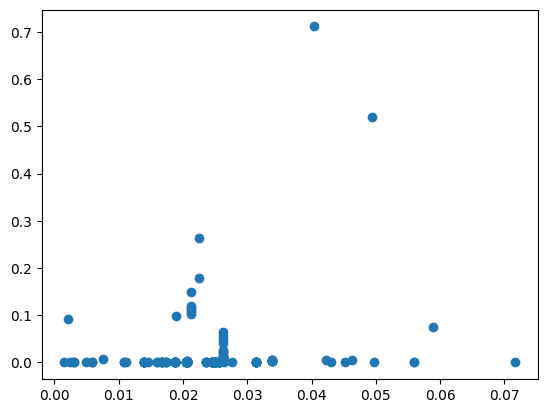

2022-08-21 05:34:30.067 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:30.069 | INFO     | __main__:apply_mean:92 - [0.003007387920283013, 0.0058776486805383514, 0.0058776486805383514, 0.0058776486805383514, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.025673304849845178, 0.026347811425984122, 0.002412910097681994, 0.014518743108345358, 0.01735880019374323, 0.01735880019374323, 0.01735880019374323, 0.01735880019374323, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.01878953948960535, 0.0187895394896053

2022-08-21 05:34:30.081 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.085 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.088 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:30.097 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.100 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.102 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:30.115 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.117 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.120 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122], [0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0

2022-08-21 05:34:30.129 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.132 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.135 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.026347811425984122, 0.002412910097681994], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0

2022-08-21 05:34:30.143 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.146 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.149 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473], [0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0

2022-08-21 05:34:30.162 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.164 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.167 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.013

2022-08-21 05:34:30.191 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:30.192 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:30.196 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358], [0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820

2022-08-21 05:34:30.206 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:30.208 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.212 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072], [0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241

2022-08-21 05:34:30.224 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.229 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.232 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114

2022-08-21 05:34:30.241 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:30.243 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:30.247 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917

2022-08-21 05:34:30.256 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:30.259 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.262 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.0484124184

2022-08-21 05:34:30.273 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:30.276 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:30.279 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.00279820791

2022-08-21 05:34:30.289 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:30.294 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.297 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.048412418

2022-08-21 05:34:30.308 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.310 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.312 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320114

2022-08-21 05:34:30.324 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.326 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.328 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.01320

2022-08-21 05:34:30.340 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.342 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.344 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.03572198389801657, 0.017191231380222112, 0.04698368935217838, 0.025020433901296733, 0.006822051619287473, 0.014518743108345358, 0.042388775666809694, 0.007275974083367052, 0.0013732094296354583, 0.01839724159516072, 0.00974156476849436, 0.0213271589151856, 0.02254752974477742, 0.026235637501366038, 0.011346884840818933, 0.04841241844782592, 0.002798207917698552, 0.0132011

2022-08-21 05:34:30.358 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.360 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.363 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 

2022-08-21 05:34:30.373 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.375 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.410 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.419 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.421 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:30.424 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.0

2022-08-21 05:34:30.434 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.436 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:30.438 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.04626

2022-08-21 05:34:30.451 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:30.452 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.456 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020

2022-08-21 05:34:30.465 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.467 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.470 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.0

2022-08-21 05:34:30.477 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:30.478 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:30.482 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.0206057

2022-08-21 05:34:30.492 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.494 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.496 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:30.506 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.508 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.509 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 

2022-08-21 05:34:30.520 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.522 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.524 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:30.535 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.537 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.540 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 

2022-08-21 05:34:30.561 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.566 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.577 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:30.590 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:30.592 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:30.596 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.04626

2022-08-21 05:34:30.620 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:30.622 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.625 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.0206

2022-08-21 05:34:30.636 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:30.644 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:30.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.658 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.660 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.662 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0

2022-08-21 05:34:30.671 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.673 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.674 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:30.683 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.685 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.695 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 

2022-08-21 05:34:30.705 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.707 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.710 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.724 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.726 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.729 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.753 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.755 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.758 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.769 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.775 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.778 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.788 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.790 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.793 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.812 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.815 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.818 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:30.833 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.836 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.838 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 

2022-08-21 05:34:30.851 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:30.853 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.855 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:30.866 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:30.868 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:30.870 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 

2022-08-21 05:34:30.892 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.897 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.901 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.924 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.927 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.934 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.952 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.957 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.961 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:30.987 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:30.991 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:30.997 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.022 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:31.030 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:31.033 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:31.049 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:31.053 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:31.059 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.0206057

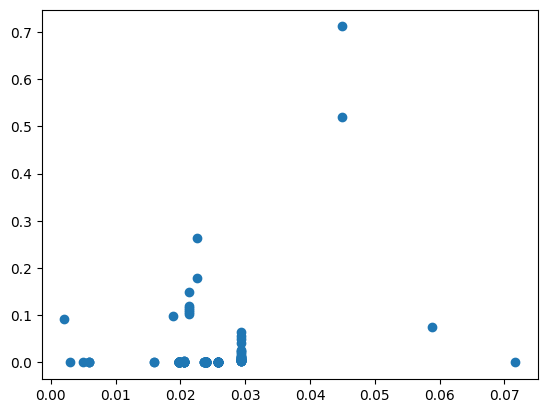

2022-08-21 05:34:31.451 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:31.453 | INFO     | __main__:apply_mean:92 - [0.003007387920283013, 0.0058776486805383514, 0.0058776486805383514, 0.0058776486805383514, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 

2022-08-21 05:34:31.465 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:31.468 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.472 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.483 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:31.486 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.489 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.502 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:31.505 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.508 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.522 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:31.524 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.528 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.552 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:31.554 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.559 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.571 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:31.573 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.577 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.590 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:31.595 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:31.600 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:31.611 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:31.612 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:31.615 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.04626

2022-08-21 05:34:31.625 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:31.627 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.630 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.0206

2022-08-21 05:34:31.644 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:31.646 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:31.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.0

2022-08-21 05:34:31.659 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:31.660 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:31.663 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 

2022-08-21 05:34:31.685 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:31.686 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.689 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.02060

2022-08-21 05:34:31.707 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:31.712 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:31.713 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.

2022-08-21 05:34:31.725 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:31.727 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:31.730 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.04626

2022-08-21 05:34:31.749 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:31.751 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:31.754 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.0

2022-08-21 05:34:31.765 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:31.768 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:31.770 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.0462

2022-08-21 05:34:31.781 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:31.784 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:31.787 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020

2022-08-21 05:34:31.799 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:31.801 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:31.805 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.020605760964929158, 0.046267871952436174, 0.0

2022-08-21 05:34:31.814 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:31.816 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:31.819 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.003007387920283013], [0.00992164654239357, 0.0005977409812225236, 0.007113558517998964], [0.05597033275464246, 0.0015300272553648109, 0.025615642746097504, 0.0011006886810701114, 0.029417169617068514, 0.010770849382930226, 0.012965669790014664, 0.01678265085116469, 0.010527504788185389, 0.014015651715364017, 0.009323085004145299, 0.008448321291747666, 0.027696884647569864, 0.003935681832007437, 0.029400037953023934, 0.006505225685480856, 0.027008767797278132, 0.026347811425984122, 0.002412910097681994, 0.012069813062353054, 0.02295221029906703, 0.014624107389086718, 0.039381596748291954, 0.02004977851007537, 0.0073203466354173465, 0.04441539218517439, 0.0206057

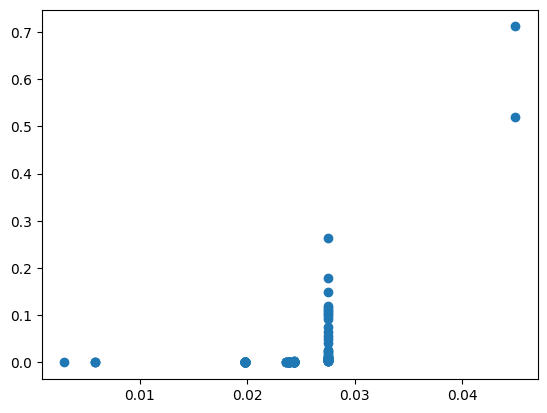

2022-08-21 05:34:32.064 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:32.065 | INFO     | __main__:apply_mean:92 - [0.003007387920283013, 0.0058776486805383514, 0.0058776486805383514, 0.0058776486805383514, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 0.019780711699211743, 

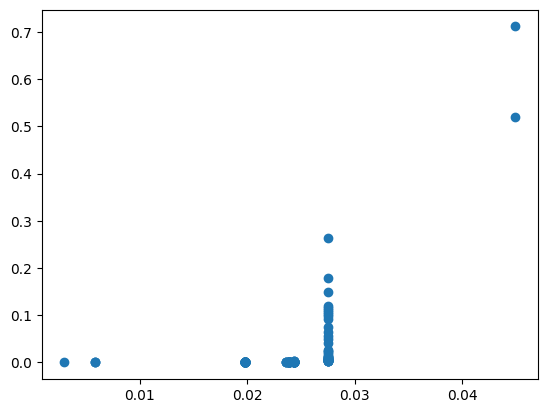

2022-08-21 05:34:32.277 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0028702607602553386, 0.0, 0.0, 0.013903063018673393, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0038399059100280263, 0.0, 0.0, 0.0, 0.0002937093831614501, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0004703884376872289, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003148849466466583, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0

2022-08-21 05:34:32.376 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:32.383 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:32.387 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.026630809277104314], [0.017732943107674683], [0.04866273662465408], [0.06121691013206228], [0.017490353542006055], [0.07867684367247656], [0.019641210206182202], [0.0009607772139835422], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.02546056

2022-08-21 05:34:32.413 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:32.417 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.429 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.04866273662465408], [0.06121691013206228], [0.017490353542006055], [0.07867684367247656], [0.019641210206182202], [0.0009607772139835422], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.

2022-08-21 05:34:32.444 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:32.447 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:32.452 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.04866273662465408], [0.06121691013206228], [0.017490353542006055], [0.07867684367247656], [0.019641210206182202], [0.0009607772139835422], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.0254605665

2022-08-21 05:34:32.468 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.470 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.473 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.04866273662465408], [0.06121691013206228, 0.017490353542006055], [0.07867684367247656], [0.019641210206182202], [0.0009607772139835422], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006

2022-08-21 05:34:32.484 | INFO     | __main__:merge_blocks:28 - merged down


Sstar: 0.8922915291270291
Tstar: 1.0
stress: 0.9446118404546013
Sstar: Autograd ArrayBox with value 0.9759341357193694
Tstar: 1.0


2022-08-21 05:34:32.487 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.490 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.07867684367247656], [0.019641210206182202], [0.0009607772139835422], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.003584154675397303], [0.038796984112191985], [0.0172662

2022-08-21 05:34:32.502 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:32.504 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:32.510 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.07867684367247656], [0.019641210206182202], [0.0009607772139835422], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.02546056652767

2022-08-21 05:34:32.531 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.535 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.537 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.07867684367247656], [0.019641210206182202, 0.0009607772139835422], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.0064494

2022-08-21 05:34:32.550 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:32.553 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.556 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656], [0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.0064494

2022-08-21 05:34:32.591 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.594 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.599 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.00644941681

2022-08-21 05:34:32.614 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:32.617 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.619 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.00644941681

2022-08-21 05:34:32.630 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:32.633 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:32.638 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694], [0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [

2022-08-21 05:34:32.656 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.658 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.661 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242

2022-08-21 05:34:32.671 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:32.673 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:32.676 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482], [0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.02

2022-08-21 05:34:32.686 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.688 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.691 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482, 0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.00644941681424257

2022-08-21 05:34:32.699 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:32.701 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:32.705 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482, 0.015977573309682164], [0.042895119027415274], [0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.0287

2022-08-21 05:34:32.720 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.721 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.724 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482, 0.015977573309682164], [0.042895119027415274, 0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578]

2022-08-21 05:34:32.735 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:32.737 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:32.740 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482, 0.015977573309682164], [0.042895119027415274, 0.03174050301847683], [0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.00

2022-08-21 05:34:32.775 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:32.778 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:32.785 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482, 0.015977573309682164], [0.042895119027415274, 0.03174050301847683, 0.016764370388644936], [0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.02872

2022-08-21 05:34:32.800 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.805 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.807 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.03214007443055482, 0.015977573309682164], [0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.

2022-08-21 05:34:32.817 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:32.820 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.823 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0

2022-08-21 05:34:32.833 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:32.835 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:32.846 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164], [0.028959083067422293], [0.016426403120751942], [0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.0287268726

2022-08-21 05:34:32.863 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:32.867 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164], [0.028959083067422293], [0.016426403120751942, 0.0014573327733885407], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.003

2022-08-21 05:34:32.892 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:32.894 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.897 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.003

2022-08-21 05:34:32.919 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:32.921 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:32.927 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.00644941

2022-08-21 05:34:32.944 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:32.948 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:32.969 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.032603241759017694, 0.010926473951205051], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.02872687267457415

2022-08-21 05:34:32.985 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:32.989 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:32.996 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.00358415

2022-08-21 05:34:33.022 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.025 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.033 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516], [0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154

2022-08-21 05:34:33.054 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.056 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.060 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.0475042510905128], [0.04797868014880756], [0.02077466614938007], [0.01844879265632516, 0.00829728723148083], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.00358415467

2022-08-21 05:34:33.093 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:33.097 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.102 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.0475042510905128], [0.04797868014880756], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007], [0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.00358415467

2022-08-21 05:34:33.123 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.126 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.129 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.0475042510905128], [0.04797868014880756], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.003584154675397

2022-08-21 05:34:33.146 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:33.150 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.153 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.0475042510905128], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578], [0.003584154675397

2022-08-21 05:34:33.163 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.167 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:33.172 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.0475042510905128], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756], [0.025460566527678537], [0.028726872674574154], [0.006449416814242578],

2022-08-21 05:34:33.182 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.185 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.198 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.025460566527678537], [0.028726872674574154], [0.00644

2022-08-21 05:34:33.219 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.222 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.225 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.025460566527678537], [0.028726872674574154], [0.0064

2022-08-21 05:34:33.238 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:33.241 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.244 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.025460566527678537], [0.028726872674574154], [0.003584154675397303, 0.006449416814242578],

2022-08-21 05:34:33.260 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.264 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:33.268 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.025460566527678537], [0.028726872674574154], [0.003584154675397303, 0.

2022-08-21 05:34:33.279 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.281 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.288 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.025460566527678537], [0.003584154675397303, 0.0064494

2022-08-21 05:34:33.303 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:33.307 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.310 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537], [0.

2022-08-21 05:34:33.321 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.323 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:33.325 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.0254

2022-08-21 05:34:33.334 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.343 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.346 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:33.359 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.361 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.364 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:33.374 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:33.376 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.378 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:33.394 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.396 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.403 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:33.415 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.418 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:33.432 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.442 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.445 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:33.456 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.457 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:33.460 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:33.469 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.472 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.475 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:33.486 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.488 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.492 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:33.503 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:33.505 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.509 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:33.520 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.523 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.526 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:33.546 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.550 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.554 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:33.567 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.570 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:33.575 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:33.595 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.598 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.610 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:33.626 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.631 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:33.635 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:33.649 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.651 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.655 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:33.672 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.673 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.677 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:33.689 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.705 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.707 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:33.716 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.719 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.724 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04750425

2022-08-21 05:34:33.745 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.746 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.760 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:33.775 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.777 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.778 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:33.792 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.794 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:33.797 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:33.807 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:33.809 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.815 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:33.837 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.839 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.841 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:33.858 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.860 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.863 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:33.872 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:33.874 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.877 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:33.889 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.892 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.895 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:33.913 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.914 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.918 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:33.937 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.939 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:33.943 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:33.952 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:33.955 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:33.958 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:33.968 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:33.970 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.972 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:33.985 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:33.987 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:33.990 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:33.999 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.003 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.005 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:34.015 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.024 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.027 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:34.037 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.039 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.053 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:34.065 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.073 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:34.076 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:34.087 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.090 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.106 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.117 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.120 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.131 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:34.148 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.151 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.158 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.195 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.197 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:34.202 | INFO     | __main__:eval_direction_expand:42 - merging down at index 19 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:34.213 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.215 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.219 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.231 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.235 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:34.247 | INFO     | __main__:eval_direction_expand:42 - merging down at index 18 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:34.259 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.261 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.264 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.275 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.276 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:34.280 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:34.288 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.290 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.293 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.303 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.304 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.307 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:34.317 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.319 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.321 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:34.335 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.337 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:34.341 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:34.354 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.373 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.375 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:34.385 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.387 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:34.390 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:34.421 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.424 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.430 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:34.443 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.446 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.455 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:34.467 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.470 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.475 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:34.494 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.511 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.515 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:34.529 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.532 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.537 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:34.562 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.564 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.572 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:34.591 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.594 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.598 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:34.612 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.614 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.618 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:34.634 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.637 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.642 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:34.664 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.667 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.671 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:34.693 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.695 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:34.702 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:34.717 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:34.719 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.723 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:34.735 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:34.737 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:34.739 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:34.753 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.755 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.758 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:34.786 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:34.790 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.796 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:34.814 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.818 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.834 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.854 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.856 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:34.862 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:34.878 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.880 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.887 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.905 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.907 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:34.912 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:34.924 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.933 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:34.936 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:34.946 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.949 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:34.953 | INFO     | __main__:eval_direction_expand:42 - merging down at index 24 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:34.968 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.973 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:34.977 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:34.989 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:34.991 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:34.996 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:35.020 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.022 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.027 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:35.038 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.041 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:35.044 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:35.061 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.063 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.068 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:35.084 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.086 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.092 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:35.128 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.131 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.136 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:35.151 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.154 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.159 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:35.175 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.178 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:35.184 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:35.201 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.205 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:35.210 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:35.228 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:35.255 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.258 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:35.268 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.271 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.274 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:35.288 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:35.291 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.294 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.

2022-08-21 05:34:35.311 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.313 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.316 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:35.341 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:35.343 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.347 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.

2022-08-21 05:34:35.369 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.373 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.377 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:35.393 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.397 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:35.404 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:35.423 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.426 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.430 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:35.450 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:35.454 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.457 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:35.474 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.486 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.510 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:35.523 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:35.525 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.527 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:35.540 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:35.542 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:35.546 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:35.558 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:35.560 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:35.563 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:35.575 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.578 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.581 | INFO     | __main__:eval_direction_expand:42 - merging up at index 29 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:35.596 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.598 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.601 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:35.611 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.613 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.616 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:35.625 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.627 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:35.629 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:35.640 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:35.664 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.666 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:35.681 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.683 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.686 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:35.695 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.697 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.701 | INFO     | __main__:eval_direction_expand:42 - merging up at index 31 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:35.713 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.723 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.728 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:35.739 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.741 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.745 | INFO     | __main__:eval_direction_expand:42 - merging up at index 32 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:35.756 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:35.760 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.763 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:35.773 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.787 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.791 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:35.803 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.806 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.810 | INFO     | __main__:eval_direction_expand:42 - merging up at index 32 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:35.820 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.822 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.825 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:35.845 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.848 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.851 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:35.863 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.865 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:35.868 | INFO     | __main__:eval_direction_expand:42 - merging up at index 32 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:35.880 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.883 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.889 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:35.924 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.927 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.931 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:35.951 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:35.952 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:35.957 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:35.970 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:35.973 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:35.976 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:35.989 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:35.991 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:35.997 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.007 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.009 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.014 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:36.032 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.034 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.037 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.049 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.051 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.055 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:36.067 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.069 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.071 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.090 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:36.092 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.102 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:36.113 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.115 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.118 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.133 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:36.135 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.138 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:36.155 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.157 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.160 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:36.175 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.177 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.180 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.191 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:36.195 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.197 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:36.212 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.214 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:36.216 | INFO     | __main__:eval_direction_expand:42 - merging down at index 36 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:36.236 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.241 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.245 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:36.265 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:36.267 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.271 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:36.281 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.283 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.286 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.296 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.298 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.301 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:36.311 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.313 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.315 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:36.323 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.324 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.327 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:36.336 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.339 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.342 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:36.380 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.381 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.383 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:36.398 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.401 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:36.405 | INFO     | __main__:eval_direction_expand:42 - merging down at index 40 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:36.416 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.417 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.422 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:36.431 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.433 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.443 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:36.458 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.463 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.465 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:36.474 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.476 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.479 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:36.489 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.491 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.494 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:36.505 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.507 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.508 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:36.524 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.526 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.529 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:36.540 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.541 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.544 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:36.557 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.559 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.562 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:36.573 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.576 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:36.579 | INFO     | __main__:eval_direction_expand:42 - merging down at index 41 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:36.603 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.606 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.616 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:36.626 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:36.627 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.629 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:36.639 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.641 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.644 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:36.665 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.667 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:36.670 | INFO     | __main__:eval_direction_expand:42 - merging down at index 42 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:36.679 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.681 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.683 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:36.694 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:36.697 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.700 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:36.717 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.720 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:36.724 | INFO     | __main__:eval_direction_expand:42 - merging down at index 40 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:36.743 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:36.745 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868

2022-08-21 05:34:36.766 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.768 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:36.784 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.787 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.791 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:36.810 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:36.811 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.813 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:36.826 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.828 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.829 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:36.838 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.840 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.843 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:36.851 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.853 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.857 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:36.865 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.867 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.869 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:36.881 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.882 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:36.892 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:36.904 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.906 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.911 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.924 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:36.926 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.928 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:36.939 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:36.940 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:36.942 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038

2022-08-21 05:34:36.952 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.954 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:36.957 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:36.976 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:36.978 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:36.984 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:36.999 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.002 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:37.005 | INFO     | __main__:eval_direction_expand:42 - merging up at index 46 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:37.017 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.020 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:37.025 | INFO     | __main__:eval_direction_expand:42 - merging down at index 46 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:37.038 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.040 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:37.044 | INFO     | __main__:eval_direction_expand:42 - merging up at index 45 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:37.054 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.056 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:37.059 | INFO     | __main__:eval_direction_expand:42 - merging down at index 45 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04

2022-08-21 05:34:37.072 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.086 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:37.090 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504

2022-08-21 05:34:37.103 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.106 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:37.110 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:37.126 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:37.129 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:37.133 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:37.150 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.177 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:37.180 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:37.198 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.201 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:37.207 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978

2022-08-21 05:34:37.226 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.241 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.245 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:37.261 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:37.272 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:37.275 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03

2022-08-21 05:34:37.289 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:37.292 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:37.296 | INFO     | __main__:eval_direction_expand:42 - merging down at index 46 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047

2022-08-21 05:34:37.314 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:37.318 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:37.325 | INFO     | __main__:eval_direction_expand:42 - merging up at index 45 of partition [[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042

2022-08-21 05:34:37.336 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:37.339 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:37.342 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797

2022-08-21 05:34:37.353 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:37.357 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:37.361 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0387

2022-08-21 05:34:37.390 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:37.392 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:37.395 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0

2022-08-21 05:34:37.407 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:37.416 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:37.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:37.435 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.438 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.443 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.457 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.460 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.464 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.480 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.482 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.486 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.506 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.508 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.512 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.524 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.527 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.530 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.542 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.544 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.550 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.561 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.563 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.566 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.596 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.598 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.603 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.616 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.619 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.623 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.641 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.644 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.661 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.663 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.670 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.684 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.687 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.691 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.714 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.716 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.728 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.756 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.758 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.760 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.782 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.786 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.790 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.803 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.807 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.810 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.826 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.829 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.832 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.847 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.849 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.864 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.865 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.869 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.881 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.883 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.897 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.912 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.914 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.917 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.937 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.941 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.944 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.959 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.961 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.964 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.978 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.979 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:37.983 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:37.995 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:37.997 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.000 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.017 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.026 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.029 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.043 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.045 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.049 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.064 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.066 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.070 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.092 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.093 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.096 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.112 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.114 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.118 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.130 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.132 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.136 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.157 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.162 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.164 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.177 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.178 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.181 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.197 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.199 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.206 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.215 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.220 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.224 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.236 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.240 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.243 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.265 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.268 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.273 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.282 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.284 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.288 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.300 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.302 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.306 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.326 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.329 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.332 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.348 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.351 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.356 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.393 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.395 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.398 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.414 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.418 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.433 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.436 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.439 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.450 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.453 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.457 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.480 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.482 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.486 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.502 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.505 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.509 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.521 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.531 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.533 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.544 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.546 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.550 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.562 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.564 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.566 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.582 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.583 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.586 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.606 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.609 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.611 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.623 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.625 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.629 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.643 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.645 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.659 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.662 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.665 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.675 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.678 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.681 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.693 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.695 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.717 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.729 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.731 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.734 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.745 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.747 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.750 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.763 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.765 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.784 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.786 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.793 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.803 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.806 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.809 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.822 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.824 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.827 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.855 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.857 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.860 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.872 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.875 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.878 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.892 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.902 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.905 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.917 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.920 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.926 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.939 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.941 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.956 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.974 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:38.976 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:38.980 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:38.999 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.003 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:39.016 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

2022-08-21 05:34:39.031 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.033 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:39.037 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680

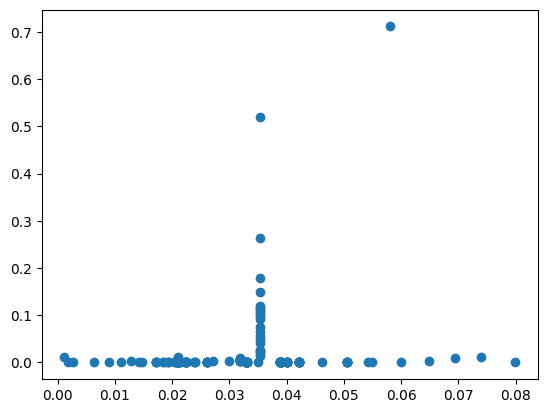

2022-08-21 05:34:39.322 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:39.324 | INFO     | __main__:apply_mean:92 - [0.022181876192389496, 0.022181876192389496, 0.033106488364827096, 0.033106488364827096, 0.033106488364827096, 0.033106488364827096, 0.033106488364827096, 0.033106488364827096, 0.033106488364827096, 0.0350219190653464, 0.009048729364706564, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02103548380751336, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.02123296089907365, 0.038796984112191985, 0.017266273181591588, 0.020331571992523896, 0.03291463922203698, 0.03291463922203698, 0.03291463922203698, 0.03291463922203698, 0.03291463922203698, 0.0329146

2022-08-21 05:34:39.338 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:39.340 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:39.343 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:39.363 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:39.366 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:39.374 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464], [0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786

2022-08-21 05:34:39.391 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.394 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.398 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.0350219190653464, 0.009048729364706564], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03879

2022-08-21 05:34:39.414 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:39.417 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.421 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408], [0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.03879

2022-08-21 05:34:39.433 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.438 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.441 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.038796984

2022-08-21 05:34:39.461 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.463 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:39.466 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051], [0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04750425109051

2022-08-21 05:34:39.475 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.477 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:39.480 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880

2022-08-21 05:34:39.496 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:39.506 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:39.511 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:39.525 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:39.528 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.541 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0172662731

2022-08-21 05:34:39.555 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.558 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.568 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:39.592 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.594 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:39.597 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756

2022-08-21 05:34:39.608 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:39.610 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:39.613 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:39.624 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.626 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.628 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:39.651 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:39.653 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.655 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273

2022-08-21 05:34:39.667 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.669 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.672 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:39.682 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.683 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:39.697 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128

2022-08-21 05:34:39.708 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.710 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:39.713 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504251090

2022-08-21 05:34:39.722 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:39.725 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:39.728 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:39.741 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:39.756 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:39.759 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504251090512

2022-08-21 05:34:39.769 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:39.772 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:39.775 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786801488

2022-08-21 05:34:39.786 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.789 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.791 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273181

2022-08-21 05:34:39.802 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:39.805 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.808 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273

2022-08-21 05:34:39.818 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.829 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.831 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:39.844 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:39.846 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.848 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273

2022-08-21 05:34:39.859 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.869 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:39.884 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:39.886 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:39.889 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756

2022-08-21 05:34:39.900 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:39.901 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:39.904 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504251090

2022-08-21 05:34:39.913 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:39.918 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:39.921 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786801488075

2022-08-21 05:34:39.942 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:39.943 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.945 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.0172662731

2022-08-21 05:34:39.956 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:39.958 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:39.964 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:39.979 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:39.981 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:39.984 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:39.996 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:39.998 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.000 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273

2022-08-21 05:34:40.011 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:40.013 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:40.025 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:40.027 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.029 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273

2022-08-21 05:34:40.040 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:40.042 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.043 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:40.064 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:40.065 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.075 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273

2022-08-21 05:34:40.086 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:40.088 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.092 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:40.105 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:40.107 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:40.111 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128

2022-08-21 05:34:40.129 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:40.131 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:40.134 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504251090

2022-08-21 05:34:40.144 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.146 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:40.149 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504251090512

2022-08-21 05:34:40.164 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.166 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.170 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148

2022-08-21 05:34:40.180 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.182 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:40.185 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.195 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.198 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:40.214 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.225 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.227 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:40.232 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.244 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.246 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:40.249 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04750425109051

2022-08-21 05:34:40.257 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.258 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:40.261 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510

2022-08-21 05:34:40.281 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.283 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:40.286 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.04750425109051

2022-08-21 05:34:40.298 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.300 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.306 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786801488

2022-08-21 05:34:40.330 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:40.340 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.342 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273181

2022-08-21 05:34:40.355 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:40.357 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:40.361 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756

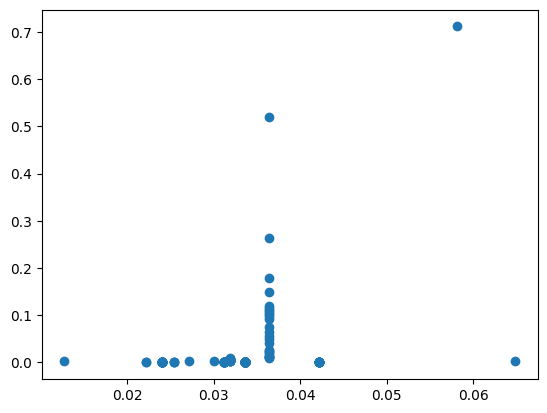

2022-08-21 05:34:40.556 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:40.558 | INFO     | __main__:apply_mean:92 - [0.022181876192389496, 0.022181876192389496, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.025464943095435826, 0.025464943095435826, 0.025464943095435826, 0.031140281542237844, 0.031140281542237844, 0.031140281542237844, 0.031140281542237844, 0.0

2022-08-21 05:34:40.567 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:40.568 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.575 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.584 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:40.586 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.588 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.597 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:40.599 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.602 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.618 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:40.620 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.623 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.634 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:40.648 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.653 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.668 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:40.671 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.047978680148807

2022-08-21 05:34:40.687 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:40.689 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.693 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.01726627318

2022-08-21 05:34:40.706 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:40.709 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:40.714 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128

2022-08-21 05:34:40.727 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:40.730 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:40.736 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504251090

2022-08-21 05:34:40.751 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.753 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:40.757 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.047504251090512

2022-08-21 05:34:40.771 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:40.774 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.779 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.0479786801488

2022-08-21 05:34:40.828 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:40.831 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:40.835 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128], [0.017266273181

2022-08-21 05:34:40.858 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:40.863 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:40.869 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880756, 0.0475042510905128

2022-08-21 05:34:40.888 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:40.891 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:40.896 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.017732943107674683, 0.026630809277104314], [0.0350219190653464, 0.009048729364706564, 0.019641210206182202, 0.0009607772139835422, 0.07867684367247656, 0.0050965871624249, 0.06121691013206228, 0.017490353542006055, 0.04866273662465408, 0.016426403120751942, 0.0014573327733885407, 0.028959083067422293, 0.042895119027415274, 0.03174050301847683, 0.016764370388644936, 0.001500147036087466, 0.03214007443055482, 0.015977573309682164, 0.032603241759017694, 0.010926473951205051, 0.003584154675397303, 0.006449416814242578, 0.028726872674574154, 0.025460566527678537, 0.01844879265632516, 0.00829728723148083, 0.02077466614938007, 0.005104921022337557, 0.04797868014880

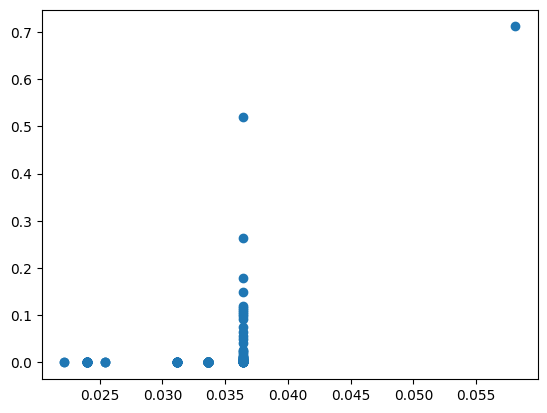

2022-08-21 05:34:41.199 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:41.201 | INFO     | __main__:apply_mean:92 - [0.022181876192389496, 0.022181876192389496, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.023984533261907533, 0.025464943095435826, 0.025464943095435826, 0.025464943095435826, 0.031140281542237844, 0.031140281542237844, 0.031140281542237844, 0.031140281542237844, 0.0

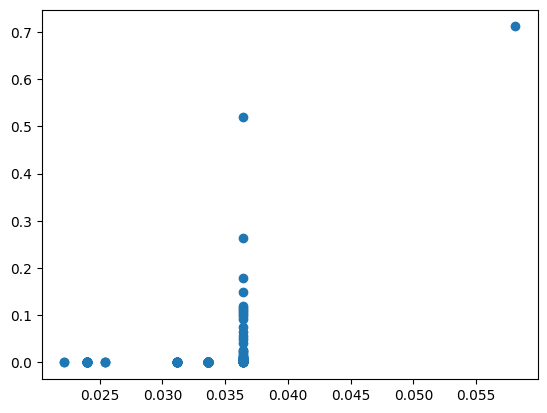

2022-08-21 05:34:41.493 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.0018026570695180363, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0014804098335282935, 0.0, 0.0, 0.0056753384468020175, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.00248140218368597, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0028025992588647936, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,

2022-08-21 05:34:41.614 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:41.617 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:41.622 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.009296569394569226], [0.052924150180037086], [0.028188343068871167], [0.04724792276591257], [0.00867284477861918], [0.02356579117512734], [0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.04844

2022-08-21 05:34:41.641 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:41.643 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:41.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.052924150180037086, 0.028188343068871167], [0.04724792276591257], [0.00867284477861918], [0.02356579117512734], [0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.02139664

2022-08-21 05:34:41.670 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:41.673 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:41.685 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.009296569394569226], [0.052924150180037086, 0.028188343068871167], [0.04724792276591257], [0.00867284477861918], [0.02356579117512734], [0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487

Sstar: 0.9467151844818948
Tstar: 1.0
stress: 0.9729929005300577
Sstar: Autograd ArrayBox with value 1.1169189420425187
Tstar: 1.0


2022-08-21 05:34:41.697 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.052924150180037086, 0.028188343068871167], [0.04724792276591257, 0.00867284477861918], [0.02356579117512734], [0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436], [0.021646656038735362], [0.023349376392256888], [0.011226869310149035], [0.06076604014205059], [0.09102997030082932], [0

2022-08-21 05:34:41.724 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:41.727 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:41.732 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167], [0.02356579117512734], [0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.01732

2022-08-21 05:34:41.753 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:41.756 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:41.760 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734], [0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195

2022-08-21 05:34:41.787 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:41.790 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:41.793 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734], [0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.04844877864682

2022-08-21 05:34:41.817 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:41.821 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:41.826 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835], [0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.02139664142105240

2022-08-21 05:34:41.841 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:41.843 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:41.845 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.01732119584874

2022-08-21 05:34:41.861 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:41.863 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:41.866 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802], [0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291],

2022-08-21 05:34:41.876 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:41.880 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:41.884 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], 

2022-08-21 05:34:41.896 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:41.902 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:41.905 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.10623718298107716], [0.07713351116325984], [0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], 

2022-08-21 05:34:41.924 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:41.927 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:41.934 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.10623718298107716], [0.07713351116325984, 0.040376851340074224], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291]

2022-08-21 05:34:41.956 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:41.959 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:41.964 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.07713351116325984, 0.040376851340074224, 0.10623718298107716], [0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.0

2022-08-21 05:34:41.989 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:41.992 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:41.999 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288], [0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.04

2022-08-21 05:34:42.018 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.022 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.

2022-08-21 05:34:42.057 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.061 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.069 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392], [0.07179925816135856], [0.01125079200176951], [0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.04844877

2022-08-21 05:34:42.095 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.098 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.114 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392], [0.07179925816135856], [0.01125079200176951, 0.006435688026639837], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:42.136 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.139 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.142 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856], [0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:42.161 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.165 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.169 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:42.189 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.193 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.196 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392], [0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:42.214 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.217 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.241 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.060526085

2022-08-21 05:34:42.258 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.261 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.270 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002], [0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291],

2022-08-21 05:34:42.300 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.304 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.324 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002, 0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580

2022-08-21 05:34:42.338 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.340 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.344 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002, 0.01297077721817022], [0.060696991981555384], [0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [

2022-08-21 05:34:42.363 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.366 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.368 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002, 0.01297077721817022], [0.060696991981555384, 0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605260858095

2022-08-21 05:34:42.377 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.380 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.392 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002, 0.01297077721817022], [0.060696991981555384, 0.015974112866569364], [0.04151263795986179], [0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.

2022-08-21 05:34:42.410 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.413 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.415 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002, 0.01297077721817022], [0.060696991981555384, 0.015974112866569364], [0.04151263795986179, 0.002513311192582361], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.060526085809504

2022-08-21 05:34:42.425 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.428 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.430 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002, 0.01297077721817022], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364], [0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.060526085809504

2022-08-21 05:34:42.442 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.444 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.446 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.05359812652723002, 0.01297077721817022], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436],

2022-08-21 05:34:42.460 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.462 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.464 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022], [0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436],

2022-08-21 05:34:42.477 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.487 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.497 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436], [0.

2022-08-21 05:34:42.513 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.515 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.519 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:42.533 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.534 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.537 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:42.554 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.556 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:42.559 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.060526

2022-08-21 05:34:42.570 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.573 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:42.578 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:42.597 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.601 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.603 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:42.613 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.615 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.619 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:42.639 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:42.641 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:42.644 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:42.658 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.665 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.669 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:42.686 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.689 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.693 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:42.713 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.715 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.719 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:42.732 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.736 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:42.741 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:42.751 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:42.754 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:42.759 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:42.774 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.776 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.777 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:42.790 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.792 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.794 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:42.813 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:42.815 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:42.819 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:42.829 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:42.831 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.835 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195

2022-08-21 05:34:42.848 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:42.850 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.854 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:42.876 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.878 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.880 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:42.900 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:42.903 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:42.906 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:42.914 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:42.917 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:42.921 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195

2022-08-21 05:34:42.937 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.939 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.941 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:42.959 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:42.961 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:42.965 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:42.975 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:42.977 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.978 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:42.988 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:42.990 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:42.993 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:43.004 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.007 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.009 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:43.019 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.021 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.024 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:43.035 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.039 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.045 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:43.058 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.060 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.062 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:43.071 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.072 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.076 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:43.087 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.089 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.101 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:43.123 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.125 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:43.129 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.138 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:43.140 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.142 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:43.168 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.172 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.174 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:43.187 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:43.190 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.192 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:43.201 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.203 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.207 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.233 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.236 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.239 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.251 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.254 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.257 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.272 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.274 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.278 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.291 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.293 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.297 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.316 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.319 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.322 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:43.333 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.337 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.341 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:43.362 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.364 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:43.369 | INFO     | __main__:eval_direction_expand:42 - merging down at index 19 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:43.390 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.391 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:43.396 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.409 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:43.411 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.413 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:43.425 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.426 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.437 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.449 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.451 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:43.454 | INFO     | __main__:eval_direction_expand:42 - merging down at index 20 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:43.465 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.468 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:43.471 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195

2022-08-21 05:34:43.480 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:43.482 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.490 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:43.498 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.500 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:43.503 | INFO     | __main__:eval_direction_expand:42 - merging down at index 18 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:43.511 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.514 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:43.521 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195

2022-08-21 05:34:43.539 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:43.542 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.546 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:43.555 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.558 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.564 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.578 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.580 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.583 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:43.595 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:43.598 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.600 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:43.624 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.626 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.631 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.648 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.650 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.653 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:43.664 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:43.666 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.669 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:43.680 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.682 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:43.686 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:43.696 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:43.698 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:43.713 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195

2022-08-21 05:34:43.723 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.724 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:43.727 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.739 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.741 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.746 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:43.762 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.763 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.767 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:43.782 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.784 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.787 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:43.797 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.800 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.803 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:43.821 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.822 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.825 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:43.840 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.842 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.844 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:43.853 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.855 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.858 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:43.867 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.869 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:43.881 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.883 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.886 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:43.894 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.896 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:43.899 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:43.909 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:43.910 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:43.912 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:43.937 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.942 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:43.946 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:43.956 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:43.959 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:43.962 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:43.971 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.975 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:43.979 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:43.991 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:43.998 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:44.002 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:44.015 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:44.018 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.020 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:44.029 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:44.032 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:44.038 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:44.048 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:44.050 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.054 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:44.065 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.067 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.071 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:44.085 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.087 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.092 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.102 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.104 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:44.111 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.

2022-08-21 05:34:44.121 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.123 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.126 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.137 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.139 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.150 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:44.160 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.162 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.164 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.198 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.200 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:44.204 | INFO     | __main__:eval_direction_expand:42 - merging down at index 28 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.

2022-08-21 05:34:44.215 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.217 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.221 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.255 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.258 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:44.265 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.

2022-08-21 05:34:44.278 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.281 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.285 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.294 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.296 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:44.303 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.

2022-08-21 05:34:44.319 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.320 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.325 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.336 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.338 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:44.341 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.

2022-08-21 05:34:44.350 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.352 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:44.356 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:44.369 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.371 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.375 | INFO     | __main__:eval_direction_expand:42 - merging up at index 29 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.390 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.391 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.394 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:44.403 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.404 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.406 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:44.414 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.416 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:44.419 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:44.427 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:44.429 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.431 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:44.440 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.442 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.444 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:44.468 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:44.480 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.495 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:44.508 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:44.509 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.513 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:44.528 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.529 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.531 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:44.546 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:44.548 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.552 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:44.561 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.564 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.567 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:44.577 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.579 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.582 | INFO     | __main__:eval_direction_expand:42 - merging up at index 31 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:44.600 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.604 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.607 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:44.619 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.626 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.628 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:44.639 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:44.641 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.644 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:44.652 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:44.655 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.659 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:44.672 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:44.686 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.689 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:44.704 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.706 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.708 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:44.721 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:44.728 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.731 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:44.743 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.745 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.747 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:44.756 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.758 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:44.763 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:44.775 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.776 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.778 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:44.787 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.789 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.792 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:44.808 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.811 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.814 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:44.829 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.831 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.833 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:44.843 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.845 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.849 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:44.866 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.870 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.877 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:44.892 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.895 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.898 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:44.913 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:44.915 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:44.918 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:44.931 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.933 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.935 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:44.946 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:44.948 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.958 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:44.970 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:44.972 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:44.974 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:44.989 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:44.991 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:44.995 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.005 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.008 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:45.025 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.034 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.036 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:45.044 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.046 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.049 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.056 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.058 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.061 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:45.079 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.081 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.083 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.096 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.097 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.100 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.107 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.108 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.111 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:45.124 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.125 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.128 | INFO     | __main__:eval_direction_expand:42 - merging up at index 37 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:45.146 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.148 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:45.151 | INFO     | __main__:eval_direction_expand:42 - merging down at index 37 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.

2022-08-21 05:34:45.161 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.162 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.165 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:45.177 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.179 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.183 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:45.195 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.197 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.200 | INFO     | __main__:eval_direction_expand:42 - merging up at index 38 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:45.218 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.221 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.226 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:45.239 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.242 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.245 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:45.267 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.274 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:45.279 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:45.293 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.296 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.298 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.310 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:45.312 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.314 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:45.324 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.327 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.329 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.341 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:45.343 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.346 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:45.358 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.360 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.362 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.369 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:45.371 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.376 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:45.390 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.391 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.394 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.402 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.404 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.406 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.415 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.417 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.420 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:45.429 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.431 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.433 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.452 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:45.454 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.457 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0

2022-08-21 05:34:45.470 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.472 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.482 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0

2022-08-21 05:34:45.491 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.494 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.497 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.504 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.506 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:45.509 | INFO     | __main__:eval_direction_expand:42 - merging down at index 35 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:45.518 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.524 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.527 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:45.536 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.538 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.541 | INFO     | __main__:stabilize_block:65 - at end of iteration 17, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732

2022-08-21 05:34:45.550 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.553 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.554 | INFO     | __main__:stabilize_block:65 - at end of iteration 18, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.575 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.577 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.580 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.588 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.590 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.592 | INFO     | __main__:stabilize_block:65 - at end of iteration 21, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:45.601 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.602 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.604 | INFO     | __main__:stabilize_block:65 - at end of iteration 22, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.612 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.613 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.621 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.629 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.636 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.639 | INFO     | __main__:stabilize_block:65 - at end of iteration 25, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:45.647 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.649 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.651 | INFO     | __main__:stabilize_block:65 - at end of iteration 26, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.659 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.661 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:45.664 | INFO     | __main__:stabilize_block:65 - at end of iteration 28, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195

2022-08-21 05:34:45.685 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.687 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.689 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.700 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.702 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:45.711 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:45.728 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.729 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.732 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.744 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.745 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:45.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:45.760 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.761 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.763 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.773 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:45.775 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.777 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.

2022-08-21 05:34:45.786 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.788 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.790 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02

2022-08-21 05:34:45.814 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.815 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.817 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.827 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.828 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.834 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:45.848 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.850 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:45.874 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.877 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:45.880 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

2022-08-21 05:34:45.899 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:45.914 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:45.919 | INFO     | __main__:eval_direction_expand:42 - merging down at index 43 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0

2022-08-21 05:34:45.925 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:45.927 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.930 | INFO     | __main__:eval_direction_expand:42 - merging up at index 42 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.938 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:45.942 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:45.948 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:45.958 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:45.959 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:45.962 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:45.973 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:45.975 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:45.979 | INFO     | __main__:eval_direction_expand:42 - merging up at index 42 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:45.998 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.000 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.004 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211

2022-08-21 05:34:46.014 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:46.016 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.018 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.021

2022-08-21 05:34:46.027 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.028 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.031 | INFO     | __main__:eval_direction_expand:42 - merging up at index 42 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052

2022-08-21 05:34:46.045 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.046 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.049 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:46.059 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.061 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.064 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.0605

2022-08-21 05:34:46.072 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.074 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.077 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321

2022-08-21 05:34:46.099 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.100 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:46.104 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958

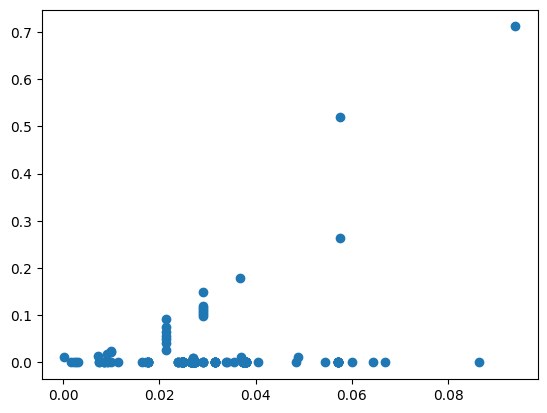

2022-08-21 05:34:46.378 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:46.380 | INFO     | __main__:apply_mean:92 - [0.009296569394569226, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.038063878752117204, 0.06440556804830173, 0.007519297685229503, 0.02752931658808035, 0.02752931658808035, 0.02752931658808035, 0.02752931658808035, 0.02752931658808035, 0.02752931658808035, 0.02752931658808035, 0.02752931658808035, 0.0484487786468291, 0.017321195848744586, 0.02918724688766141, 0.02918724688766141, 0.02918724688766141, 0.02918724688766141, 0.05717843804462389, 0.05717843804462389, 0.05717843804462389, 0.05717843804462389, 0.05717843804462389, 0

2022-08-21 05:34:46.393 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:46.395 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.398 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:46.418 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:46.423 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.426 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:46.438 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:46.440 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.443 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173], [0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.01732119

2022-08-21 05:34:46.457 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:46.458 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.460 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.06440556804830173, 0.007519297685229503], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0216

2022-08-21 05:34:46.468 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:46.471 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.473 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024], [0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.0216

2022-08-21 05:34:46.491 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:46.493 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.495 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608580950436, 0.02164665

2022-08-21 05:34:46.504 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.506 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:46.508 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.0173211958487445

2022-08-21 05:34:46.517 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:46.523 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:46.525 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.0484487786468291], [0.017321195848744586], [0.06052608

2022-08-21 05:34:46.537 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:46.540 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.543 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.017321195848744586, 0.0484487786468291], [0.06052608580950

2022-08-21 05:34:46.551 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.553 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:46.556 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652723002, 0.01297077721817022, 0.021396641421052406], [0.017321195848744586, 0.0484487786468291, 0.06052608580

2022-08-21 05:34:46.570 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.573 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:46.576 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:46.596 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.605 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:46.609 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:46.620 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:46.623 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.624 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652

2022-08-21 05:34:46.640 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:46.642 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:46.645 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.0115719335376

2022-08-21 05:34:46.654 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:46.655 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.658 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.01157193353762124

2022-08-21 05:34:46.665 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.667 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.677 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569

2022-08-21 05:34:46.687 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:46.689 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.693 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.0535981265272

2022-08-21 05:34:46.714 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.716 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.719 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.01157193353762124

2022-08-21 05:34:46.731 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.733 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.737 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.0159741128665693

2022-08-21 05:34:46.748 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:46.751 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.753 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.053598126527

2022-08-21 05:34:46.764 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.766 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.776 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.01157193353762124

2022-08-21 05:34:46.801 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.809 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.812 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569

2022-08-21 05:34:46.826 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.828 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:46.832 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:46.844 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.846 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:46.849 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:46.864 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.865 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.868 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.0115719335376212

2022-08-21 05:34:46.879 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.880 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.883 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569

2022-08-21 05:34:46.898 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:46.900 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:46.902 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.0535981265272

2022-08-21 05:34:46.911 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.912 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.914 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.01157193353762124

2022-08-21 05:34:46.932 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:46.934 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.937 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.0159741128665693

2022-08-21 05:34:46.946 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.948 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.951 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.0115719335376212

2022-08-21 05:34:46.959 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.961 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:46.964 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569

2022-08-21 05:34:46.987 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:46.990 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:46.993 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621

2022-08-21 05:34:47.002 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:47.005 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:47.008 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.01157193353

2022-08-21 05:34:47.028 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:47.029 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:47.032 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.0115719335376212

2022-08-21 05:34:47.044 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:47.046 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:47.049 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537

2022-08-21 05:34:47.059 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:47.067 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:47.069 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:47.085 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:47.087 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:47.091 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:47.103 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:47.111 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.114 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.05359812652

2022-08-21 05:34:47.124 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.130 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.132 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.053598126527

2022-08-21 05:34:47.147 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:47.150 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.152 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.0535981265

2022-08-21 05:34:47.162 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:47.165 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.168 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:47.192 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.193 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.196 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.053598126527

2022-08-21 05:34:47.206 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:47.208 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.214 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.0535981265

2022-08-21 05:34:47.225 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.227 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.228 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.053598126527

2022-08-21 05:34:47.237 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:47.239 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.241 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.0535981265

2022-08-21 05:34:47.258 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.260 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.262 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.053598126527

2022-08-21 05:34:47.272 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:47.273 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.282 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.0535981265

2022-08-21 05:34:47.293 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.295 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.298 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.053598126527

2022-08-21 05:34:47.305 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:47.307 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:47.309 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.01157193353762124

2022-08-21 05:34:47.323 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:47.325 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.328 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.0159741128665693

2022-08-21 05:34:47.337 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:47.339 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:47.342 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364,

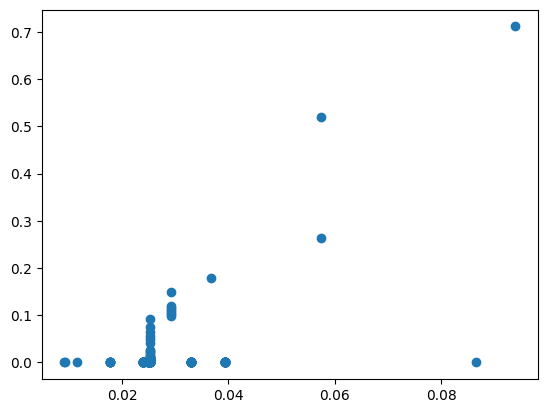

2022-08-21 05:34:47.578 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:47.581 | INFO     | __main__:apply_mean:92 - [0.009296569394569226, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03289681338482943, 0.03941753254374444, 0.03941753254374444, 0.03941753254374444, 0.03941753254374444, 0.03941753254374444, 0.0394175325

2022-08-21 05:34:47.593 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:47.596 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.602 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:47.614 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:47.616 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.618 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:47.633 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:47.635 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.638 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:47.649 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:47.650 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.652 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.01597411286656936

2022-08-21 05:34:47.665 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.667 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.669 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.053598126527

2022-08-21 05:34:47.679 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:47.680 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:47.684 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.01157193353762124

2022-08-21 05:34:47.697 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:47.698 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:47.701 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.0115719335376

2022-08-21 05:34:47.708 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:47.710 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:47.712 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.0115719335376212

2022-08-21 05:34:47.728 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:47.733 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.736 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569

2022-08-21 05:34:47.745 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.746 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.017321195848744586, 0.0484487786468291, 0.06052608580950436, 0.021646656038735362, 0.023349376392256888, 0.011226869310149035, 0.06440556804830173, 0.007519297685229503, 0.01125079200176951, 0.006435688026639837, 0.07179925816135856, 0.006736928882510399, 0.07713351116325984, 0.040376851340074224, 0.10623718298107716, 0.027119235884278288, 0.0190823606836392, 0.014466978396565024, 0.04151263795986179, 0.002513311192582361, 0.060696991981555384, 0.015974112866569364, 0.011571933537621246, 0.0535981265272

2022-08-21 05:34:47.756 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:47.757 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.764 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.08653093166235992, 0.009136104257522213, 0.011440697623208682, 0.002634257080681253, 0.06007933029506239, 0.014289750641585983, 0.06817256912744388, 0.06911396367683602, 0.10651047847523973, 0.046563248272481636, 0.04725960526715753, 0.032076329511805425, 0.09102997030082932, 0.03600242503080901, 0.06076604014205059, 0.0013340287774744786, 0.04464613323647535, 0.004500956978653743, 0.0837693676113985, 0.0350532197327175, 0.07296897297422639, 0.025881224904225945, 0.008927477651015293, 0.0385083677329

2022-08-21 05:34:47.772 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:47.777 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:47.778 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.08653093166235992, 0.009136104257522213, 0.011440697623208682, 0.002634257080681253, 0.06007933029506239, 0.014289750641585983, 0.06817256912744388, 0.06911396367683602, 0.10651047847523973, 0.046563248272481636, 0.04725960526715753, 0.032076329511805425, 0.09102997030082932, 0.03600242503080901, 0.06076604014205059, 0.0013340287774744786, 0.04464613323647535, 0.004500956978653743, 0.0837693676113985, 0.0350532197327175, 0.07296897297422639, 0.025881224904225945, 0.008927477651015293, 0.038508367732969

2022-08-21 05:34:47.786 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:47.787 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:47.790 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.08653093166235992, 0.009136104257522213, 0.011440697623208682, 0.002634257080681253, 0.06007933029506239, 0.014289750641585983, 0.06817256912744388, 0.06911396367683602, 0.10651047847523973, 0.046563248272481636, 0.04725960526715753, 0.032076329511805425, 0.09102997030082932, 0.03600242503080901, 0.06076604014205059, 0.0013340287774744786, 0.04464613323647535, 0.004500956978653743, 0.0837693676113985, 0.0350532197327175, 0.07296897297422639, 0.025881224904225945, 0

2022-08-21 05:34:47.800 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:47.802 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:47.809 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.009296569394569226], [0.04724792276591257, 0.00867284477861918, 0.052924150180037086, 0.028188343068871167, 0.02356579117512734, 0.011042477054632835, 0.023404141117112802, 0.004331131373460997], [0.08653093166235992, 0.009136104257522213, 0.011440697623208682, 0.002634257080681253, 0.06007933029506239, 0.014289750641585983, 0.06817256912744388, 0.06911396367683602, 0.10651047847523973, 0.046563248272481636, 0.04725960526715753, 0.032076329511805425, 0.09102997030082932, 0.03600242503080901, 0.06076604014205059, 0.0013340287774744786, 0.04464613323647535, 0.004500956978653743, 0.0837693676113985, 0.0350532197327175, 0.07296897297422639, 0.025881224904225945, 

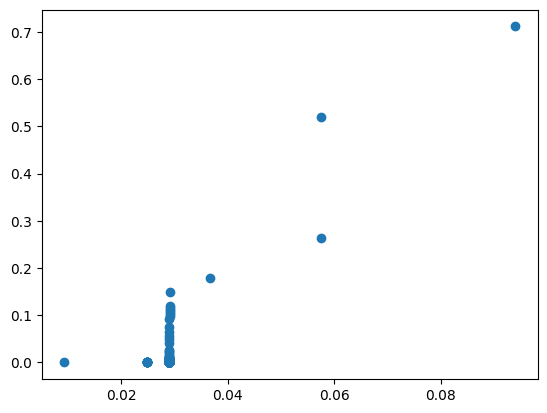

2022-08-21 05:34:48.063 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:48.064 | INFO     | __main__:apply_mean:92 - [0.009296569394569226, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.024922100189221745, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.028918809845511134, 0.0

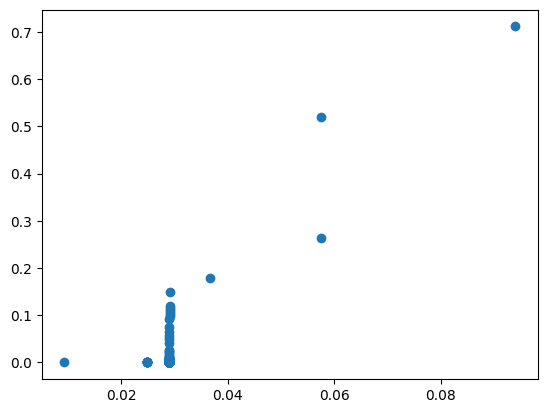

2022-08-21 05:34:48.265 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.01562553079465252, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0039967096562893885, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

2022-08-21 05:34:48.371 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:48.374 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:48.381 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.00890075090074757], [0.0008365086181469066], [0.03686708427417197], [0.03409837736550865], [0.001323989650808557], [0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631

2022-08-21 05:34:48.407 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:48.410 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.414 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03686708427417197], [0.03409837736550865], [0.001323989650808557], [0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0

2022-08-21 05:34:48.431 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.434 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:48.447 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03686708427417197], [0.03409837736550865], [0.001323989650808557], [0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.0663114

2022-08-21 05:34:48.468 | INFO     | __main__:merge_blocks:24 - merged up


Sstar: 0.8488980186644822
Tstar: 1.0
stress: 0.9213566186143572
Sstar: Autograd ArrayBox with value 0.9797276960930703
Tstar: 1.0


2022-08-21 05:34:48.474 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.479 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03686708427417197], [0.03409837736550865, 0.001323989650808557], [0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [0.008726358888153617], [0.011406095332500397], [0.06570

2022-08-21 05:34:48.498 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:48.502 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.506 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03409837736550865, 0.001323989650808557, 0.03686708427417197], [0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03

2022-08-21 05:34:48.526 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:48.528 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.539 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.034085

2022-08-21 05:34:48.557 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:48.562 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:48.569 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.066311440635232

2022-08-21 05:34:48.589 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.592 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:48.599 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.02835344862134292], [0.010024866949974537], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367

2022-08-21 05:34:48.612 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.615 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:48.623 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.010024866949974537, 0.02835344862134292], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.0663114406352323

2022-08-21 05:34:48.638 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:48.641 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.648 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.034085854

2022-08-21 05:34:48.657 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.671 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:48.674 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235

2022-08-21 05:34:48.690 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.693 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:48.700 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235

2022-08-21 05:34:48.731 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.734 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:48.740 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235

2022-08-21 05:34:48.759 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.762 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:48.769 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989], [0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235

2022-08-21 05:34:48.788 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:48.791 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.795 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.05039322738214428], [0.07861878883604989, 0.02074296484070537], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.034085854802

2022-08-21 05:34:48.814 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:48.816 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.819 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428], [0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.034085854802

2022-08-21 05:34:48.831 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:48.833 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.836 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.0340858548024789

2022-08-21 05:34:48.852 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:48.855 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:48.860 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114], [0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0

2022-08-21 05:34:48.874 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:48.876 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:48.882 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531], [0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.0

2022-08-21 05:34:48.893 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:48.895 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.898 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [

2022-08-21 05:34:48.933 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:48.935 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:48.940 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.037673

2022-08-21 05:34:48.953 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.955 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:48.959 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.056332281267895794], [0.003700751958584991], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0

2022-08-21 05:34:48.968 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:48.970 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:48.979 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.003700751958584991, 0.056332281267895794], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.0376736

2022-08-21 05:34:48.989 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:48.992 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:48.994 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [0.

2022-08-21 05:34:49.004 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.006 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:49.011 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324], [0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367

2022-08-21 05:34:49.030 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.032 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.035 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.034223588347596014], [0.02395048698366712], [0.037032219265392324, 0.004204793938408314], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [0.008

2022-08-21 05:34:49.047 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.048 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.050 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.034223588347596014], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712], [0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [0.008

2022-08-21 05:34:49.060 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.062 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.064 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.034223588347596014], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [0.0087263

2022-08-21 05:34:49.073 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.075 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.077 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [0.0087263

2022-08-21 05:34:49.087 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.089 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.092 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480

2022-08-21 05:34:49.109 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.110 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.114 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216], [0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897

2022-08-21 05:34:49.127 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.129 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:49.131 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398], [0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395]

2022-08-21 05:34:49.141 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.143 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.150 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897], [0.0087263588881536

2022-08-21 05:34:49.159 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:49.161 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.165 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.

2022-08-21 05:34:49.177 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.187 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.190 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03767367217353395], [0.03408585480247897, 0.00872635888815361

2022-08-21 05:34:49.199 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.201 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.203 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03408585480247897, 0.008726358888153617, 0.0376736721735339

2022-08-21 05:34:49.212 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.214 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.227 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03296076946408291], [0.06631144063523235], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395,

2022-08-21 05:34:49.236 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.238 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.240 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03296076946408291], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397

2022-08-21 05:34:49.248 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.249 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.252 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03296076946408291], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:49.261 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.264 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140

2022-08-21 05:34:49.278 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.281 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.285 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0114

2022-08-21 05:34:49.299 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.301 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.303 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0

2022-08-21 05:34:49.321 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.323 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.325 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.

2022-08-21 05:34:49.334 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.336 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.338 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:49.347 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.349 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.350 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.

2022-08-21 05:34:49.361 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.363 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.365 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:49.375 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.400 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.404 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.

2022-08-21 05:34:49.429 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.433 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.436 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874

2022-08-21 05:34:49.452 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.454 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.458 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.07861878883604989, 0.02074296484070537, 0.05039322738214428, 0.024797915046291114, 0.014706584566106531, 0.021809960269957216, 0.0287111439193398, 0.0018766977975467826], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.

2022-08-21 05:34:49.468 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.476 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.481 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700

2022-08-21 05:34:49.492 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.496 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.499 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700

2022-08-21 05:34:49.518 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.533 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.535 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.

2022-08-21 05:34:49.544 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.546 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.548 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.0

2022-08-21 05:34:49.557 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.559 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.563 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.0037007

2022-08-21 05:34:49.582 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:49.587 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.590 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332281267895794, 0.

2022-08-21 05:34:49.609 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.611 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.614 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.05

2022-08-21 05:34:49.625 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:49.626 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.630 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.056332

2022-08-21 05:34:49.641 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.643 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.646 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.0

2022-08-21 05:34:49.656 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.658 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.662 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.05633

2022-08-21 05:34:49.681 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.683 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.685 | INFO     | __main__:eval_direction_expand:42 - merging down at index 7 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0.03296076946408291, 0.037032219265392324, 0.004204793938408314, 0.02395048698366712, 0.007199780301843082, 0.034223588347596014, 0.003700751958584991, 0.0

2022-08-21 05:34:49.697 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.699 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.705 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:49.714 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.716 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:49.720 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 

2022-08-21 05:34:49.736 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.738 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.741 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:49.755 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:49.758 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.762 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01

2022-08-21 05:34:49.772 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.775 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.777 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:49.785 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:49.787 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.790 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:49.803 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:49.809 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:49.824 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:49.838 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.844 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.846 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:49.858 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:49.860 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.863 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:49.870 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:49.876 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:49.880 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:49.889 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.891 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:49.896 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:49.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.910 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.914 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:49.925 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.927 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:49.931 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:49.951 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.952 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:49.955 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:49.968 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:49.970 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:49.975 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:49.985 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:49.987 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:49.990 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:50.001 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.003 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.008 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.030 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.031 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.034 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:50.044 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.046 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.048 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:50.057 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.059 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.062 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.081 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.085 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.088 | INFO     | __main__:eval_direction_expand:42 - merging down at index 14 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397

2022-08-21 05:34:50.099 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.100 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:50.103 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:50.111 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.113 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.115 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.125 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.127 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.131 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:50.154 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.156 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:50.159 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:50.168 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.174 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.177 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.185 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.188 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.194 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:50.204 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.206 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:50.210 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:50.221 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.225 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.228 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.238 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.240 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.243 | INFO     | __main__:eval_direction_expand:42 - merging down at index 18 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:50.250 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.252 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.254 | INFO     | __main__:eval_direction_expand:42 - merging up at index 17 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.263 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.265 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.288 | INFO     | __main__:eval_direction_expand:42 - merging down at index 17 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:50.297 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.300 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.304 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.314 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.316 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.319 | INFO     | __main__:eval_direction_expand:42 - merging down at index 16 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:50.328 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.330 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.334 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.348 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.367 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.370 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:50.383 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.386 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.393 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.405 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.408 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.412 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:50.425 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.427 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.429 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:50.440 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.450 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.452 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.461 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.463 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.466 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:50.481 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.483 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.485 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:50.498 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.500 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:50.503 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01

2022-08-21 05:34:50.512 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:50.514 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:50.516 | INFO     | __main__:eval_direction_expand:42 - merging down at index 19 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397

2022-08-21 05:34:50.525 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:50.526 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.530 | INFO     | __main__:eval_direction_expand:42 - merging up at index 18 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.539 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.541 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.548 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:50.559 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.568 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:50.571 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:50.586 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:50.588 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.591 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235

2022-08-21 05:34:50.602 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.608 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:50.621 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:50.628 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.631 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.0663114406352323

2022-08-21 05:34:50.641 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:50.643 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.650 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:50.662 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.667 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.669 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:50.679 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.681 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.684 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.701 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.702 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.706 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:50.718 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.724 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.726 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.736 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.741 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.746 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:50.756 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.758 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.760 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:50.770 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.772 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.776 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.785 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.787 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.790 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:50.800 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.803 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.806 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:50.816 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:50.818 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.822 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:50.832 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.834 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.836 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:50.855 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.857 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.860 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.871 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.873 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.876 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:50.908 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.910 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.913 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:50.924 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.926 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:50.930 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:50.941 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:50.944 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:50.949 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:50.981 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:50.986 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:50.990 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:51.008 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.010 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.016 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.037 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.040 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.046 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.058 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.060 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.062 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:51.075 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.077 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:51.087 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01

2022-08-21 05:34:51.106 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.109 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.112 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:51.130 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.133 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.136 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.160 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.162 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:51.166 | INFO     | __main__:eval_direction_expand:42 - merging down at index 24 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397

2022-08-21 05:34:51.180 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.183 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.187 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:51.198 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.200 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.205 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.214 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.216 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.218 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:51.227 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.229 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.232 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.251 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.253 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.256 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:51.266 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.268 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.272 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:51.281 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.283 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:51.291 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:51.301 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.303 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.306 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:51.327 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.329 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.334 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.345 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.347 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.351 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:51.363 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.365 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.368 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.387 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.390 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.395 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:51.404 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.405 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:51.417 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.425 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.427 | INFO     | __main__:eval_direction_expand:42 - merging up at index 24 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.437 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.440 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.445 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.459 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.461 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.463 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:51.473 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:51.478 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.481 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.066311440635232

2022-08-21 05:34:51.491 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.492 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.495 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235

2022-08-21 05:34:51.508 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.509 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.512 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.519 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.521 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.524 | INFO     | __main__:stabilize_block:65 - at end of iteration 17, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.534 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.540 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.551 | INFO     | __main__:stabilize_block:65 - at end of iteration 18, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:51.562 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.563 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.566 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.578 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.580 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.583 | INFO     | __main__:stabilize_block:65 - at end of iteration 21, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.593 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.595 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:51.598 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:51.610 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.612 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.614 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:51.631 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.633 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:51.637 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:51.650 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.652 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.656 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:51.671 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.673 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.677 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.690 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.692 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.694 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:51.711 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.714 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.717 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.727 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.734 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.736 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:51.744 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.746 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.748 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:51.754 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.756 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.758 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.764 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.766 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.768 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.785 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.787 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.790 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:51.797 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.799 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.801 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:51.817 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.819 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.823 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.835 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.838 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.841 | INFO     | __main__:eval_direction_expand:42 - merging up at index 28 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:51.850 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.852 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:51.856 | INFO     | __main__:eval_direction_expand:42 - merging down at index 28 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:51.867 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.869 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:51.871 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:51.879 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:51.881 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:51.883 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:51.892 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.897 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.901 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:51.919 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:51.921 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:51.926 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:51.941 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.944 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.947 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:51.958 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:51.960 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.963 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.0663114406352323

2022-08-21 05:34:51.973 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:51.975 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:51.977 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.007 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:52.008 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.010 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.0663114406352323

2022-08-21 05:34:52.023 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.026 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.028 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.037 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.039 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.043 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:52.052 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.054 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.065 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.067 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.077 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:52.087 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:52.094 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:52.098 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:52.115 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.118 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.122 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.141 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:52.144 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.146 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.0663114406352323

2022-08-21 05:34:52.160 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.163 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.166 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.196 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:52.201 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.204 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.0663114406352323

2022-08-21 05:34:52.221 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.229 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.231 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.250 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.253 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.263 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:52.284 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.287 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.290 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.311 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.313 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.317 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:52.345 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.349 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.353 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.367 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.370 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:52.375 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:52.387 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.389 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:52.392 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:52.403 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.405 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:52.436 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.439 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.445 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:52.467 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.469 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.472 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.484 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.485 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:52.488 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:52.508 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.510 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:52.514 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:52.527 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.529 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:52.532 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:52.545 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.548 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:52.551 | INFO     | __main__:eval_direction_expand:42 - merging down at index 36 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:52.566 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.568 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:52.572 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:52.581 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.583 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:52.586 | INFO     | __main__:eval_direction_expand:42 - merging down at index 35 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.01140609533250039

2022-08-21 05:34:52.595 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.598 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:52.601 | INFO     | __main__:eval_direction_expand:42 - merging up at index 34 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:52.625 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.626 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:52.630 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:52.639 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.641 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:52.644 | INFO     | __main__:eval_direction_expand:42 - merging up at index 37 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0

2022-08-21 05:34:52.655 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:52.656 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:52.659 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0

2022-08-21 05:34:52.673 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.675 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.677 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:52.687 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.689 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:52.691 | INFO     | __main__:eval_direction_expand:42 - merging up at index 37 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.

2022-08-21 05:34:52.699 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.701 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:52.704 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.

2022-08-21 05:34:52.713 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.715 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.717 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 

2022-08-21 05:34:52.727 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.739 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.743 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:52.752 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:52.753 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:52.758 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:52.768 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.769 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.772 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.785 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.787 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.798 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

2022-08-21 05:34:52.806 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:52.808 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:52.815 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235,

2022-08-21 05:34:52.823 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:52.826 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:52.828 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011

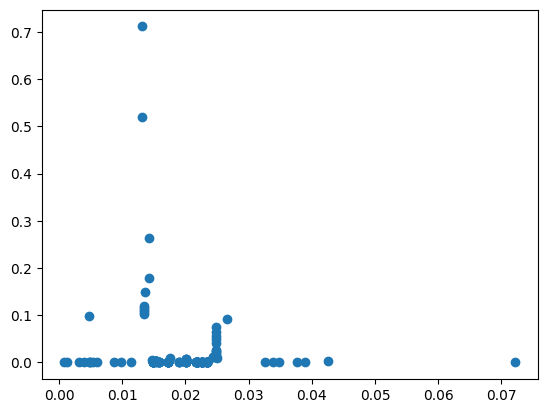

2022-08-21 05:34:53.132 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:53.135 | INFO     | __main__:apply_mean:92 - [0.004868629759447238, 0.004868629759447238, 0.020003329789932033, 0.020003329789932033, 0.020003329789932033, 0.020003329789932033, 0.020003329789932033, 0.020003329789932033, 0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.005920144337287655, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.023393639416347225, 0.02

2022-08-21 05:34:53.152 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.154 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.158 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:53.168 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.172 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.176 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682], [0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0

2022-08-21 05:34:53.191 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.193 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.195 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682, 0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144063523235, 0

2022-08-21 05:34:53.213 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:53.215 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:53.219 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682, 0.0039389823141476946], [0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.066

2022-08-21 05:34:53.235 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:53.238 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:53.241 | INFO     | __main__:eval_direction_expand:42 - merging down at index 2 of partition [[0.0008365086181469066, 0.00890075090074757], [0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.0

2022-08-21 05:34:53.257 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.262 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:53.266 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559], [0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.066311

2022-08-21 05:34:53.275 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.278 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.283 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0114060

2022-08-21 05:34:53.296 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.313 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:53.326 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.06631144

2022-08-21 05:34:53.338 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.341 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:53.344 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.011406095332500397, 0.0663

2022-08-21 05:34:53.357 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.359 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:53.362 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.0087263588

2022-08-21 05:34:53.378 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.381 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:53.385 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.037673672

2022-08-21 05:34:53.397 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.399 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:53.403 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767

2022-08-21 05:34:53.414 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.419 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:53.425 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.037673672

2022-08-21 05:34:53.434 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:53.436 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.439 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.00872635

2022-08-21 05:34:53.451 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.452 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.455 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973294268153711, 0.023750816660702712, 0.013052305580118488, 0.013148687730605853, 0.009912848072874863, 0.05229671541651953, 8.053713521013025e-05, 0.008004442720089997, 0.02949156461191283, 0.008812999117938192, 0.02688364586812311, 0.0029514478280480874, 0.06570438386317937, 0.009208572460580296, 0.03408585480247897, 0.008726358888153617, 0.03767367217353395, 0.0114060

2022-08-21 05:34:53.467 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:53.469 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.471 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.0019

2022-08-21 05:34:53.483 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.485 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.487 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.499 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:53.519 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:53.523 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:53.535 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.538 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.542 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.553 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.554 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.557 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.573 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.575 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.578 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.587 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:53.590 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:53.593 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:53.609 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.611 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.614 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.635 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.637 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.640 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.653 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.655 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.663 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.676 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.678 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.681 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.689 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:53.691 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.696 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.0019

2022-08-21 05:34:53.707 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.711 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.714 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.723 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:53.726 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.728 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.0019

2022-08-21 05:34:53.737 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.738 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.741 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.751 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:53.753 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:53.757 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:53.769 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.771 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.786 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.789 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.792 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.825 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:53.828 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:53.831 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:53.840 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.844 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.848 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.857 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:53.863 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:53.865 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:53.882 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.884 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.887 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.897 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:53.899 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.901 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.0019

2022-08-21 05:34:53.916 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.919 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.921 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.931 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:53.932 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.934 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.0019

2022-08-21 05:34:53.945 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.947 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.948 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:53.956 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:53.961 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.963 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.0019

2022-08-21 05:34:53.990 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:53.993 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:53.996 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:54.007 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.011 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:54.014 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.000386082569

2022-08-21 05:34:54.020 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.021 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:54.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211

2022-08-21 05:34:54.048 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.051 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.054 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.067 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.068 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.072 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.083 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.085 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.088 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.098 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.100 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.103 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.125 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.133 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.135 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.149 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.150 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.152 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.163 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.166 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.170 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.186 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.195 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.199 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.211 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.214 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.219 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.230 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.231 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.234 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.249 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.251 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.256 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

2022-08-21 05:34:54.269 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.271 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.273 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543

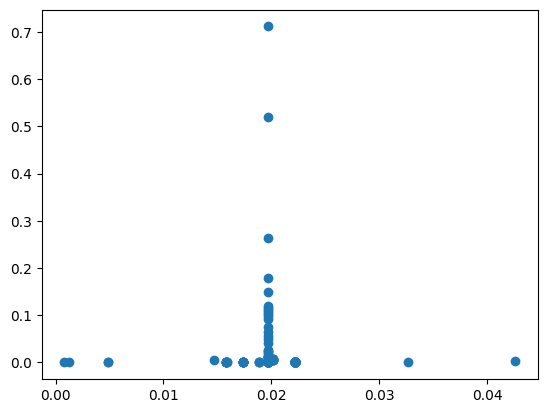

2022-08-21 05:34:54.522 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:54.524 | INFO     | __main__:apply_mean:92 - [0.004868629759447238, 0.004868629759447238, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.022231665248619196, 0.0

2022-08-21 05:34:54.542 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:54.546 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:54.549 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:54.563 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:54.565 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:54.568 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:54.579 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:54.582 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:54.586 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.0113522992115

2022-08-21 05:34:54.604 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:54.607 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:54.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299211543774, 0.00038608256909489365, 0.001973

2022-08-21 05:34:54.620 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:54.622 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:54.624 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352

2022-08-21 05:34:54.638 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:54.640 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:54.644 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.01135229

2022-08-21 05:34:54.655 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.657 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:54.661 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.03380312406

2022-08-21 05:34:54.670 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.673 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:54.677 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555

2022-08-21 05:34:54.687 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:54.690 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:54.693 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299

2022-08-21 05:34:54.703 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.732 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:54.738 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.03380312406

2022-08-21 05:34:54.750 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.752 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:54.755 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555

2022-08-21 05:34:54.766 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:54.768 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:54.770 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.01135229

2022-08-21 05:34:54.781 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.783 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.785 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504

2022-08-21 05:34:54.795 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:54.797 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:54.799 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031

2022-08-21 05:34:54.807 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:54.810 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:54.813 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.03380312406

2022-08-21 05:34:54.820 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:54.822 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:54.825 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555

2022-08-21 05:34:54.843 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:54.857 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:54.858 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.011352299

2022-08-21 05:34:54.866 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.867 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.870 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555040

2022-08-21 05:34:54.895 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.897 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.899 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555040

2022-08-21 05:34:54.909 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.911 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.914 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555040

2022-08-21 05:34:54.926 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.928 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.932 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555040

2022-08-21 05:34:54.944 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:54.963 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:54.966 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555040

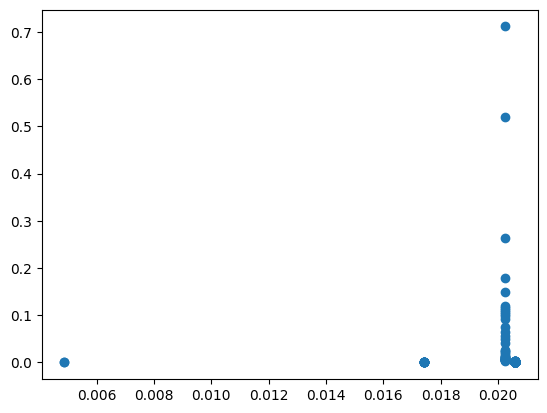

2022-08-21 05:34:55.239 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:55.241 | INFO     | __main__:apply_mean:92 - [0.004868629759447238, 0.004868629759447238, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.02060112451266692, 0.0206011

2022-08-21 05:34:55.251 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:55.252 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:55.254 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.01142955550

2022-08-21 05:34:55.262 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:55.264 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:55.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.01142955550

2022-08-21 05:34:55.278 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:55.287 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:55.289 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.011429555504081333, 0.0338031240649221, 0.01135229

2022-08-21 05:34:55.297 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:55.299 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:55.301 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.0008365086181469066, 0.00890075090074757], [0.03891896611529682, 0.0039389823141476946, 0.00536487307440086, 0.010024866949974537, 0.02835344862134292, 0.03409837736550865, 0.001323989650808557, 0.03686708427417197, 0.009352211877785559, 0.005920144337287655], [0.03266420712308874, 0.0008030282105634969, 0.03769650725205045, 0.004768120457737685, 0.07220456928311281, 0.003073523349183419, 0.037190585560738024, 0.011949701717104055, 0.036550600095070156, 0.019045566907466026, 0.0078500952241466, 0.005062226496049174, 0.006516320135063412, 0.011490833955680048, 0.025970595018642084, 0.025149307429828873, 0.013472774658855945, 0.011833801357565862, 0.0114295555040

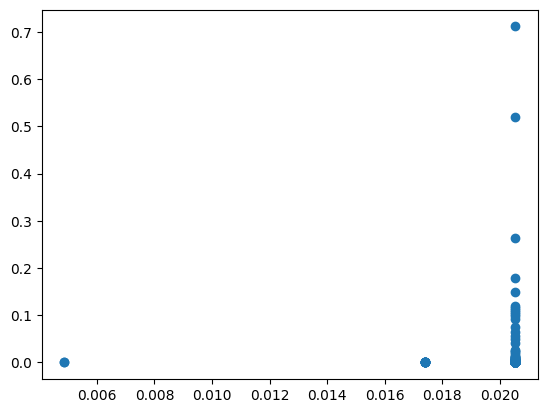

2022-08-21 05:34:55.552 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:34:55.553 | INFO     | __main__:apply_mean:92 - [0.004868629759447238, 0.004868629759447238, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.017416294458072523, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.020531732503616926, 0.0

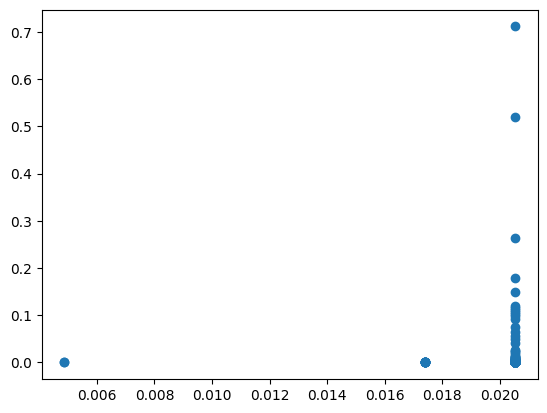

2022-08-21 05:34:55.747 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.012547664698625286, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003115438045544403, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0

2022-08-21 05:34:55.832 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:55.835 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:55.838 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.002244336275532834], [0.003428167257547367], [0.0012440124475700514], [0.012101145510719292], [0.0013171764334257482], [0.0158784651852146], [0.02269024494303222], [0.0031117016963689093], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012

2022-08-21 05:34:55.853 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:55.855 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:55.859 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292], [0.0013171764334257482], [0.0158784651852146], [0.02269024494303222], [0.0031117016963689093], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369

2022-08-21 05:34:55.872 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:55.874 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:55.877 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292], [0.0013171764334257482], [0.0158784651852146], [0.02269024494303222], [0.0031117016963689093], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.01237

2022-08-21 05:34:55.899 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:55.902 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:55.906 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.0158784651852146], [0.02269024494303222], [0.0031117016963689093], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.04536900

2022-08-21 05:34:55.922 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:55.925 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:55.933 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.0158784651852146], [0.02269024494303222], [0.0031117016963689093], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.0453690033

2022-08-21 05:34:55.953 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}


Sstar: 0.9498232021998179
Tstar: 1.0
stress: 0.9745887349029938
Sstar: Autograd ArrayBox with value 1.052290260604403
Tstar: 1.0


2022-08-21 05:34:55.955 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:55.960 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.0158784651852146], [0.02269024494303222], [0.0031117016963689093], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006], [0.0020823274275361425], [0.02449022211781734], [0.0883911

2022-08-21 05:34:55.977 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:55.982 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:55.986 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.0158784651852146], [0.02269024494303222, 0.0031117016963689093], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.01237

2022-08-21 05:34:55.996 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:55.998 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.003 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.04536900336270

2022-08-21 05:34:56.014 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.017 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.021 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04377175831771561], [0.018278835448907505], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.04536900336270

2022-08-21 05:34:56.042 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:56.044 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.047 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.018278835448907505, 0.04377175831771561], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234

2022-08-21 05:34:56.066 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.075 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.079 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.018278835448907505, 0.04377175831771561], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.0453690033627049

2022-08-21 05:34:56.111 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.115 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:56.119 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.018278835448907505, 0.04377175831771561], [0.04354063368885137], [0.005882800022343653], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.0123742581

2022-08-21 05:34:56.129 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.131 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.136 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.018278835448907505, 0.04377175831771561], [0.005882800022343653, 0.04354063368885137], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975]

2022-08-21 05:34:56.145 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:56.146 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.152 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.0222342560

2022-08-21 05:34:56.160 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.162 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.165 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634], [0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975],

2022-08-21 05:34:56.178 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.180 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.182 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.0222342560880

2022-08-21 05:34:56.189 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.191 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.199 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613], [0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502],

2022-08-21 05:34:56.217 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.219 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.222 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765], [0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0

2022-08-21 05:34:56.231 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.233 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.235 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006

2022-08-21 05:34:56.245 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.258 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.263 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939], [0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.0123

2022-08-21 05:34:56.280 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.286 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.288 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939, 0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006]

2022-08-21 05:34:56.301 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.303 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.306 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939, 0.02062288167929016], [0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.02

2022-08-21 05:34:56.316 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.318 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.322 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939, 0.02062288167929016, 0.018396729242233855], [0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.01237

2022-08-21 05:34:56.333 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.335 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.339 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006], [0.

2022-08-21 05:34:56.353 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.355 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.359 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332], [0.03843399639498556], [0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.0123742581

2022-08-21 05:34:56.382 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.387 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.389 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332], [0.03843399639498556, 0.006751284713719876], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006], [0.0

2022-08-21 05:34:56.405 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:56.407 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.409 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332], [0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006], [0.0

2022-08-21 05:34:56.420 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.429 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.431 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006], [0.00208

2022-08-21 05:34:56.447 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.449 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.453 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05041644771832578], [0.05316636129982986], [0.012288058777000508], [0.045369003362704975], [0.0123742581586505

2022-08-21 05:34:56.465 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.467 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.475 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05041644771832578], [0.05316636129982986, 0.012288058777000508], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006], [0.0020823

2022-08-21 05:34:56.486 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:56.488 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.491 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05316636129982986, 0.012288058777000508, 0.05041644771832578], [0.045369003362704975], [0.012374258158650502], [0.022234256088067006], [0.0020823

2022-08-21 05:34:56.503 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.506 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.510 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05316636129982986, 0.012288058777000508, 0.05041644771832578], [0.045369003362704975], [0.012374258158650502

2022-08-21 05:34:56.529 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.531 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:56.533 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05316636129982986, 0.012288058777000508, 0.05041644771832578], [0.045369003362704975], [0.012374258158650502], [0.02223425608

2022-08-21 05:34:56.544 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.548 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.552 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05316636129982986, 0.012288058777000508, 0.05041644771832578], [0.012374258158650502, 0.045369003362704975], [0.02223425608806700

2022-08-21 05:34:56.561 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.563 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:56.566 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.05316636129982986, 0.012288058777000508, 0.05041644771832578], [0.012374258158650502, 0.045369003362704975, 0.02223425608806

2022-08-21 05:34:56.585 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.587 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.590 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578], 

2022-08-21 05:34:56.598 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.600 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.603 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:56.625 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.626 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.628 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:56.638 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.639 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.643 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:56.654 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.656 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:56.660 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:56.682 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:56.684 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.688 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:56.708 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.722 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:56.726 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.050416447718325

2022-08-21 05:34:56.750 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.753 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.757 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:56.769 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.771 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:56.792 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.796 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.804 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:56.827 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.831 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.835 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:56.851 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.853 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.856 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:56.871 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.873 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.875 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:56.885 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:56.887 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.890 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:56.900 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.901 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.911 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:56.919 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.925 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:56.928 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:56.940 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.941 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:56.945 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:56.954 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.956 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.957 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:56.970 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:56.972 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:56.975 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:56.985 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:56.992 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:56.995 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.004 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.005 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:57.007 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:57.019 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.021 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.025 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:57.034 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.036 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.038 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:57.046 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.049 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:57.051 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:57.062 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.064 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.066 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.075 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.077 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:57.080 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:57.088 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.091 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:57.119 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:57.135 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:57.138 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:57.143 | INFO     | __main__:eval_direction_expand:42 - merging up at index 14 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:57.163 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:57.166 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.173 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:57.189 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.197 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.200 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:57.211 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:57.214 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.216 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:57.228 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.230 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.234 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.256 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.258 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:57.264 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:34:57.273 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:57.275 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.278 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:57.291 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:57.293 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.296 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:57.305 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:57.307 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.321 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:57.333 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.335 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.338 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.358 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.362 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:57.368 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:57.386 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:57.389 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.395 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:57.412 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.416 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.422 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.456 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:57.461 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.469 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:57.483 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.485 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.487 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.500 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.503 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:57.507 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:57.518 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.522 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.525 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:57.538 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.540 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.541 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:57.552 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.554 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:57.556 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:57.565 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.566 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.569 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:57.579 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.581 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.583 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.591 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.592 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:57.596 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:57.614 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.615 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.618 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:57.626 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.632 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.633 | INFO     | __main__:stabilize_block:65 - at end of iteration 14, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.648 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.651 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:57.656 | INFO     | __main__:stabilize_block:65 - at end of iteration 16, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:34:57.673 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.676 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.678 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.692 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:57.697 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.699 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:57.710 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.712 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.715 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.725 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.727 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:57.731 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:57.744 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:57.747 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:57.750 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:57.790 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:57.797 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:57.802 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:57.820 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:57.825 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:57.832 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:57.861 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.864 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.870 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:57.887 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:57.890 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:57.895 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:57.913 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.916 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.920 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:57.954 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:57.957 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.961 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:57.979 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:57.984 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:57.988 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:58.012 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.022 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.027 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:58.045 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.048 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.052 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:58.064 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.066 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.071 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:58.089 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.092 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.096 | INFO     | __main__:eval_direction_expand:42 - merging down at index 22 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.050416447718325

2022-08-21 05:34:58.105 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.107 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:58.116 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:58.126 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.129 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:58.138 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:58.147 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:58.150 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.153 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:34:58.163 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:58.166 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.169 | INFO     | __main__:eval_direction_expand:42 - merging down at index 24 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:58.182 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:58.191 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.194 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:58.202 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.203 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.206 | INFO     | __main__:eval_direction_expand:42 - merging down at index 23 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.050416447718325

2022-08-21 05:34:58.216 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.218 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.221 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:58.229 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.231 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.234 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:58.246 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:58.249 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.259 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:58.275 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.278 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.282 | INFO     | __main__:eval_direction_expand:42 - merging up at index 22 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:58.294 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.296 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.300 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:58.322 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:58.324 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.327 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:58.338 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:58.340 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.342 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753

2022-08-21 05:34:58.352 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:58.355 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.358 | INFO     | __main__:stabilize_block:65 - at end of iteration 15, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:58.377 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:58.380 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.384 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:58.394 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:58.400 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:58.403 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:34:58.416 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.418 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.425 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:58.436 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.439 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.442 | INFO     | __main__:eval_direction_expand:42 - merging down at index 27 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.050416447718325

2022-08-21 05:34:58.460 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.464 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.467 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:58.476 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.483 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.486 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:58.504 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.507 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:58.511 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:58.526 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:58.530 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.532 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:34:58.542 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:58.548 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.550 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:58.560 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:58.567 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.569 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:58.579 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:58.582 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.585 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:58.595 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.597 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.600 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:58.622 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.624 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.628 | INFO     | __main__:eval_direction_expand:42 - merging down at index 26 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:58.638 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.641 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.644 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:58.654 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.656 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.670 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:58.680 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:58.681 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.683 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:58.690 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.692 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:58.694 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:34:58.703 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:58.704 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.706 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:58.715 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:58.717 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.719 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:58.727 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.728 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.733 | INFO     | __main__:eval_direction_expand:42 - merging up at index 30 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:58.788 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.791 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.794 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:58.811 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:58.813 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.815 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:58.825 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.827 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.831 | INFO     | __main__:eval_direction_expand:42 - merging up at index 30 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:58.841 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:58.844 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.860 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:58.872 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.875 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:58.884 | INFO     | __main__:eval_direction_expand:42 - merging up at index 31 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:58.898 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.900 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:58.904 | INFO     | __main__:eval_direction_expand:42 - merging down at index 31 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.050416447718325

2022-08-21 05:34:58.918 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.920 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:58.924 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:58.936 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:58.938 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:58.943 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:58.955 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:58.957 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:58.960 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:34:58.984 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:58.986 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:58.991 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:59.010 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.015 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.019 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.031 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:59.034 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.036 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:59.045 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:59.047 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:59.051 | INFO     | __main__:eval_direction_expand:42 - merging down at index 32 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:59.064 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:59.067 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.070 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:34:59.089 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.091 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.094 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:59.108 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:59.110 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.113 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:34:59.124 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.126 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.129 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.146 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:59.148 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.150 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:59.159 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:59.161 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:59.164 | INFO     | __main__:eval_direction_expand:42 - merging down at index 32 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:59.173 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:59.175 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.178 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:34:59.189 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.191 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.195 | INFO     | __main__:eval_direction_expand:42 - merging up at index 35 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:59.206 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.208 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.212 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:59.222 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.225 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.226 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:59.248 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.250 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.254 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:59.265 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:59.267 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.270 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:59.280 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:59.282 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.284 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:59.300 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.301 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.303 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.341 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:59.349 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.353 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:59.370 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.372 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.374 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.391 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:59.393 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.398 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:34:59.413 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.415 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.418 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.433 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.435 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.439 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:59.454 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.456 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.460 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:59.495 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.497 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.499 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:59.510 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.512 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.516 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:34:59.532 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.534 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.536 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.550 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.551 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.554 | INFO     | __main__:eval_direction_expand:42 - merging up at index 39 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:59.565 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.574 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.577 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:59.587 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.589 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.591 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:59.603 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.605 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.608 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0

2022-08-21 05:34:59.617 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:34:59.618 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.620 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:59.629 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.631 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.633 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.641 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.643 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.647 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:59.670 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.672 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.676 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:59.691 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.693 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.694 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536142

2022-08-21 05:34:59.702 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.704 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.707 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:59.715 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.717 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:59.720 | INFO     | __main__:eval_direction_expand:42 - merging down at index 41 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:34:59.727 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.729 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.732 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:59.741 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.743 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.746 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:34:59.756 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.758 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.770 | INFO     | __main__:eval_direction_expand:42 - merging up at index 42 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:59.780 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.782 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:59.786 | INFO     | __main__:eval_direction_expand:42 - merging down at index 42 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.050416447718325

2022-08-21 05:34:59.795 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.815 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.820 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:59.831 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.833 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:34:59.836 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:34:59.850 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:34:59.853 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.858 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:34:59.868 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:34:59.869 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:34:59.872 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:34:59.892 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.894 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.897 | INFO     | __main__:eval_direction_expand:42 - merging up at index 42 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0

2022-08-21 05:34:59.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:34:59.909 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:34:59.912 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 

2022-08-21 05:34:59.923 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.939 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.941 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:59.955 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.957 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:34:59.960 | INFO     | __main__:eval_direction_expand:42 - merging down at index 44 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.050416447718325

2022-08-21 05:34:59.976 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.978 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:34:59.981 | INFO     | __main__:eval_direction_expand:42 - merging up at index 43 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 

2022-08-21 05:34:59.989 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:34:59.992 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.001 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508,

2022-08-21 05:35:00.010 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:00.012 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:00.016 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.028 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.030 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.032 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:35:00.045 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.047 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.049 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:35:00.060 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.062 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.063 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:35:00.082 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.084 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.086 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:35:00.104 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.106 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.110 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:35:00.127 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.129 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.133 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:35:00.142 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.144 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.146 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:35:00.158 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.160 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.162 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:35:00.174 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.176 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.178 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:35:00.186 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.188 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.189 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:35:00.196 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:00.199 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:00.212 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:35:00.223 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.225 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.233 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.245 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.247 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.249 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.00208232742753614

2022-08-21 05:35:00.260 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.263 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.271 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.002082327427536

2022-08-21 05:35:00.280 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.286 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.289 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.299 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.303 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:00.306 | INFO     | __main__:eval_direction_expand:42 - merging down at index 48 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164477183257

2022-08-21 05:35:00.313 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.317 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:00.319 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.

2022-08-21 05:35:00.327 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.329 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.331 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361

2022-08-21 05:35:00.338 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.341 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.344 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

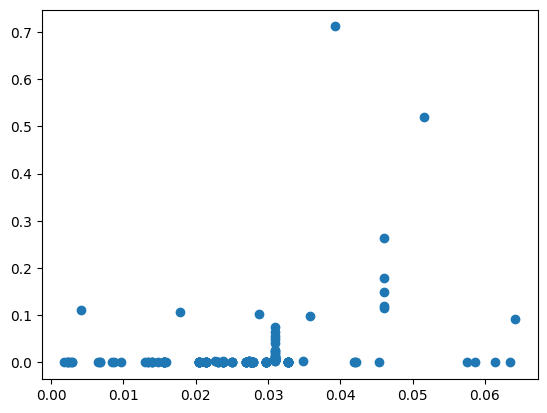

2022-08-21 05:35:00.642 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:35:00.645 | INFO     | __main__:apply_mean:92 - [0.002244336275532834, 0.002336089852558709, 0.002336089852558709, 0.00670916097207252, 0.00670916097207252, 0.013893470608205241, 0.013893470608205241, 0.013893470608205241, 0.027868506869454534, 0.027868506869454534, 0.027868506869454534, 0.027868506869454534, 0.04185423855041796, 0.01295832587645324, 0.025016790095555436, 0.025016790095555436, 0.025016790095555436, 0.025016790095555436, 0.02696407053990618, 0.02696407053990618, 0.02696407053990618, 0.02696407053990618, 0.02696407053990618, 0.02696407053990618, 0.02696407053990618, 0.02780261686874151, 0.02780261686874151, 0.02780261686874151, 0.02780261686874151, 0.02780261686874151, 0.02780261686874151, 0.02780261686874151, 0.02780261686874151, 0.02781709795396919, 0.02781709795396919, 0.02781709795396919, 0.02781709795396919, 0.02781709795396919, 0.02781709795396919, 0.02781709795396919, 0.04217

2022-08-21 05:35:00.667 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.671 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.678 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.705 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.708 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.714 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.746 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.749 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.753 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.768 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.769 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.787 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.790 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.794 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796], [0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0

2022-08-21 05:35:00.815 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.818 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.821 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.04185423855041796, 0.01295832587645324], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425

2022-08-21 05:35:00.833 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:00.836 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.838 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561], [0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425

2022-08-21 05:35:00.848 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.850 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 0.

2022-08-21 05:35:00.873 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:00.875 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:00.879 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164

2022-08-21 05:35:00.891 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.902 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.905 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041

2022-08-21 05:35:00.916 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.921 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.924 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041

2022-08-21 05:35:00.946 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:00.948 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:00.950 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 0.

2022-08-21 05:35:00.967 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:00.969 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:00.972 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.0504164

2022-08-21 05:35:00.986 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:00.990 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:00.993 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041

2022-08-21 05:35:01.008 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.010 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.015 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 0.

2022-08-21 05:35:01.024 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.025 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.027 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 

2022-08-21 05:35:01.039 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.048 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.051 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 0.

2022-08-21 05:35:01.058 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.067 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.070 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 

2022-08-21 05:35:01.080 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.083 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.086 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 0.

2022-08-21 05:35:01.107 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.109 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.112 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 

2022-08-21 05:35:01.124 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.126 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.129 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.012374258158650502, 0.045369003362704975, 0.022234256088067006, 0.05316636129982986, 0.012288058777000508, 0.05041644771832578, 0.0020823274275361425, 0.

2022-08-21 05:35:01.153 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.154 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.156 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.01

2022-08-21 05:35:01.172 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.173 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.175 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.03843399639498556, 0.006751284713719876, 0.07970097964107939, 0.02062288167929016, 0.018396729242233855, 0.0017341767304340332, 0.0231084453776004], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.0115

2022-08-21 05:35:01.187 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.192 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.194 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022

2022-08-21 05:35:01.205 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.207 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.210 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.04185423855041796, 0.01295832587645324, 0.005882800022343653, 0.04354063368885137, 0.018278835448907505, 0.04377175831771561, 0.05015882575411634, 0.02659829401216613, 0.021367874126593765, 0.0019421664893455061], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.0226

2022-08-21 05:35:01.221 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.223 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.224 | INFO     | __main__:stabilize_block:65 - at end of iteration 11, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08

2022-08-21 05:35:01.244 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:01.246 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:01.250 | INFO     | __main__:stabilize_block:65 - at end of iteration 13, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713

2022-08-21 05:35:01.261 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.264 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:01.277 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.279 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.285 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.088

2022-08-21 05:35:01.293 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.295 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.298 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:01.319 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.321 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.323 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.088

2022-08-21 05:35:01.334 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.336 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.337 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:01.344 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:01.348 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:01.352 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.0241649752

2022-08-21 05:35:01.360 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:01.362 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:01.367 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713

2022-08-21 05:35:01.388 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:01.389 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:01.393 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:01.403 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.405 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.407 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.0883

2022-08-21 05:35:01.419 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.420 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.422 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:01.431 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:01.434 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.436 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.088

2022-08-21 05:35:01.445 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.448 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.451 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:01.460 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:01.462 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:01.466 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289

2022-08-21 05:35:01.486 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:01.487 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:01.490 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:01.513 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:01.515 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:01.519 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:01.534 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.535 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.537 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:01.553 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:01.557 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:01.560 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975

2022-08-21 05:35:01.571 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:01.572 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:01.575 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713

2022-08-21 05:35:01.588 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:01.589 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:01.591 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.088391

2022-08-21 05:35:01.610 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:01.612 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:01.617 | INFO     | __main__:eval_direction_expand:42 - merging up at index 15 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975

2022-08-21 05:35:01.626 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:01.632 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:01.634 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.02416

2022-08-21 05:35:01.645 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:01.647 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:01.650 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:01.660 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:01.665 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:01.667 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.02416497

2022-08-21 05:35:01.676 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:01.678 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:01.683 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.0318071

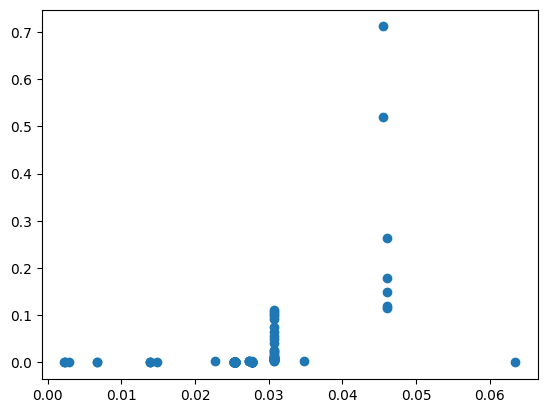

2022-08-21 05:35:02.126 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:35:02.128 | INFO     | __main__:apply_mean:92 - [0.002244336275532834, 0.002336089852558709, 0.002336089852558709, 0.00670916097207252, 0.00670916097207252, 0.013893470608205241, 0.013893470608205241, 0.013893470608205241, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025

2022-08-21 05:35:02.137 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:02.139 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.141 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:02.155 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:02.156 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.159 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:02.167 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:02.168 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.170 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:02.183 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:02.184 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.186 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:02.196 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:02.199 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.202 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:02.221 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:02.222 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.225 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:02.237 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:02.240 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:02.251 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:02.266 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:02.269 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:02.272 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.0241649752

2022-08-21 05:35:02.285 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:02.288 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:02.291 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164

2022-08-21 05:35:02.299 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:02.301 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:02.310 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975

2022-08-21 05:35:02.320 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:02.322 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.326 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.0318071

2022-08-21 05:35:02.339 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:02.342 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:02.345 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975

2022-08-21 05:35:02.354 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:02.364 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.367 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.0318071

2022-08-21 05:35:02.376 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:02.388 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:02.390 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.088391

2022-08-21 05:35:02.401 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:02.403 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:02.406 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289

2022-08-21 05:35:02.417 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:02.419 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:02.423 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.031807132

2022-08-21 05:35:02.441 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:02.445 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:02.449 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289707888, 0.024164975294996956, 0.08839

2022-08-21 05:35:02.465 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:02.468 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:02.472 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.002244336275532834], [0.003428167257547367, 0.0012440124475700514], [0.012101145510719292, 0.0013171764334257482], [0.02269024494303222, 0.0031117016963689093, 0.0158784651852146], [0.0420092785474394, 0.0018133068658033802, 0.04916592219035874, 0.03245393532263391, 0.010830987530844481, 0.07976391020047946, 0.03552543932880013, 0.011587374466611271, 0.03376218585983741, 0.008649422189078226, 0.011468490580941609, 0.04850122073723363, 0.04396945634258827, 0.033309337365873916, 0.022613221537920326, 0.010550471277941417, 0.012969542798704718, 0.0028420199832130504, 0.0421794405071749, 0.01589783197241555, 0.006514432157542616, 0.021853851727863347, 0.03180713289

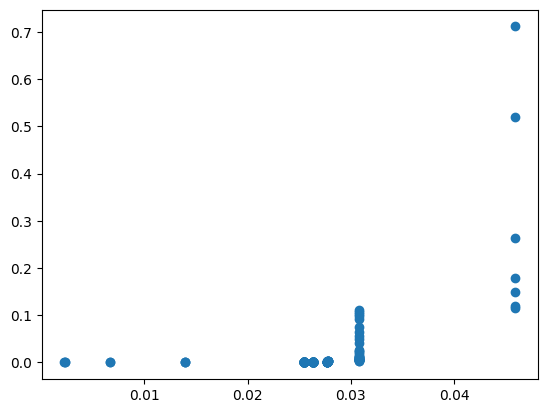

2022-08-21 05:35:02.765 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:35:02.766 | INFO     | __main__:apply_mean:92 - [0.002244336275532834, 0.002336089852558709, 0.002336089852558709, 0.00670916097207252, 0.00670916097207252, 0.013893470608205241, 0.013893470608205241, 0.013893470608205241, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025419781043725227, 0.025

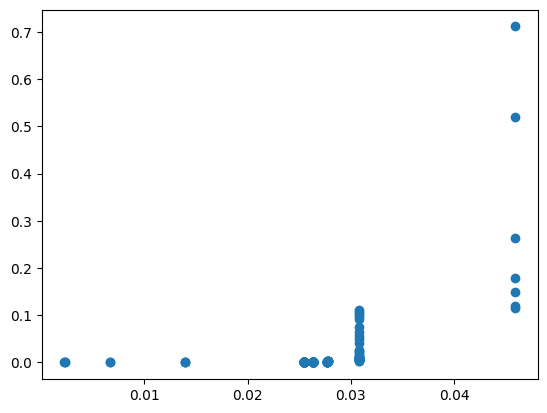

2022-08-21 05:35:02.961 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[9.175357702587497e-05, 0.0, 0.004373071119513811, 0.0, 0.007184309636132721, 0.0, 0.0, 0.011526310435519986, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0009063723736924718, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0013778566541299136, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0001257075640727287, 0.0, 0.0, 0.0, 0.0, 0.0, 0.00294295083260724, 0.0, 0.0, 0.0, 0.0

2022-08-21 05:35:03.047 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.049 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:03.055 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.03606722941508261], [0.028686041738448298], [0.03706984375937384], [0.022140270929448036], [0.013167354814667919], [0.00992451126700401], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.007398487

2022-08-21 05:35:03.062 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:03.064 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.069 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.028686041738448298, 0.03606722941508261], [0.03706984375937384], [0.022140270929448036], [0.013167354814667919], [0.00992451126700401], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.068

2022-08-21 05:35:03.078 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:03.079 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.084 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.028686041738448298, 0.03606722941508261], [0.03706984375937384], [0.022140270929448036], [0.013167354814667919], [0.00992451126700401], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777

2022-08-21 05:35:03.111 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:03.113 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.117 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.028686041738448298, 0.03606722941508261], [0.03706984375937384], [0.022140270929448036, 0.013167354814667919], [0.00992451126700401], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.068916

2022-08-21 05:35:03.127 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:03.129 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.132 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.028686041738448298, 0.03606722941508261], [0.022140270929448036, 0.013167354814667919, 0.03706984375937384], [0.00992451126700401], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.068916

2022-08-21 05:35:03.147 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:03.149 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.152 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.028686041738448298, 0.03606722941508261], [0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.0689167616

Sstar: 0.8885614006518348
Tstar: 1.0
stress: 0.9426353487175382
Sstar: Autograd ArrayBox with value 0.9920667186292847
Tstar: 1.0


2022-08-21 05:35:03.166 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:03.168 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.170 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.0689167616

2022-08-21 05:35:03.181 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:03.185 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.189 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899], [0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481],

2022-08-21 05:35:03.200 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:03.202 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.204 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.055176124075287464], [0.03623820093699294], [0.03151234897826899, 0.0060727630243122286], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797

2022-08-21 05:35:03.215 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:03.220 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.222 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.055176124075287464], [0.03151234897826899, 0.0060727630243122286, 0.03623820093699294], [0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797

2022-08-21 05:35:03.244 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:03.247 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.252 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.055176124075287464], [0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797584]

2022-08-21 05:35:03.275 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:03.278 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.284 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464], [0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797584]

2022-08-21 05:35:03.301 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:03.305 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.314 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797584], [0

2022-08-21 05:35:03.331 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:03.333 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.336 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797584], [0

2022-08-21 05:35:03.355 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:03.357 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.362 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311

2022-08-21 05:35:03.374 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:03.383 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.386 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.06707578591250764], [0.025519482431441393], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.068

2022-08-21 05:35:03.394 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:03.395 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:03.399 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254

2022-08-21 05:35:03.412 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.414 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:03.416 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.0822531125

2022-08-21 05:35:03.423 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.425 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.427 | INFO     | __main__:eval_direction_expand:42 - merging up at index 6 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881], [0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676

2022-08-21 05:35:03.433 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.435 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.438 | INFO     | __main__:eval_direction_expand:42 - merging down at index 6 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.06110131396129659], [0.06594260011835869], [0.0710166909730881, 0.008457113159094823], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.068916

2022-08-21 05:35:03.447 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.449 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.452 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.06110131396129659], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869], [0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.068916761627

2022-08-21 05:35:03.464 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.467 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.469 | INFO     | __main__:eval_direction_expand:42 - merging down at index 5 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.06110131396129659], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.0689167616

2022-08-21 05:35:03.494 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.497 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.501 | INFO     | __main__:eval_direction_expand:42 - merging up at index 4 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659], [0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.0689167616279758

2022-08-21 05:35:03.509 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.511 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.515 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.025519482431441393, 0.06707578591250764], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797

2022-08-21 05:35:03.522 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.524 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:03.529 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0

2022-08-21 05:35:03.545 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.548 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:03.552 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0

2022-08-21 05:35:03.562 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.564 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.566 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606], [0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797584], 

2022-08-21 05:35:03.573 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.574 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.576 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.034577235681072946], [0.03476015725099606, 0.014903932948968723], [0.00739848777199481], [0.08225311254180216], [0.06891676162797584]

2022-08-21 05:35:03.585 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.592 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.595 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946], [0.00739848777199481], [0.08225311254180216], [0.06891676162797584], [0.0

2022-08-21 05:35:03.604 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.606 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.610 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.08225311254180216], [0.068

2022-08-21 05:35:03.622 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.623 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.626 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.08225311254180216], [0.06891676162797584], [0.024

2022-08-21 05:35:03.639 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.640 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.643 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.08225311254180216], [0.06891676162797584, 0.0

2022-08-21 05:35:03.656 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.658 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.661 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.06891676162797584, 0.024687605086873135, 0.082253

2022-08-21 05:35:03.677 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.679 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.684 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.06891676162797584, 0.02468

2022-08-21 05:35:03.695 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:03.697 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.699 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.06891676162797584, 0.024687605086873135, 0.08225311254180216, 0.0240

2022-08-21 05:35:03.718 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:03.720 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:03.723 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.06891676162797584, 0.024687605

2022-08-21 05:35:03.737 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:03.742 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.745 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.06891676162797584, 0.024687605086873135, 0.08

2022-08-21 05:35:03.756 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:03.762 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.766 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.06891676162797584, 0.024687605086873135, 0.0822531

2022-08-21 05:35:03.775 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.781 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.784 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.06891676162797584, 0.024687605086873135, 0.08

2022-08-21 05:35:03.793 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.794 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.798 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.02879

2022-08-21 05:35:03.808 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.810 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.813 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.065

2022-08-21 05:35:03.823 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:03.824 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:03.827 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.028799166727283505, 0.06

2022-08-21 05:35:03.842 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:03.845 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.849 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.028799

2022-08-21 05:35:03.861 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:03.863 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.868 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.0659

2022-08-21 05:35:03.879 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.882 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.885 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.0287

2022-08-21 05:35:03.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.908 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:03.912 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.065

2022-08-21 05:35:03.920 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.925 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.927 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.0287

2022-08-21 05:35:03.934 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.939 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.943 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.

2022-08-21 05:35:03.954 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.956 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:03.960 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.0287

2022-08-21 05:35:03.971 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.973 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:03.979 | INFO     | __main__:eval_direction_expand:42 - merging down at index 11 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.

2022-08-21 05:35:03.993 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:03.995 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:04.000 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.0287

2022-08-21 05:35:04.019 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.023 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:04.029 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598468271476654, 0.

2022-08-21 05:35:04.044 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.048 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.063 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.0033295310836816516, 0.06598

2022-08-21 05:35:04.082 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.085 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.088 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:04.108 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.110 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:04.114 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:04.132 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.135 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:04.139 | INFO     | __main__:eval_direction_expand:42 - merging down at index 13 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:04.158 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.160 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.164 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:04.177 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.179 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.188 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:04.199 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.201 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:04.208 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:04.222 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.225 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.227 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.236 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.238 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.240 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:04.256 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.258 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.260 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.272 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.274 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:04.277 | INFO     | __main__:eval_direction_expand:42 - merging up at index 13 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:04.289 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.291 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:04.294 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:04.307 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.309 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.312 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:04.321 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.323 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.325 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:04.348 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.350 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:04.355 | INFO     | __main__:eval_direction_expand:42 - merging down at index 14 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:04.371 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.373 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.377 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:04.403 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.405 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.409 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:04.432 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.433 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.435 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:04.449 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.451 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.453 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.463 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.464 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.468 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:04.487 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.489 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.490 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.498 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.502 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.504 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:04.515 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.521 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.522 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.531 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.532 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.534 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:04.544 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.546 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.547 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.563 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.565 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.568 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:04.580 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.582 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:04.587 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:04.605 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.608 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.611 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.625 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.627 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:04.630 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:04.639 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.642 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:04.646 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:04.667 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.670 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:04.675 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:04.687 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.691 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:04.695 | INFO     | __main__:eval_direction_expand:42 - merging down at index 20 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.

2022-08-21 05:35:04.706 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.708 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.712 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:04.724 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.726 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:04.730 | INFO     | __main__:eval_direction_expand:42 - merging up at index 21 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:04.742 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.744 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:04.748 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.

2022-08-21 05:35:04.764 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.766 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:04.773 | INFO     | __main__:eval_direction_expand:42 - merging up at index 20 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:04.781 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:04.783 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:04.787 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:04.800 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.804 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.806 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:04.816 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.818 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.821 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:04.831 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.833 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.834 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.847 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.848 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:04.851 | INFO     | __main__:eval_direction_expand:42 - merging up at index 19 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:04.859 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.861 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:04.864 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:04.874 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.876 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.878 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.886 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:04.887 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.899 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:04.912 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:04.914 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.916 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:04.927 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:04.929 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:04.930 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:04.939 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.942 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:04.946 | INFO     | __main__:eval_direction_expand:42 - merging down at index 21 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:04.959 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:04.985 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:04.988 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:05.001 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:05.005 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:05.010 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:05.026 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:05.029 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.035 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:05.060 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.063 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.072 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:05.084 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.088 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:05.095 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:05.125 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.128 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.133 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:05.168 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:05.171 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.174 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:05.196 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.201 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.205 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:05.234 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.237 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:05.242 | INFO     | __main__:eval_direction_expand:42 - merging up at index 23 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:05.259 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.263 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.275 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:05.292 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.295 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.301 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:05.318 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.322 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:05.327 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:05.357 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:05.360 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:05.367 | INFO     | __main__:eval_direction_expand:42 - merging down at index 25 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:05.390 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:05.394 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:05.402 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:05.422 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:05.426 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:05.441 | INFO     | __main__:eval_direction_expand:42 - merging up at index 26 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:05.458 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:05.468 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.474 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:05.494 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:05.497 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:05.503 | INFO     | __main__:eval_direction_expand:42 - merging up at index 27 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:05.515 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:05.519 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.522 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:05.540 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.543 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.546 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:05.566 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:05.568 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.571 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:05.592 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.594 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.597 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:05.613 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:05.615 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.618 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:05.637 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.639 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.641 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:05.660 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.663 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:05.667 | INFO     | __main__:eval_direction_expand:42 - merging up at index 25 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:05.680 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.683 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.688 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:05.702 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.705 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.707 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:05.716 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.719 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:05.723 | INFO     | __main__:stabilize_block:65 - at end of iteration 12, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:05.737 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:05.741 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:05.744 | INFO     | __main__:eval_direction_expand:42 - merging down at index 28 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:05.755 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:05.770 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:05.773 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:05.787 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:05.789 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.791 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:05.799 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:05.802 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.805 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:05.814 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:05.817 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.821 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:05.842 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.850 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.854 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:05.866 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.869 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:05.873 | INFO     | __main__:eval_direction_expand:42 - merging up at index 30 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:05.881 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.884 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:05.889 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:05.909 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.911 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.914 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:05.926 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:05.928 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.931 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:05.952 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:05.954 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:05.959 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:05.971 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:05.972 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:05.976 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:05.987 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:05.989 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:05.992 | INFO     | __main__:eval_direction_expand:42 - merging down at index 31 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:06.013 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.016 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.020 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:06.031 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.035 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.038 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:06.054 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.062 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.064 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:06.080 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.082 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.087 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.099 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.102 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.106 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:06.116 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.119 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.122 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.132 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.135 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.139 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:06.161 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.163 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.165 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.185 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.188 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.191 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:06.199 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.202 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.205 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.229 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:06.230 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.236 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:06.255 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.257 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.261 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:06.279 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.281 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.287 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:06.299 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.302 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.305 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.316 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.328 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.330 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:06.343 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.345 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:06.348 | INFO     | __main__:eval_direction_expand:42 - merging down at index 34 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:06.358 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.360 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.363 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:06.381 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:06.384 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:06.390 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:06.399 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:06.401 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.405 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:06.416 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.419 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.423 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:06.436 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:06.439 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:06.442 | INFO     | __main__:eval_direction_expand:42 - merging up at index 36 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:06.452 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:06.455 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.459 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:06.491 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.493 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.495 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:06.511 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:06.512 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.516 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:06.528 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.530 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.535 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:06.548 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.552 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.555 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.567 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.569 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.586 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:06.595 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.597 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.604 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:06.615 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.619 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:06.622 | INFO     | __main__:eval_direction_expand:42 - merging down at index 39 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:06.631 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.632 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.640 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:06.660 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.663 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.665 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:06.684 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.688 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.691 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:06.721 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.724 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.726 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.741 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:06.746 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:06.748 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:06.758 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:06.760 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.763 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:06.774 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:06.776 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:06.779 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:06.794 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:06.796 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:06.798 | INFO     | __main__:eval_direction_expand:42 - merging down at index 41 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.

2022-08-21 05:35:06.806 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:06.813 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:06.816 | INFO     | __main__:eval_direction_expand:42 - merging up at index 40 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:06.829 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:06.831 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.836 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:06.847 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:06.849 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:06.860 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.862 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.864 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:06.872 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:06.874 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.875 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:06.886 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:06.888 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.897 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:06.910 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.912 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:06.916 | INFO     | __main__:eval_direction_expand:42 - merging down at index 43 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:06.937 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.939 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:06.943 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:06.973 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:06.976 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:06.978 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:06.994 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:06.996 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:06.999 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:07.013 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:07.015 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:07.020 | INFO     | __main__:eval_direction_expand:42 - merging down at index 44 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:07.029 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:07.030 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.032 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:07.041 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:07.043 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.046 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': True, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0

2022-08-21 05:35:07.053 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:07.055 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:07.062 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:07.064 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.065 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:07.076 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:07.077 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.078 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:07.085 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.086 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:07.088 | INFO     | __main__:eval_direction_expand:42 - merging up at index 41 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:07.095 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.096 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:07.098 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:07.105 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:07.107 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:07.115 | INFO     | __main__:eval_direction_expand:42 - merging up at index 45 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:07.125 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:07.127 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:07.132 | INFO     | __main__:eval_direction_expand:42 - merging down at index 45 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.

2022-08-21 05:35:07.142 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:07.144 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:07.146 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342

2022-08-21 05:35:07.155 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:07.157 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:07.159 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:07.167 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:07.169 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.177 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:07.187 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.228 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:07.232 | INFO     | __main__:eval_direction_expand:42 - merging up at index 44 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:07.248 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.249 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:07.253 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:07.263 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:07.265 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.267 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:07.282 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.283 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.286 | INFO     | __main__:stabilize_block:65 - at end of iteration 10, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026921

2022-08-21 05:35:07.302 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:07.304 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:07.306 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:07.317 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:07.318 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.319 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:07.327 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:07.328 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.334 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:07.343 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:07.344 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.346 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03

2022-08-21 05:35:07.353 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.354 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:07.356 | INFO     | __main__:eval_direction_expand:42 - merging up at index 46 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:07.363 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.364 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:07.367 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269

2022-08-21 05:35:07.373 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:07.374 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.375 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031

2022-08-21 05:35:07.382 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:07.383 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:07.384 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': False} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.

2022-08-21 05:35:07.390 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:07.391 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:07.393 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:07.399 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:07.401 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:07.402 | INFO     | __main__:eval_direction_expand:42 - merging down at index 48 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0

2022-08-21 05:35:07.408 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:07.409 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:07.411 | INFO     | __main__:eval_direction_expand:42 - merging up at index 47 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:07.418 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:07.419 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:07.440 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.00026

2022-08-21 05:35:07.448 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.449 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.452 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.459 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.461 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.467 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.475 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.477 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.482 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.490 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.491 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.494 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.501 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.502 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.505 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.521 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.522 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.524 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.531 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.532 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.535 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.542 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.543 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.545 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.560 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.561 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.563 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.571 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.573 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.575 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.584 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.585 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.588 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.596 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.597 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.600 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.617 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.618 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.620 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.631 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.632 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.634 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.642 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.644 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.646 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.658 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.659 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.664 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.671 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.672 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.675 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.683 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.684 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.686 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.693 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.695 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.698 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.706 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.718 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.720 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.727 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.728 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.731 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.737 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.745 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.747 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.759 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.760 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.765 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.780 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.783 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.788 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.813 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.818 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.823 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.838 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.841 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.852 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.869 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.871 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.878 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.897 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.899 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.906 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.921 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.924 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.928 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.946 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.955 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.958 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.971 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.973 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.976 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:07.988 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:07.991 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:07.993 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.000 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.001 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.004 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.016 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.017 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.020 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.029 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.030 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.032 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.039 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.040 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.042 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.053 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.054 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.056 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.063 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.064 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.066 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.074 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.076 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.078 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.087 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.088 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.090 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.098 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.105 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.107 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.120 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.122 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.124 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.138 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.139 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.141 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.152 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.152 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.157 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.165 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.169 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.171 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.183 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.185 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.188 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.198 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.206 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.209 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.219 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.220 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.223 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.238 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.239 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.241 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.249 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.250 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.252 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.265 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.266 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.268 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.276 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.278 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.281 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.289 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.290 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.293 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.306 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.307 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.309 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.317 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.318 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.321 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.334 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.335 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.338 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.348 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.349 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.351 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.358 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.361 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.363 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.372 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.373 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.376 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.383 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.384 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.386 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.393 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.395 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.403 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.412 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.416 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.420 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.429 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.433 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.435 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.442 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.446 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.450 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.460 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.461 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.465 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.473 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.474 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.477 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.488 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.490 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.496 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.504 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.505 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.508 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.520 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.521 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.524 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.536 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.537 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.539 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.545 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.546 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.554 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

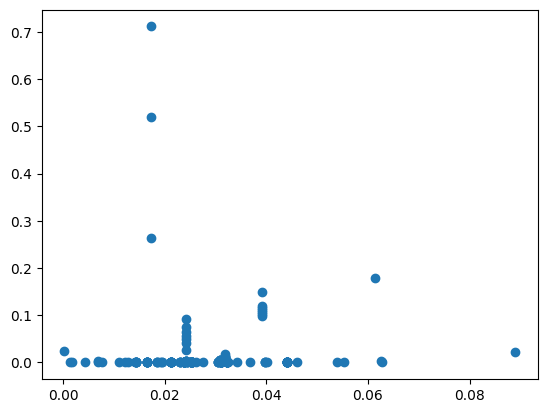

2022-08-21 05:35:08.754 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:35:08.755 | INFO     | __main__:apply_mean:92 - [0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.023790501668709305, 0.010865245614716766, 0.036746400687460656, 0.044112369545584534, 0.044112369545584534, 0.044112369545584534, 0.044112369545584534, 0.044112369545584534, 0.044112369545584534, 0.044112369545584534, 0.044112369545584534, 0.04610732313962737, 0.01213162877219466, 0.0068459382640318105, 0.022909953413258133, 0.022909953413258133, 0.022909953413258133, 0.022909953413258133, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.030967536696948714, 0.03

2022-08-21 05:35:08.769 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.771 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:08.774 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692

2022-08-21 05:35:08.784 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.787 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:08.789 | INFO     | __main__:eval_direction_expand:42 - merging down at index 1 of partition [[0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.010865245614716766], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03

2022-08-21 05:35:08.795 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.796 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.798 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199

2022-08-21 05:35:08.805 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:08.806 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.808 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.000269219

2022-08-21 05:35:08.816 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:08.817 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:08.820 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737], [0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.0342584

2022-08-21 05:35:08.826 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:08.827 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:08.829 | INFO     | __main__:eval_direction_expand:42 - merging down at index 3 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.036746400687460656], [0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.04610732313962737, 0.01213162877219466], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425

2022-08-21 05:35:08.834 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:08.835 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:08.837 | INFO     | __main__:eval_direction_expand:42 - merging up at index 2 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.036746400687460656], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764], [0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925

2022-08-21 05:35:08.850 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:08.851 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:08.853 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.036746400687460656], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105], [0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049

2022-08-21 05:35:08.859 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:08.861 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:08.862 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.036746400687460656], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0312783774049

2022-08-21 05:35:08.868 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:08.876 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:08.877 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656], [0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.031278377404

2022-08-21 05:35:08.883 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:08.885 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:08.887 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0312783774049948

2022-08-21 05:35:08.907 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:08.910 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:08.912 | INFO     | __main__:stabilize_block:65 - at end of iteration 8, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.

2022-08-21 05:35:08.921 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.922 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:08.925 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:08.932 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.934 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:08.942 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:08.953 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.954 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:08.956 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:08.964 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.966 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:08.969 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:08.980 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:08.981 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:08.987 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:08.996 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:08.997 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:08.998 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0312783774049948

2022-08-21 05:35:09.005 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:09.006 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.007 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03127837740499

2022-08-21 05:35:09.014 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:09.015 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.017 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0312783774049948

2022-08-21 05:35:09.024 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.026 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.028 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0

2022-08-21 05:35:09.044 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.045 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.047 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605,

2022-08-21 05:35:09.055 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.060 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.062 | INFO     | __main__:eval_direction_expand:42 - merging up at index 10 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763,

2022-08-21 05:35:09.069 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.070 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.076 | INFO     | __main__:eval_direction_expand:42 - merging down at index 10 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386

2022-08-21 05:35:09.083 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.084 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.086 | INFO     | __main__:eval_direction_expand:42 - merging up at index 9 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 

2022-08-21 05:35:09.097 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.098 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.101 | INFO     | __main__:eval_direction_expand:42 - merging down at index 9 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.034258429253867

2022-08-21 05:35:09.110 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.111 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.113 | INFO     | __main__:eval_direction_expand:42 - merging up at index 8 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 

2022-08-21 05:35:09.121 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.122 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.124 | INFO     | __main__:eval_direction_expand:42 - merging down at index 8 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.034258429253867

2022-08-21 05:35:09.130 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.131 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.140 | INFO     | __main__:eval_direction_expand:42 - merging up at index 7 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 

2022-08-21 05:35:09.146 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.148 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.150 | INFO     | __main__:stabilize_block:65 - at end of iteration 7, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605

2022-08-21 05:35:09.165 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.167 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:09.169 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:09.177 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.178 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.181 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763,

2022-08-21 05:35:09.187 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.189 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.198 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386

2022-08-21 05:35:09.206 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.207 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.209 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763,

2022-08-21 05:35:09.216 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.217 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.219 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605

2022-08-21 05:35:09.226 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:09.227 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.229 | INFO     | __main__:stabilize_block:65 - at end of iteration 4, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03127837740499484

2022-08-21 05:35:09.235 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.236 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:09.239 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.

2022-08-21 05:35:09.256 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.257 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.259 | INFO     | __main__:eval_direction_expand:42 - merging down at index 13 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.034258429253867

2022-08-21 05:35:09.265 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.266 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.272 | INFO     | __main__:eval_direction_expand:42 - merging up at index 12 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 

2022-08-21 05:35:09.277 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.278 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.280 | INFO     | __main__:eval_direction_expand:42 - merging down at index 12 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386

2022-08-21 05:35:09.288 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.289 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.291 | INFO     | __main__:eval_direction_expand:42 - merging up at index 11 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763,

2022-08-21 05:35:09.299 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.301 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.306 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605

2022-08-21 05:35:09.321 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.322 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:09.325 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:09.336 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.339 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:09.341 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:09.350 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.352 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.355 | INFO     | __main__:eval_direction_expand:42 - merging up at index 16 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763,

2022-08-21 05:35:09.362 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.364 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.366 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605

2022-08-21 05:35:09.375 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:09.380 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.381 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03127837740499484

2022-08-21 05:35:09.392 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:09.393 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.395 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.03127837740499

2022-08-21 05:35:09.403 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.405 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.414 | INFO     | __main__:eval_direction_expand:42 - merging down at index 15 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.034258429253867

2022-08-21 05:35:09.426 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.427 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:09.430 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': True, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0

2022-08-21 05:35:09.439 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.441 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:09.446 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.

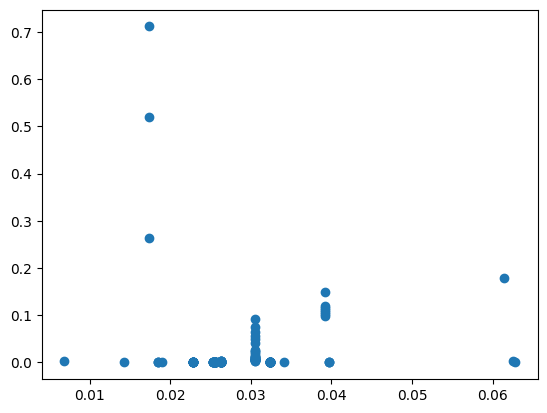

2022-08-21 05:35:09.642 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:35:09.643 | INFO     | __main__:apply_mean:92 - [0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.03242152166065853, 0.032421

2022-08-21 05:35:09.655 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.656 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.658 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:09.669 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.670 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.673 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 

2022-08-21 05:35:09.680 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:09.687 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.689 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641605, 0.03425842925386763, 0.0312783774049948

2022-08-21 05:35:09.696 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:09.698 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.699 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.00026921990496

2022-08-21 05:35:09.711 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:09.714 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.716 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641

2022-08-21 05:35:09.723 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.725 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.727 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0

2022-08-21 05:35:09.739 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.757 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.760 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656,

2022-08-21 05:35:09.769 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:09.771 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.773 | INFO     | __main__:stabilize_block:65 - at end of iteration 6, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.00026921990496416

2022-08-21 05:35:09.784 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.786 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.788 | INFO     | __main__:eval_direction_expand:42 - merging up at index 1 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0

2022-08-21 05:35:09.794 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:09.796 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.799 | INFO     | __main__:stabilize_block:65 - at end of iteration 9, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656,

2022-08-21 05:35:09.806 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.808 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.810 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 

2022-08-21 05:35:09.822 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.824 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.827 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656

2022-08-21 05:35:09.840 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:09.842 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.844 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.00026921990496416

2022-08-21 05:35:09.861 | INFO     | __main__:merge_blocks:28 - merged down
2022-08-21 05:35:09.862 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:09.863 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.00026921990496

2022-08-21 05:35:09.871 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.872 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.875 | INFO     | __main__:stabilize_block:65 - at end of iteration 5, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 

2022-08-21 05:35:09.882 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.885 | INFO     | __main__:eval_direction_expand:38 - currently Falsely down-satisfied
2022-08-21 05:35:09.890 | INFO     | __main__:eval_direction_expand:42 - merging down at index 4 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.0595653680741139

2022-08-21 05:35:09.895 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:09.897 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.899 | INFO     | __main__:eval_direction_expand:42 - merging up at index 3 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0

2022-08-21 05:35:09.905 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.914 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.916 | INFO     | __main__:stabilize_block:65 - at end of iteration 3, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656

2022-08-21 05:35:09.924 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.925 | INFO     | __main__:eval_direction_expand:38 - currently Falsely up-satisfied
2022-08-21 05:35:09.927 | INFO     | __main__:eval_direction_expand:42 - merging up at index 5 of partition [[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 

2022-08-21 05:35:09.932 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': False}
2022-08-21 05:35:09.934 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:09.936 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': False, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656

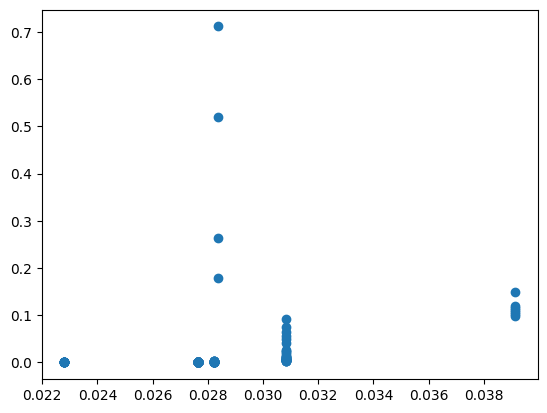

2022-08-21 05:35:10.169 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:35:10.171 | INFO     | __main__:apply_mean:92 - [0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.027634

2022-08-21 05:35:10.180 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:10.184 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:10.187 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 

2022-08-21 05:35:10.193 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:10.195 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:10.197 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 

2022-08-21 05:35:10.212 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:10.213 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:10.216 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 

2022-08-21 05:35:10.228 | INFO     | __main__:stabilize_block:56 - {'up': True, 'down': False}
2022-08-21 05:35:10.230 | INFO     | __main__:eval_direction_expand:38 - currently Truely down-satisfied
2022-08-21 05:35:10.236 | INFO     | __main__:stabilize_block:65 - at end of iteration 1, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 

2022-08-21 05:35:10.244 | INFO     | __main__:merge_blocks:24 - merged up
2022-08-21 05:35:10.251 | INFO     | __main__:stabilize_block:62 - Partition Change!
2022-08-21 05:35:10.254 | INFO     | __main__:stabilize_block:65 - at end of iteration 0, {'up': False, 'down': False} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.05956536807411391, 0.0002692199049641

2022-08-21 05:35:10.263 | INFO     | __main__:stabilize_block:56 - {'up': False, 'down': True}
2022-08-21 05:35:10.264 | INFO     | __main__:eval_direction_expand:38 - currently Truely up-satisfied
2022-08-21 05:35:10.266 | INFO     | __main__:stabilize_block:65 - at end of iteration 2, {'up': True, 'down': True} on partition[[0.010865245614716766, 0.03151234897826899, 0.0060727630243122286, 0.03623820093699294, 0.007014508101818452, 0.055176124075287464, 0.002416822983806892, 0.022140270929448036, 0.013167354814667919, 0.03706984375937384, 0.00992451126700401, 0.028686041738448298, 0.03606722941508261], [0.034168020411559016, 0.014292002974111238, 0.04610732313962737, 0.01213162877219466, 0.0710166909730881, 0.008457113159094823, 0.06594260011835869, 0.0249746601518878, 0.06110131396129659, 0.02881130965700126, 0.025519482431441393, 0.06707578591250764, 0.0068459382640318105, 0.03476015725099606, 0.014903932948968723, 0.034577235681072946, 0.00739848777199481, 0.036746400687460656, 0.

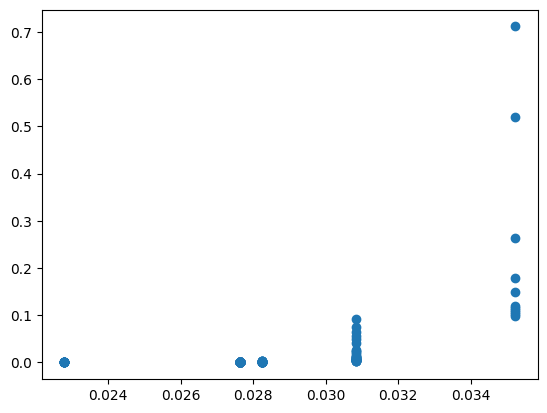

2022-08-21 05:35:10.445 | INFO     | __main__:apply_mean:91 - PRED_DIS_OUT:
2022-08-21 05:35:10.446 | INFO     | __main__:apply_mean:92 - [0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.022796251203017575, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.02763440262806359, 0.027634

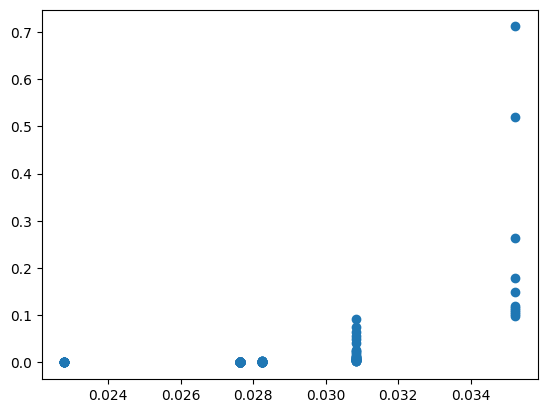

2022-08-21 05:35:10.667 | INFO     | __main__:run_monoreg:120 - FIRST DIFFS:
[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.004838151425046015, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.000604030207791928, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0025947014793575064, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 

Sstar: 0.9395608997009226
Tstar: 1.0
stress: 0.9693094963431044
Sstar: Autograd ArrayBox with value 1.080153090543058
Tstar: 1.0


In [68]:
combi_config = np.zeros_like(generate_starting_configuration(dissimilarities, n_samples) )
for test in range(10):
    start_config = generate_starting_configuration(dissimilarities, n_samples) 
    def get_stress_for_real_true(config):
        return stress(dissimilarities, get_pairwise_distances(config))

    gradiente = elementwise_grad(get_stress_for_real_true)
    # training loop
    old_stress = 1e6
    diff = 1e3 
    alpha = 0.8
    loop_config = deepcopy(start_config)
    start_grad = np.ravel(start_config)
    start_grad /= np.linalg.norm(start_grad)
    old_stress = 1
    iteration = 0
    stress_vec = []
    while diff > 2e0:
        pwds = get_pairwise_distances(loop_config)

        # monotone regression
        mpwds = MonoReg(pred_dis = pwds, true_dis = dissimilarities).run_monoreg()
        # end monotone regression
        iter_stress = stress(dissimilarities, mpwds)
        print(f"stress: {iter_stress}")
        stress_grad = gradiente(loop_config)
        grad_mag = np.linalg.norm(stress_grad)
        af = angle_factor(start_grad,stress_grad)
        good_luck = min(1, iter_stress/old_stress)
        five_iter = 1 if iteration < 5 else min(1, iter_stress/stress_vec[iteration-5])
        alpha = af*good_luck*five_iter
        loop_config += -1.*alpha*stress_grad*(1./grad_mag)
        diff = abs(old_stress - iter_stress)
        old_stress = iter_stress
        stress_vec.append(iter_stress)
        iteration += 1
        start_grad = stress_grad
    combi_config += 0.1*np.nan_to_num(loop_config)
    

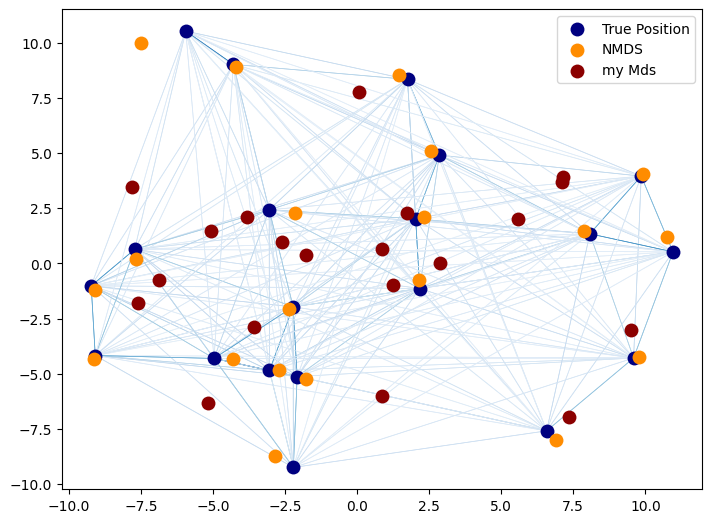

In [69]:
npos *= np.sqrt((X_true**2).sum()) / np.sqrt((npos**2).sum())
combi_config *= np.sqrt((X_true**2).sum()) / np.sqrt((combi_config**2).sum())
# Rotate the data
clf = PCA(n_components=2)
X_true = clf.fit_transform(X_true)


npos = clf.fit_transform(npos)
combi_config = clf.fit_transform(combi_config)

fig = plt.figure(1)
ax = plt.axes([0.0, 0.0, 1.0, 1.0])

s = 100
plt.scatter(X_true[:, 0], X_true[:, 1], color="navy", s=s, lw=0, label="True Position")
plt.scatter(npos[:, 0], npos[:, 1], color="darkorange", s=s, lw=0, label="NMDS")
plt.scatter(combi_config[:, 0], combi_config[:, 1], color="darkred", s=s, lw=0, label="my Mds")
plt.legend(scatterpoints=1, loc="best", shadow=False)

similarities = similarities.max() / (similarities + EPSILON) * 100
np.fill_diagonal(similarities, 0)
# Plot the edges
start_idx, end_idx = np.where(npos)
# a sequence of (*line0*, *line1*, *line2*), where::
#            linen = (x0, y0), (x1, y1), ... (xm, ym)
segments = [
    [X_true[i, :], X_true[j, :]] for i in range(len(npos)) for j in range(len(npos))
]
values = np.abs(similarities)
lc = LineCollection(
    segments, zorder=0, cmap=plt.cm.Blues, norm=plt.Normalize(0, values.max())
)
lc.set_array(similarities.flatten())
lc.set_linewidths(np.full(len(segments), 0.5))
ax.add_collection(lc)

plt.show()

In [70]:
combi_config

array([[-5.16073995e+00, -6.34538304e+00],
       [ 8.64900920e-01,  6.44651208e-01],
       [-1.78306230e+00,  3.61343276e-01],
       [ 9.48735073e+00, -3.01494517e+00],
       [ 1.24927019e+00, -9.58104200e-01],
       [ 7.09953747e+00,  3.67561713e+00],
       [ 8.59739286e-01, -6.00007518e+00],
       [-6.87633337e+00, -7.38787370e-01],
       [ 1.73012953e+00,  2.29076641e+00],
       [-2.60615652e+00,  9.61779788e-01],
       [-7.81354040e+00,  3.47331798e+00],
       [ 7.14748930e+00,  3.92134392e+00],
       [-3.80569760e+00,  2.12345762e+00],
       [-3.59171104e+00, -2.88174120e+00],
       [ 4.83743394e-02,  7.77962292e+00],
       [ 5.59253117e+00,  2.00520788e+00],
       [ 2.88640011e+00,  2.88795998e-03],
       [-7.60897605e+00, -1.81238215e+00],
       [ 7.35531770e+00, -6.97769665e+00],
       [-5.07482351e+00,  1.48911888e+00]])